# Fit Gaussian process and linear fit on PWV time sequence and Fetch Spectra 

- author Sylvie Dagoret-Campagne
- affiliation : IJCLab
- creation date 2024-11-13 :
- last update 2024-11-14 : TODO save spectra in hdf5
- Kernel @usdf **w_2024_41*
- Office emac : mamba_py311
- Home emac : base (conda)
- laptop : conda_py310
- MUST RUN AT USDF

**Goal** : Show correlation holo /Merra

In [1]:
from platform import python_version
print(python_version())

3.11.9


In [2]:
import warnings
warnings.resetwarnings()
warnings.simplefilter('ignore')

In [3]:
from platform import python_version
print(python_version())

3.11.9


In [4]:
import os

#### Create output directory for figures and data

In [5]:
# where are stored the figures
pathfigs = "figsHoloFITLinearandGPPWVandFetchNightSpectra"
if not os.path.exists(pathfigs):
    os.makedirs(pathfigs) 
figtype = ".png"

In [6]:
pathdata = "dataHoloFITLinearandGPPWVandFetchNightSpectra"
if not os.path.exists(pathdata):
    os.makedirs(pathdata) 
datapath_output = os.path.join(pathdata,"pernightspectra") 
if not os.path.exists(datapath_output):
    os.makedirs(datapath_output) 

#### Imports

In [7]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm,SymLogNorm
from matplotlib.patches import Circle,Annulus
from astropy.visualization import ZScaleInterval
props = dict(boxstyle='round', facecolor="white", alpha=0.1)
#props = dict(boxstyle='round')

import matplotlib.colors as colors
import matplotlib.cm as cmx

import matplotlib.ticker                         # here's where the formatter is
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

from matplotlib.gridspec import GridSpec

from astropy.visualization import (MinMaxInterval, SqrtStretch,ZScaleInterval,PercentileInterval,
                                   ImageNormalize,imshow_norm)
from astropy.visualization.stretch import SinhStretch, LinearStretch,AsinhStretch,LogStretch

import numpy as np
from numpy.linalg import inv


from astropy.io import fits
from astropy.wcs import WCS
from astropy import units as u
from astropy import constants as c

from astropy.coordinates.earth import EarthLocation
from datetime import datetime
from pytz import timezone

import scipy
from scipy.optimize import curve_fit,least_squares
from scipy.interpolate import RegularGridInterpolator
from scipy import interpolate
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KDTree, BallTree

import pandas as pd
pd.set_option("display.max_columns", None)
pd.set_option('display.max_rows', 100)

import matplotlib.ticker                         # here's where the formatter is
import os
import re
import pandas as pd
import pickle
from collections import OrderedDict

plt.rcParams["figure.figsize"] = (4,3)
plt.rcParams["axes.labelsize"] = 'xx-large'
plt.rcParams['axes.titlesize'] = 'xx-large'
plt.rcParams['xtick.labelsize']= 'xx-large'
plt.rcParams['ytick.labelsize']= 'xx-large'
plt.rcParams['legend.fontsize']=  12
plt.rcParams['font.size'] = 12

# new color correction model
import pickle

from tqdm import tqdm

In [8]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

In [9]:
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

from astropy.visualization import (MinMaxInterval, SqrtStretch,ZScaleInterval,PercentileInterval,
                                   ImageNormalize,imshow_norm)
from astropy.visualization.stretch import SinhStretch, LinearStretch,AsinhStretch,LogStretch

from astropy.time import Time


In [10]:
# Remove to run faster the notebook
#import ipywidgets as widgets
#%matplotlib widget

In [11]:
from importlib.metadata import version

In [12]:
import warnings
warnings.filterwarnings("ignore")

In [13]:
# wavelength bin colors
#jet = plt.get_cmap('jet')
#cNorm = mpl.colors.Normalize(vmin=0, vmax=NSED)
#scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
#all_colors = scalarMap.to_rgba(np.arange(NSED), alpha=1)

In [14]:
import spectractor
from spectractor.tools import from_lambda_to_colormap, wavelength_to_rgb
from spectractor.simulation.throughput import load_transmission,plot_transmission_simple,TelescopeTransmission
from spectractor import parameters
from spectractor.extractor import dispersers
from spectractor.config import load_config,set_logger
import os,sys,re

In [15]:
import getCalspec.getCalspec as gcal

#### Butler access

- these access may change with time
- check my collections are found

In [16]:
def get_whereclause(expos_id):
    return f"exposure.id = {expos_id} and instrument = \'LATISS\'"

In [17]:
from lsst.summit.utils.utils import checkStackSetup
checkStackSetup()

You are running w_2024_42 of lsst_distrib

Locally setup packages:
-----------------------
atmospec    at /home/d/dagoret/repos/repos_w_2024_41/atmospec
spectractor at /home/d/dagoret/repos/repos_w_2024_41/Spectractor


In [18]:
# Notice before I had to use these lines to access to butler
import lsst.summit.utils.butlerUtils as butlerUtils
butler = butlerUtils.makeDefaultLatissButler(embargo=True)

# Now I have to use these lines
import lsst.daf.butler as dafButler
#repo = "/repo/main"
repo = "/repo/embargo_old"


butler = dafButler.Butler(repo)
registry = butler.registry

for c in sorted(registry.queryCollections()):
    #if "u/jneveu" in c and "auxtel_atmo" in c and "SensorFlat" in c and "FixA1" in c:
    if "u/dagoret" in c and "auxtel_atmo" in c and "SensorFlat" in c and "FixA1" in c:
        print(c)

u/dagoret/auxtel_atmosphere_202209_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_No5SigmaClip
u/dagoret/auxtel_atmosphere_202209_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_No5SigmaClip/20241016T184601Z
u/dagoret/auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_PeekFinder
u/dagoret/auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_PeekFinder/20240924T161119Z


#### Environnement for rubinsimphot
- Configure to access to rubinsimphot
- Note it is important to have the rubinsimphot path in the python path
- check the dm_version repository the newpythonpath 

In [19]:
dm_version="repos_w_2024_41" 
machine_name = os.uname().nodename
print(machine_name)
if 'sdf' in machine_name:
    #machine_name_usdf = 'sdfrome001'
    #machine_name_notebook platform = 'dagoret-nb'
    print("Set environement for USDF")
    newpythonpath = os.path.join(os.getenv("HOME"),f"repos/{dm_version}/rubinsimphot/src")
    sys.path.append(newpythonpath)
    newpythonpath = os.path.join(os.getenv("HOME"),"rubin-user/RubinLSSTPhotometricCorrTuto/notebooks/lib")
    sys.path.append(newpythonpath)   
elif "dagoret-nb" in machine_name:
    print("Set environement for Rubin Platform at  USDF")
    newpythonpath = os.path.join(os.getenv("HOME"),f"repos/{dm_version}/rubinsimphot/src")
    sys.path.append(newpythonpath)
    newpythonpath = os.path.join(os.getenv("HOME"),"rubin-user/RubinLSSTPhotometricCorrTuto/notebooks/lib")
    sys.path.append(newpythonpath)
elif 'mac' in machine_name:
    print("Be sure to run this notebook in conda environnement named conda_py310")
else:
    print("Your current machine name is {machine_name}. Check your python environment")

dagoret-nb
Set environement for Rubin Platform at  USDF


In [20]:
from rubinsimphot.phot_utils import Bandpass, Sed
from rubinsimphot.data.data_sets import  get_data_dir

#README.md        darksky.dat      filter_r.dat     hardware_g.dat   hardware_y.dat   lens3.dat        total_g.dat      total_y.dat
#README_SOURCE.md detector.dat     filter_u.dat     hardware_i.dat   hardware_z.dat   m1.dat           total_i.dat      total_z.dat
#atmos_10.dat     filter_g.dat     filter_y.dat     hardware_r.dat   lens1.dat        m2.dat           total_r.dat      version_info
#atmos_std.dat    filter_i.dat     filter_z.dat     hardware_u.dat   lens2.dat        m3.dat           total_u.dat
hardware_filenames = ["hardware_u.dat","hardware_g.dat","hardware_r.dat","hardware_i.dat","hardware_z.dat","hardware_y.dat"] 
filter_filenames = ["filter_u.dat","filter_g.dat","filter_r.dat","filter_i.dat","filter_z.dat","filter_y.dat" ]
total_filenames = ["total_u.dat","total_g.dat","total_r.dat","total_i.dat","total_z.dat","total_y.dat" ]
filter_tagnames = ["u","g","r","i","z","y"]
Filter_tagnames = ["U","G","R","I","Z","Y"]
filtercolor_tagnames = ["u-g","g-r","r-i","i-z","z-y"]
Filtercolor_tagnames = ["U-G","G-R","R-I","I-Y","Z-Y"]
filter_color = ["b","g","r","orange","grey","k"]
NFILT=len(filter_filenames)

WLMIN=300.
WLMAX=1100.
WLBIN=1.
NWLBIN=int((WLMAX-WLMIN)/WLBIN)
WL=np.linspace(WLMIN,WLMAX,NWLBIN)

In [21]:
#FILTERWL: precalculated array containing center, boundaries and width of each filter.
#index 0 : minimum wavelength of filter border
#index 1 : minimum wavelength of filter border
#index 2 : center wavelength of filter
#index 3 : filter width


FILTERWL = np.array([[ 324.03003755,  402.12765957,  363.59690349,   78.09762203],
       [ 392.11514393,  561.32665832,  473.54069923,  169.21151439],
       [ 542.3028786 ,  700.50062578,  619.49926767,  158.19774718],
       [ 681.47684606,  827.65957447,  752.01084117,  146.18272841],
       [ 808.63579474,  932.79098874,  868.488419  ,  124.15519399],
       [ 914.76846058, 1044.93116395,  969.10570859,  130.16270338]])

FILTERWL_auxtel = np.array([[ 352.7 ,  395.9 ,  374.3 ,   43.2 ],
                     [ 387.6 ,  566.2 ,  476.9 ,  178.6 ],
                     [ 541.4 ,  715.5 ,  628.45,  174.1 ],
                     [ 673.3 ,  870.9 ,  772.1 ,  197.6 ],
                     [ 805.6 , 1090.7 ,  948.15,  285.1 ]])


F0 = 3631.0 # Jy 1, Jy = 10^{-23} erg.cm^{-2}.s^{-1}.Hz^{-1}
Jy_to_ergcmm2sm1hzm1 = 1e-23
DT = 30.0 # seconds
gel = 1.1
#hP = 6.62607015E-34 # J⋅Hz−1
hP = 6.626196E-27
A  = np.pi*642.3**2 # cm2  Reff=6.423 m
A_auxtel  = 9636.0 # cm2

#ZPT_cont =  2.5 \log_{10} \left(\frac{F_0 A \Delta T}{g_{el} h} \right)
ZPTconst = 2.5*np.log10(F0*Jy_to_ergcmm2sm1hzm1*A*DT/gel/hP)

In [22]:
fdir = get_data_dir()
bandpass_inst = {}
path_rubin_sim_throughput = os.path.join(fdir, 'throughputs', 'baseline')
for index,filename in enumerate(hardware_filenames):
    fullfilename=os.path.join(path_rubin_sim_throughput,filename)
    arr= np.loadtxt(fullfilename)
    # interpolate  filter transmission
    ff = interpolate.interp1d(x=arr[:,0], y=arr[:,1],fill_value="extrapolate")
    fname = filter_tagnames[index]
    bandpass_inst[fname] = Bandpass(wavelen=WL,sb=ff(WL))

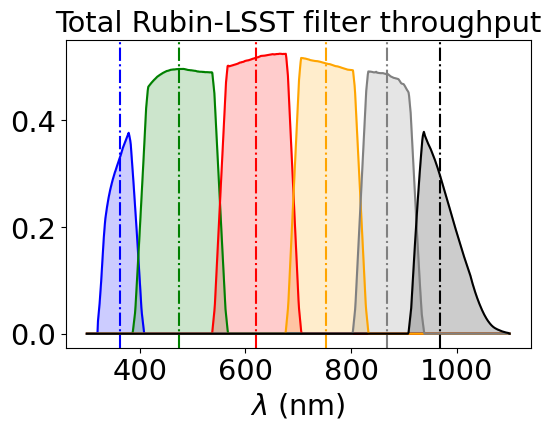

In [23]:
%matplotlib inline
fig, axs = plt.subplots(1,1,figsize=(6,4))
# loop on filter
for index,f in enumerate(filter_tagnames):
    
    axs.plot(WL,bandpass_inst[f].sb,color=filter_color[index]) 
    axs.fill_between(WL,bandpass_inst[f].sb,color=filter_color[index],alpha=0.2) 
    axs.axvline(FILTERWL[index,2],color=filter_color[index],linestyle="-.")
    
axs.set_xlabel("$\\lambda$ (nm)")
axs.set_title("Total Rubin-LSST filter throughput")
plt.show()

## Access to throughput

- Please check the curve used for the Throughput
- The version of throughput is defined in ~/rubin-user/holo_atmo_2024-10-16 /processStar.yaml
as 'instrumentTransmissionOverride': 'multispectra_holo4_003_HD142331_20230802_348-594_HD146233_AuxTel_v3
.1.0_doSensorFlat_FreePressure_BG40ReScaled1.09_throughput.txt'

In [24]:
spectractor_path = spectractor.__path__[0]
spectractor_path

'/home/d/dagoret/repos/repos_w_2024_41/Spectractor/lib/python/spectractor'

In [25]:
#config_path = "~/repos/repos_w_2023_44/Spectractor/config/auxtel.ini"
config_path = f"/home/d/dagoret/repos/repos_w_2024_41/Spectractor/config/auxtel.ini"
config_fullpath = os.path.join(spectractor.__path__[0],"../config/auxtel.ini")
throughput_path = "/home/d/dagoret/repos/repos_w_2024_41/Spectractor/spectractor/simulation/AuxTelThroughput"
#throughput_filename="multispectra_holo4_003_HD142331_20230802_AuxTel_doGainsPTC_v3.0.3_throughput.txt"
throughput_filename="multispectra_holo4_003_HD142331_20230802_348-594_HD146233_AuxTel_v3.1.0_doSensorFlat_FreePressure_BG40ReScaled1.09_throughput.txt"

In [26]:
throughput_fullfilename = os.path.join(throughput_path,throughput_filename)

In [27]:
#tel_lambdas, tel_thr, tel_errthr = load_transmission(throughput_fullfilename) 
tel_arr = np.loadtxt(throughput_fullfilename)
tel_lambdas = tel_arr[:,0] 
tel_thr = tel_arr[:,1]
tel_errthr = tel_arr[:,2]

class Telescope():
    tel_lambdas = tel_lambdas 
    tel_thr  = tel_thr 
    tel_errthr = tel_errthr 
    func = interpolate.interp1d(tel_lambdas, tel_thr, kind='linear',  bounds_error=False, fill_value=0, 
                                    assume_sorted=False)
    @classmethod
    def transmission(cls, wls):
        return  cls.func(wls)         

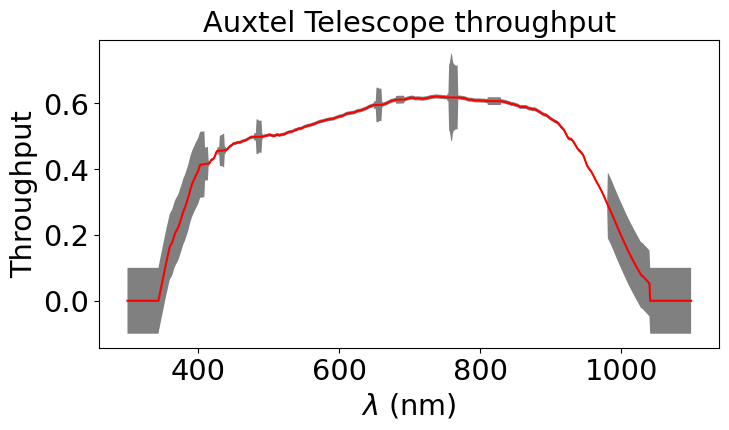

In [28]:
%matplotlib inline
fig = plt.figure(figsize=(8,4))
ax = fig.add_subplot()
ax.plot(tel_lambdas,tel_thr,'r-') 
ax.fill_between(tel_lambdas, y1=tel_thr-tel_errthr , y2=tel_thr+tel_errthr,facecolor="grey")
ax.set_xlabel("$\lambda$ (nm)")
ax.set_ylabel("Throughput")
ax.set_title("Auxtel Telescope throughput")
plt.show()

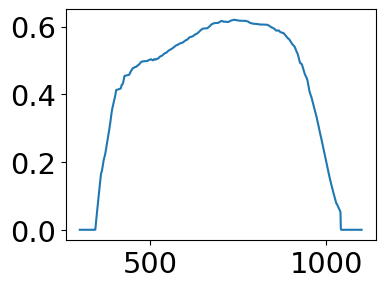

In [29]:
plt.plot(WL,Telescope.transmission(WL))

#### Hologram throughput

In [30]:
holo_fullfilename  ="/home/d/dagoret/repos/repos_w_2024_41/Spectractor/spectractor/extractor/dispersers/holo4_003/transmission.txt"

In [31]:
holo_arr = np.loadtxt(holo_fullfilename)
holo_lambdas = holo_arr[:,0] 
holo_thr = holo_arr[:,1]
holo_errthr = holo_arr[:,2]

class Disp():
    holo_lambdas = holo_lambdas 
    holo_thr  = holo_thr 
    holo_errthr = holo_errthr 
    func = interpolate.interp1d(holo_lambdas, holo_thr, kind='linear',  bounds_error=False, fill_value=0, 
                                    assume_sorted=False)
    @classmethod
    def transmission(cls, wls):
        return  cls.func(wls)       

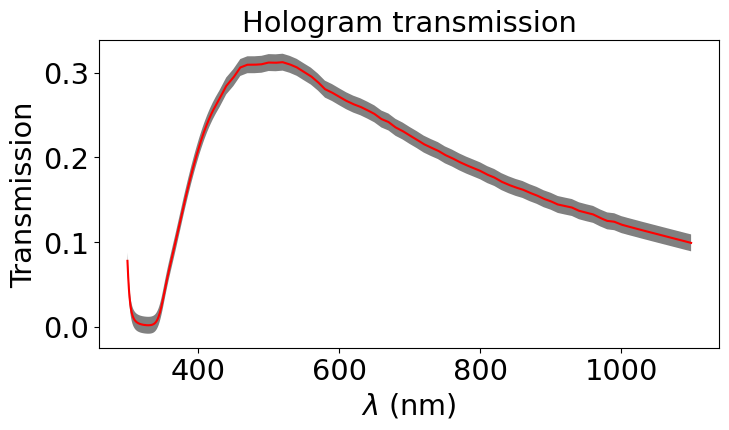

In [32]:
%matplotlib inline
fig = plt.figure(figsize=(8,4))
ax = fig.add_subplot()
ax.plot(holo_lambdas,holo_thr,'r-') 
ax.fill_between(holo_lambdas, y1=holo_thr-holo_errthr , y2=holo_thr+holo_errthr,facecolor="grey")
ax.set_xlabel("$\lambda$ (nm)")
ax.set_ylabel("Transmission")
ax.set_title("Hologram transmission")
plt.show()

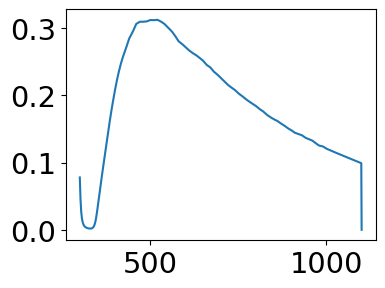

In [33]:
plt.plot(WL,Disp.transmission(WL))

### Load my stuff

In [34]:
sys.path.append("../lib")
from libauxtelspectra import *
from libanaspectra import *
from config_spectractor import *

In [35]:
#config_fullpath = os.path.join(spectractor.__path__[0],"../config/auxtel.ini")
#load_config_local(config_fullpath)

In [36]:
parameters.OBS_NAME

'CTIO'

## Access to spectra

- But here we don't want to get all spectra. We fetch the sepected ones later

In [37]:
# my run 2024-09-24
#my_collection = ['u/dagoret/auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_PeekFinder/20240924T161119Z']
# my run 2024-10-16
my_collection = ['u/dagoret/auxtel_atmosphere_202209_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_No5SigmaClip/20241016T184601Z']
datasetRefs = registry.queryDatasets(datasetType='spectractorSpectrum', collections=my_collection, where= "instrument='LATISS'")

In [38]:
where = "instrument='LATISS'" 
records = list(butler.registry.queryDimensionRecords('visit', datasets='spectractorSpectrum', where=where,  collections=my_collection))

refs = list(set(butler.registry.queryDatasets('spectractorSpectrum',  where=where,  collections=my_collection)))
# records = list(butler.registry.queryDimensionRecords('visit', datasets='raw', where=where))

In [39]:
print(len(records))
records[0]

5919


visit.RecordClass(instrument='LATISS', id=2022091300503, day_obs=20220913, physical_filter='empty~holo4_003', name='AT_O_20220913_000503', seq_num=503, exposure_time=30.0, target_name='HD200654', observation_reason='object', science_program='unknown', azimuth=222.04026230120508, zenith_angle=31.590856702721794, region=ConvexPolygon([UnitVector3d(0.4704028666915763, -0.4420975525313821, -0.7637217405928085), UnitVector3d(0.4655677734747327, -0.4444175875762878, -0.7653363026504443), UnitVector3d(0.4645087643707424, -0.43998511078864555, -0.7685341307366053), UnitVector3d(0.4693438578132238, -0.43766507630944174, -0.7669195682156317)]), timespan=Timespan(begin=astropy.time.Time(2459837.0, -0.31119125010445603, scale='tai', format='jd'), end=astropy.time.Time(2459837.0, -0.3108412615740741, scale='tai', format='jd')))

In [40]:
def GetListOfSpectra(butler,list_of_visits,the_collection):
    """
    Retrieve a list of Spectra:
    Parameters:
      butler : the butler
      list_of_visits : the list of visit id
      collection : the collection

    Returns:
     all_params_spectrum = []
     all_params_spectrogram = []
     all_visitid = []
     all_headers = []
     all_spectra = []
    """


    # container contining the data
    all_params_spectrum = []
    all_params_spectrogram = []
    all_visitid = []
    all_headers = []
    all_spectra = []

    # loop on visits
    for idx, visitid in enumerate(list_of_visits):
        try:         
            spec =  butler.get('spectractorSpectrum', visit=visitid, collections=the_collection, detector=0, instrument='LATISS')
            all_headers.append(spec.header)
            all_spectra.append(spec)
            p = butler.get('spectrumLibradtranFitParameters', visit=visitid, collections=the_collection, detector=0, instrument='LATISS')
            all_params_spectrum.append(p)
            p = butler.get('spectrogramLibradtranFitParameters', visit=visitid, collections=the_collection, detector=0, instrument='LATISS')
            all_params_spectrogram.append(p)
            all_visitid.append(visitid)
        #except ValueError:
        except Exception as inst:
            except_type = type(inst)
            except_args = inst.args
            print("catch exception ", inst, "type =",except_type, "args = ",except_args) 
            print("\t >>>>> Skip visitid ", visitid)
            continue
    return all_visitid, all_headers, all_params_spectrum , all_params_spectrogram, all_spectra
    


## Functions

In [41]:
np.__version__

'1.26.4'

In [42]:
pd.__version__

'1.5.3'

In [43]:
def convertNumToDatestr(num):
    year = num//10_000
    month= (num-year*10_000)//100
    day = (num-year*10_000-month*100)

    year_str = str(year).zfill(4)
    month_str = str(month).zfill(2)
    day_str = str(day).zfill(2)
    
    datestr = f"{year_str}-{month_str}-{day_str}"
    return pd.to_datetime(datestr)

## Configuration

In [44]:
observing_location = EarthLocation.of_site('Rubin Observatory')
tz = timezone('America/Santiago')

### Spectro Hologram data

In [45]:
FLAG_WITHCOLLIMATOR = False
DATE_WITHCOLLIMATOR = 20230930
datetime_WITHCOLLIMATOR = convertNumToDatestr(DATE_WITHCOLLIMATOR)
datetime_WITHCOLLIMATOR = pd.to_datetime("2023-09-30 00:00:00.0+0000")
datetime_WITHCOLLIMATOR

Timestamp('2023-09-30 00:00:00+0000', tz='UTC')

In [46]:
version_results = "v5"
legendtag = {"v1" : "old v3.1.0",
            "v2" : "v3.1.0-PWV<10mm",
            "v3" : "v3.1.0-PWV<15mm",
            "v4" : "Auxtel holo v3.1.0",
            "v5" : "Auxtel holo v3.1.0 09/22 - 10/24"}

In [47]:
atmfilenamesdict = {"v1" : "data/spectro/auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_testWithMaskedEdges_newBoundaries_newPolysRescaled_newFitBounds_adjustA1_lockedOrder2_removeThroughputTails_2.npy",
                    "v2" : "auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_PeekFinder.npy",
                    "v3" : "u_dagoret_auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_PeekFinder_20240924T161119Z.npy",
                    "v4" : "u_dagoret_auxtel_atmosphere_202301_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_PeekFinder_20240924T161119Z_spectrfullextend.npy",
                    "v5" : "u_dagoret_auxtel_atmosphere_202209_v3.1.0_doSensorFlat_rebin2_lockedOrder2_FixA1_FixA2_FitAngstrom_WithGaia_freePressure_newThroughput6_BG40Scaled1.09_AtmoFitPressureA2_SpecErr_No5SigmaClip_20241016T184601Z_spectrfullextended.npy"}

In [48]:
atmfilename = atmfilenamesdict[version_results]
tag = legendtag[version_results] 

## Initialisation

### Read the file

In [49]:
specdata = np.load(atmfilename,allow_pickle=True)

In [50]:
df_spec = pd.DataFrame(specdata)

In [51]:
list(df_spec.columns)

['DATE-OBS',
 'id',
 'BITPIX',
 'NAXIS',
 'NAXIS1',
 'NAXIS2',
 'EXTEND',
 'TARGET',
 'REDSHIFT',
 'GRATING',
 'ROTANGLE',
 'D2CCD',
 'LSHIFT',
 'DOMEAZ',
 'AZ',
 'EL',
 'RA',
 'MJD',
 'WINDSPD',
 'WINDDIR',
 'PARANGLE',
 'TARGETX',
 'TARGETY',
 'LBDA_REF',
 'PSF_REG',
 'TRACE_R',
 'MEANFWHM',
 'PIXSHIFT',
 'CHI2_FIT',
 'A2_FIT',
 'AM_FIT',
 'VERSION',
 'CCD_REBIN',
 'CONFIG',
 'EXPTIME',
 'AIRMASS',
 'DEC',
 'HA',
 'OUTTEMP',
 'OUTPRESS',
 'OUTHUM',
 'FILTER',
 'CAM_ROT',
 'S_X0',
 'S_Y0',
 'S_XMIN',
 'S_XMAX',
 'S_YMIN',
 'S_YMAX',
 'S_NX',
 'S_NY',
 'S_DEG',
 'S_SAT',
 'S_ORDER',
 'A1_x',
 'A1_err_x',
 'A2_x',
 'A2_err_x',
 'A3',
 'A3_err',
 'VAOD_x',
 'VAOD_err_x',
 'angstrom_exp_x',
 'angstrom_exp_err_x',
 'ozone [db]_x',
 'ozone [db]_err_x',
 'PWV [mm]_x',
 'PWV [mm]_err_x',
 'B_x',
 'B_err_x',
 'A_star',
 'A_star_err',
 'D_CCD [mm]_x',
 'D_CCD [mm]_err_x',
 'shift_x [pix]',
 'shift_x [pix]_err',
 'shift_y [pix]',
 'shift_y [pix]_err',
 'angle [deg]',
 'angle [deg]_err',
 'P [hPa

### Remove spectra with red filter

In [52]:
df_spec['FILTER'].unique()

array(['empty', 'OG550_65mm_1'], dtype=object)

In [53]:
FLAG_REMOVE_FILTERS = True
if FLAG_REMOVE_FILTERS:
    df_spec=df_spec[df_spec["FILTER"] == 'empty']
    df_spec.reset_index(inplace=True)  

### Define if a target is faint or bright

In [54]:
def IsFaint(row):
    List_Of_Faint_targets = ['Feige110','HD074000','HD115169','HD031128','HD200654','HD167060','HD009051','HD142331','HD160617','HD111980']
    List_Of_faint_selected = List_Of_Faint_targets[:10]
    if row["TARGET"] in List_Of_faint_selected:
        return True
    else:
        return False

In [55]:
df_spec["isFaint"] = df_spec.apply(IsFaint,axis=1)

### Compute NightObs

In [56]:
df_spec["nightObs"] = df_spec.apply(lambda x: x['id']//100_000, axis=1)

In [57]:
if FLAG_WITHCOLLIMATOR:
    df_spec = df_spec[df_spec["nightObs"]> DATE_WITHCOLLIMATOR]

## Apply Quality selection

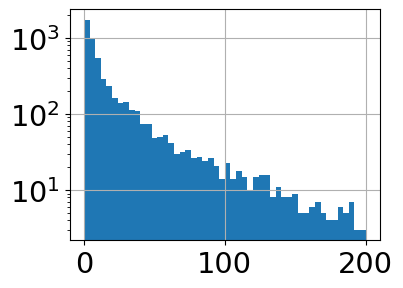

In [58]:
fig,ax = plt.subplots(1,1)
df_spec["CHI2_FIT"].hist(bins=50,ax=ax,range=(0,200))
ax.set_yscale("log")

### Add the Time in pd.datetime

#### UTC

In [59]:
df_spec["Time"] = pd.to_datetime(df_spec["DATE-OBS"])

In [60]:
DT = pd.Timedelta(minutes=7*24*60)
TMIN  = df_spec["Time"].min()-DT
TMAX  = df_spec["Time"].max()+DT

### Compute relative time to Mid-night

In [61]:
def GetTimeToMidNight(row):
    observing_time = Time(row['DATE-OBS'], scale='utc', location=observing_location)

    # time at the location , either before or after midnight
    local_time =  observing_time.to_datetime(timezone=tz)

    # take time independent  of any location now
    local_time_new = datetime(local_time.year,local_time.month,local_time.day,local_time.hour,local_time.minute,local_time.second)
    local_time_midnight = datetime(local_time_new.year,local_time_new.month,local_time_new.day)
    dt_hour = (local_time_new -local_time_midnight).seconds/3600.

    # we took the previous night mid-night , must subtract 24H
    if dt_hour > 12.:
        dt_hour_new = (dt_hour - 24.)
    else:
        dt_hour_new = dt_hour
        
    return dt_hour_new

In [62]:
df_spec["dt_midnight"] = df_spec.apply(GetTimeToMidNight,axis=1)

Text(0.5, 1.0, 'Observation time')

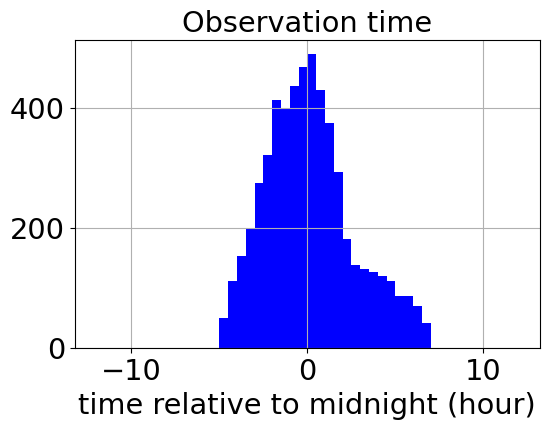

In [63]:
fig,ax = plt.subplots(1,1,figsize=(6,4))
df_spec["dt_midnight"].hist(bins=48,range=(-12,12),ax=ax,facecolor="blue") 
ax.set_xlabel("time relative to midnight (hour)")
ax.set_title("Observation time")

### Compute Date relative to January

In [64]:
def GetDateToMidJanuary(row):
    observing_time = Time(row['DATE-OBS'], scale='utc', location=observing_location)

    # time at the location , either before or after midnight
    local_time =  observing_time.to_datetime(timezone=tz)

    # take time independent  of any location now
    local_time_new = datetime(2024,local_time.month,local_time.day,local_time.hour,local_time.minute,local_time.second)
           
    return pd.to_datetime(local_time_new)

In [65]:
#df_spec["Time_january"] = df_spec.apply(GetDateToMidJanuary,axis=1)

In [66]:
def GetDateToMidJanuaryAndYear(row):
    observing_time = Time(row['DATE-OBS'], scale='utc', location=observing_location)

    # time at the location , either before or after midnight
    local_time =  observing_time.to_datetime(timezone=tz)

    # take time independent  of any location now
    local_time_new = datetime(2024,local_time.month,local_time.day,local_time.hour,local_time.minute,local_time.second)
           
    return pd.to_datetime(local_time_new),local_time.year 

In [67]:
df_spec[["Time_january","Year"]] = df_spec.apply(GetDateToMidJanuaryAndYear,axis=1,result_type="expand")

In [68]:
df_spec[["Time_january","Year"]]

,Time_january,Year
0,2024-09-14 01:31:31,2022
1,2024-09-14 01:32:14,2022
2,2024-09-14 01:35:44,2022
3,2024-09-14 01:36:27,2022
4,2024-09-14 01:40:23,2022
...,...,...
5498,2024-10-16 05:33:33,2024
5499,2024-10-16 05:41:00,2024
5500,2024-10-16 05:42:13,2024
5501,2024-10-16 05:49:45,2024


## Compute night boundaries

In [69]:
def GetNightBoundariesDict(df_spec):
    """
    input:
      df_spec the dataframe for spectroscopy summary results
    output:
      the dict of night boudaries
    """
    
    Dt = pd.Timedelta(minutes=30)
    d = {}
    list_of_nightobs = df_spec["nightObs"].unique()
    for nightobs in list_of_nightobs:
        sel_flag = df_spec["nightObs"]== nightobs
        df_night = df_spec[sel_flag]
        tmin = df_night["Time"].min()-Dt
        tmax = df_night["Time"].max()+Dt
        d[nightobs] = (tmin,tmax)
    return d

In [70]:
dn = GetNightBoundariesDict(df_spec)

## Plot all data

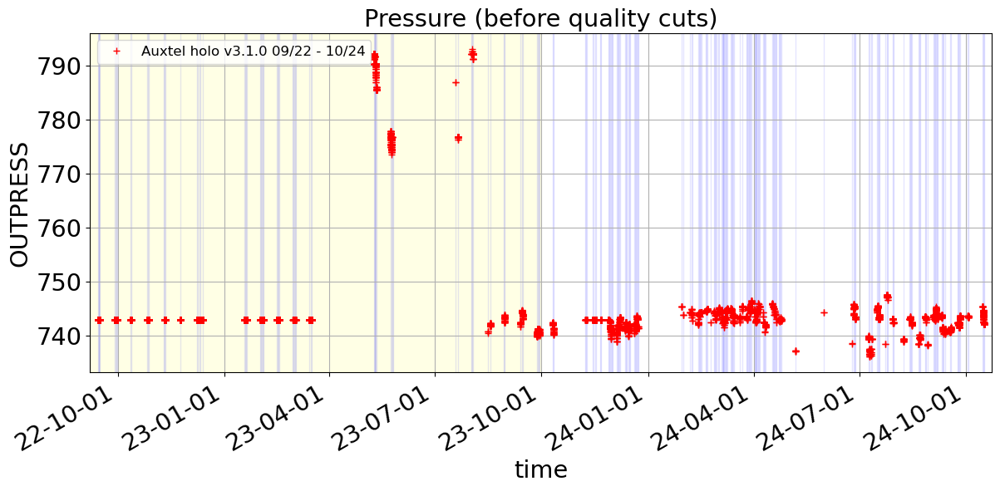

In [71]:
from matplotlib.dates import DateFormatter
#date_form = DateFormatter("%y-%m-%dT%H:%M")
date_form = DateFormatter("%y-%m-%d")
fig,axs = plt.subplots(1,1,figsize=(14,6))
ax  = axs
leg=ax.get_legend()

ax.set_xlim(TMIN,TMAX) 
#df_m.plot(x="Time",y="PShP",ax=ax,marker=".",c="b",lw=0.5,label="Merra2",ms=1,legend=leg)   
df_spec.plot(x="Time",y="OUTPRESS",ax=ax,marker='+',c="r",lw=0.0,grid=True,label=tag,legend=leg)
ax.set_ylabel("OUTPRESS")

ax.set_xlabel("time")
ax.xaxis.set_major_formatter(date_form)
ax.set_title("Pressure (before quality cuts)")
ax.legend()

if not FLAG_WITHCOLLIMATOR:
    ax.axvspan(TMIN,datetime_WITHCOLLIMATOR, color='yellow', alpha=0.1)


for key, tt in dn.items():
    ax.axvspan(tt[0],tt[1], color='blue', alpha=0.1)


#ax.set_ylim(0.,15.)

figname =f"{pathfigs}/pressure_allpoints_allnights_nocuts"+figtype
plt.savefig(figname)
plt.show()


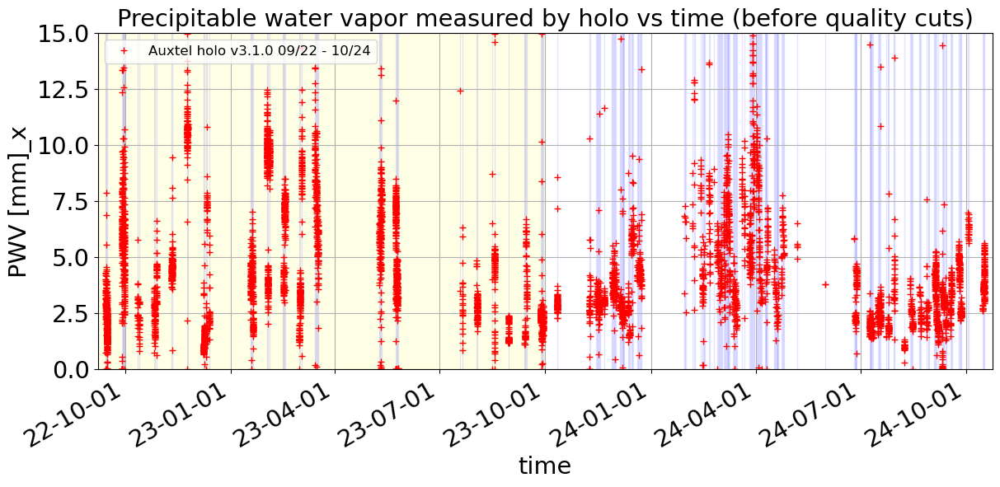

In [72]:
from matplotlib.dates import DateFormatter
#date_form = DateFormatter("%y-%m-%dT%H:%M")
date_form = DateFormatter("%y-%m-%d")
fig,axs = plt.subplots(1,1,figsize=(14,6))
ax  = axs
leg=ax.get_legend()

ax.set_xlim(TMIN,TMAX)   
df_spec.plot(x="Time",y="PWV [mm]_x",ax=ax,marker='+',c="r",lw=0.0,grid=True,label=tag,legend=leg)
ax.set_ylabel("PWV [mm]_x")

ax.set_xlabel("time")
ax.xaxis.set_major_formatter(date_form)
ax.set_title("Precipitable water vapor measured by holo vs time (before quality cuts)")
ax.legend()

if not FLAG_WITHCOLLIMATOR:
    ax.axvspan(TMIN,datetime_WITHCOLLIMATOR, color='yellow', alpha=0.1)


for key, tt in dn.items():
    ax.axvspan(tt[0],tt[1], color='blue', alpha=0.1)


ax.set_ylim(0.,15.)

figname =f"{pathfigs}/pwv_allpoints_allnights_nocuts"+figtype
plt.savefig(figname)
plt.show()


## Apply Quality selection cuts

In [73]:
def getSelectionCut(df_spec, chi2max=20., pwvmin=0.1, pwvmax = 14.9,ozmin=100.,ozmax=600.):
    cut =  (df_spec["CHI2_FIT"]<chi2max) & (df_spec["PWV [mm]_x"] > pwvmin) & (df_spec["PWV [mm]_x"] < pwvmax) & (df_spec["D2CCD"]>186.5) &  (df_spec["D2CCD"]<187.3) & \
    (df_spec['EXPTIME'] > 20.) & (df_spec["PWV [mm]_y"] > pwvmin) & (df_spec["PWV [mm]_y"] < pwvmax) & \
    (df_spec["ozone [db]_y"] > ozmin) & (df_spec["ozone [db]_y"] < ozmax) 
    return cut

In [74]:
def getSelectionCutNoPolar(df_spec, chi2max=20., pwvmin=0.1, pwvmax = 14.9,ozmin=100.,ozmax=600.):
    cut =  (df_spec["CHI2_FIT"]<chi2max) & (df_spec["PWV [mm]_x"] > pwvmin) & (df_spec["PWV [mm]_x"] < pwvmax) & (df_spec["D2CCD"]>186.5) &  (df_spec["D2CCD"]<187.3) & \
    (df_spec['EXPTIME'] > 20.) & (df_spec["PWV [mm]_y"] > pwvmin) & (df_spec["PWV [mm]_y"] < pwvmax) & \
    (df_spec["ozone [db]_y"] > ozmin) & (df_spec["ozone [db]_y"] < ozmax) & (df_spec["TARGET"] != "HD185975")
    return cut

In [75]:
def getSelectionCutWithPolar(df_spec, chi2max=20., pwvmin=0.1, pwvmax = 14.9,ozmin=100.,ozmax=600.):
    cut =  (df_spec["CHI2_FIT"]<chi2max) & (df_spec["PWV [mm]_x"] > pwvmin) & (df_spec["PWV [mm]_x"] < pwvmax) & (df_spec["D2CCD"]>186.5) &  (df_spec["D2CCD"]<187.3) & \
    (df_spec['EXPTIME'] > 20.) & (df_spec["PWV [mm]_y"] > pwvmin) & (df_spec["PWV [mm]_y"] < pwvmax) & \
    (df_spec["ozone [db]_y"] > ozmin) & (df_spec["ozone [db]_y"] < ozmax) & (df_spec["TARGET"] == "HD185975")
    return cut

In [76]:
cut = getSelectionCut(df_spec) 
cut_nopolar = getSelectionCutNoPolar(df_spec) 
cut_nopolar_bright = getSelectionCutNoPolar(df_spec) & (~df_spec["isFaint"])
cut_nopolar_faint = getSelectionCutNoPolar(df_spec) & (df_spec["isFaint"])
cut_wthpolar = getSelectionCutWithPolar(df_spec)

In [77]:
df_spec_sel = df_spec[cut]
df_spec_np = df_spec[cut_nopolar] 
df_spec_np_b = df_spec[cut_nopolar_bright]
df_spec_np_f = df_spec[cut_nopolar_faint]
df_spec_wp = df_spec[cut_wthpolar]

In [78]:
print("Total number of Spectra          : ",len(df_spec))
print("Number of selected Spectra       : ",len(df_spec_sel))
print("Number of selected Polars        : ",len(df_spec_wp))
print("Number of selected Non-Polars    : ",len(df_spec_np))
print("Number of selected Non-Polars Bright : ",len(df_spec_np_b))
print("Number of selected Non-Polars Faint  : ",len(df_spec_np_f))

Total number of Spectra          :  5503
Number of selected Spectra       :  1968
Number of selected Polars        :  852
Number of selected Non-Polars    :  1116
Number of selected Non-Polars Bright :  769
Number of selected Non-Polars Faint  :  347


In [79]:
df_spec_sel.reset_index(drop=True,inplace=True)
df_spec_np.reset_index(drop=True,inplace=True)
df_spec_wp.reset_index(drop=True,inplace=True) 
df_spec_np_b.reset_index(drop=True,inplace=True)
df_spec_np_f.reset_index(drop=True,inplace=True)

In [80]:
#List_Of_Faint_targets = ['Feige110','HD074000','HD115169','HD031128','HD200654','HD167060','HD009051','HD142331','HD160617','HD111980']
print("Polar            :",len(df_spec_wp["TARGET"].unique()),"\t", df_spec_wp["TARGET"].unique()) 
print("Non Polar        :",len(df_spec_np["TARGET"].unique()),"\t" ,df_spec_np["TARGET"].unique())
print("Non Polar Bright :",len(df_spec_np_b["TARGET"].unique()),"\t" ,df_spec_np_b["TARGET"].unique())
print("Non Polar Faint  :",len(df_spec_np_f["TARGET"].unique()),"\t",df_spec_np_f["TARGET"].unique())

Polar            : 1 	 ['HD185975']
Non Polar        : 20 	 ['HD200654' 'HD167060' 'HD205905' 'HD2811' 'HD14943' 'HD42525' 'HD37962'
 'HD009051' 'HD031128' 'HD38949' 'HD38666' 'HD60753' 'HD074000' 'HD111980'
 'HD115169' 'HD 38949' 'HD 42525' 'HD142331' 'HD146233' 'HD160617']
Non Polar Bright : 11 	 ['HD205905' 'HD2811' 'HD14943' 'HD42525' 'HD37962' 'HD38949' 'HD38666'
 'HD60753' 'HD 38949' 'HD 42525' 'HD146233']
Non Polar Faint  : 9 	 ['HD200654' 'HD167060' 'HD009051' 'HD031128' 'HD074000' 'HD111980'
 'HD115169' 'HD142331' 'HD160617']


## Recompute night boundaries

In [81]:
#dn = GetNightBoundariesDict(df_spec_sel)

## Plot all data

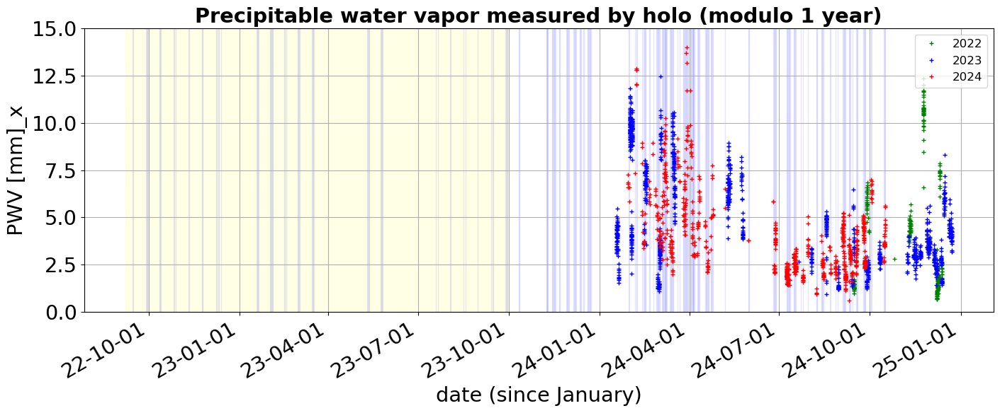

In [82]:
from matplotlib.dates import DateFormatter
date_form = DateFormatter("%y-%m-%d")

fig,axs = plt.subplots(1,1,figsize=(14,6),layout='constrained')
ax  = axs
leg=ax.get_legend()

#ax.set_xlim(TMIN,TMAX) 
#df_m.plot(x="Time",y="TQV",ax=ax,marker=".",c="b",lw=0.5,ms=1,label="Merra2",legend=leg)     
    
df_spec_sel[df_spec_sel.Year==2022].plot(x="Time_january",y="PWV [mm]_x",ax=ax,marker='+',c="g",lw=0.0,grid=True,label="2022",legend=leg,ms=5,alpha=1.)
df_spec_sel[df_spec_sel.Year==2023].plot(x="Time_january",y="PWV [mm]_x",ax=ax,marker='+',c="b",lw=0.0,grid=True,label="2023",legend=leg,ms=5,alpha=1.)
df_spec_sel[df_spec_sel.Year==2024].plot(x="Time_january",y="PWV [mm]_x",ax=ax,marker='+',c="r",lw=0.0,grid=True,label="2024",legend=leg,ms=5,alpha=1.)
#df_spec_np_f.plot(x="Time",y="PWV [mm]_x",ax=ax,marker='o',c="grey",lw=0.0,grid=True,label="faint,no polar",legend=leg,ms=5,alpha=0.2)
#df_spec_np_b.plot(x="Time_january",y="PWV [mm]_x",ax=ax,marker='o',c="r",lw=0.0,grid=True,label="bright,no polar",legend=leg,ms=5,alpha=0.2)
#df_spec_np.plot(x="Time",y="PWV [mm]_x",ax=ax,marker='o',c="m",lw=0.0,grid=True,label="no polar",legend=leg,ms=5,alpha=0.5)
#df_spec_wp.plot(x="Time_january",y="PWV [mm]_x",ax=ax,marker='o',c="g",lw=0.0,grid=True,label="with polar",legend=leg,ms=5,alpha=0.5)
ax.set_ylabel("PWV [mm]_x")
ax.set_xlabel("date (since January)")
ax.xaxis.set_major_formatter(date_form)
ax.set_title("Precipitable water vapor measured by holo (modulo 1 year)",fontweight="bold")
ax.legend()

for key, tt in dn.items():
    ax.axvspan(tt[0],tt[1], color='blue', alpha=0.1)

ax.axvspan(TMIN,datetime_WITHCOLLIMATOR, color='yellow', alpha=0.1)

plt.tight_layout()
 
ax.set_ylim(0.,15.)
#ax.set_xlim(TMIN,TMAX)

figname =f"{pathfigs}/pwvholoM2_allpoints_allnights_modulo1year"+figtype
plt.savefig(figname)
plt.show()

## Plot night by night

In [83]:
def ComputeRepeatability(df):
    """
    Compute Repeatability of PWV for Spectrogram and and Spectrum
    
    """
    N = len(df)
    dfout = pd.DataFrame(index=df.index,columns = ["nightObs","dt","dt_rep","dPWVx_rep","dPWVy_rep","targflag_rep","Npoints"])
    dfout["targflag_rep"].astype(bool)
    #dfout["Npoints"].astype(int)
    
    target_old = "No"
    time_old = 0.
    pwvx_old = 0.
    pwvy_old = 0.
    
    for index in range(N):
        
        nightObs =  df.iloc[index]["nightObs"]
        
        if index ==0:
            dt0 = df.iloc[index]["dt"]
            dfout.iloc[index] = [ nightObs,dt0, 0., 0., 0., False,N]
        else:
            target_new = df.iloc[index]["TARGET"]
            time_new = df.iloc[index]["dt"]
            pwvx_new = df.iloc[index]["PWV [mm]_x"]
            pwvy_new = df.iloc[index]["PWV [mm]_y"]
            
            flag_target = (target_new == target_old)
            dPWVx_rep = pwvx_new - pwvx_old
            dPWVy_rep = pwvy_new - pwvy_old
            dt_rep = (time_new-time_old)*3600. # in seconds
            
            dfout.iloc[index] = [ nightObs,time_new, dt_rep, dPWVx_rep, dPWVy_rep, flag_target,N]
        
        target_old = df.iloc[index]["TARGET"]
        time_old = df.iloc[index]["dt"]
        pwvx_old = df.iloc[index]["PWV [mm]_x"]
        pwvy_old = df.iloc[index]["PWV [mm]_y"]
        
    return dfout

In [84]:
all_selected_nights = df_spec_sel["nightObs"].unique()

## Fits gaussien et lineaires

In [85]:
def funclineres(params, x, y, yerr):
    # Return residual = fit-observed
    return (y-params[0] -params[1]*x)/yerr
def funcline(params,x):
    return params[0] + params[1]*x

In [86]:
def MakeLineFit(df_night_pwv_curve):
    """
    """

    x = df_night_pwv_curve["dt_midnight"].values
    y = df_night_pwv_curve["PWV [mm]_x"].values
    yerr = df_night_pwv_curve["PWV [mm]_err_x"].values
    n = len(y)
        
    #popt, pcov = optimize.curve_fit(f, x, y, [1,-4])
    fit_res = least_squares(funclineres,[5.,0],args = (x,y,yerr))
    popt = fit_res.x 
    npar = len(popt)
    J = fit_res.jac
    cov = np.linalg.inv(J.T.dot(J))
    chi2dof = ((funclineres(popt,x,y,yerr))**2).sum()/(n-npar)
    cov *= chi2dof
    perr = np.sqrt(np.diagonal(cov)) 
    
    xfit = np.linspace(x.min()*0.99,x.max()*1.05)
    yfit = funcline(popt,xfit)
        
    slope = popt[1]
    slope_err = perr[1]

    return x,y,yerr,n,chi2dof,xfit,yfit,slope,slope_err

In [87]:
#
# Gaussian Process regression
# https://scikit-learn.org/1.5/auto_examples/gaussian_process/plot_gpr_noisy_targets.html
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF

In [88]:
def MakeGaussianProcessFit(df_night_pwv_curve):
    """
    """

    x_train = df_night_pwv_curve["dt_midnight"].values
    xmin =  x_train.min()
    xmax = x_train.max()
    xfit = np.linspace(xmin,xmax,50)
    X_fit =xfit.reshape(-1,1)
    X_train = x_train.reshape(-1, 1)
    
    y_train = df_night_pwv_curve["PWV [mm]_x"].values
    y_mean = y_train.mean()
    yerr_train = df_night_pwv_curve["PWV [mm]_err_x"].values
    n = len(y_train)

    noise_std= 0.5
    
    kernel = 1. * RBF(length_scale=5.0, length_scale_bounds=(0.5, 12.))
    gaussian_process = GaussianProcessRegressor(kernel=kernel,alpha=noise_std**2 ,n_restarts_optimizer=9)
    
    gaussian_process.fit(X_train, y_train)

    mean_prediction, std_prediction = gaussian_process.predict(X_fit, return_std=True)
    return xfit, mean_prediction, std_prediction, gaussian_process

In [89]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
# https://scikit-learn.org/1.5/auto_examples/linear_model/plot_ard.html
from sklearn.linear_model import ARDRegression,BayesianRidge

In [90]:
POLY_DEGREE_MAX = 10

In [91]:
def MakeLinearModelFit(df_night_pwv_curve,degree_max = POLY_DEGREE_MAX ):
    """
    https://scikit-learn.org/1.5/auto_examples/linear_model/plot_ard.html
    ARDRegression and BayesianRidge
    """

    x_train = df_night_pwv_curve["dt_midnight"].values
    xmin =  x_train.min()
    xmax = x_train.max()
    xfit = np.linspace(xmin,xmax,50)
    X_fit =xfit.reshape(-1,1)
    X_train = x_train.reshape(-1, 1)
    
    y_train = df_night_pwv_curve["PWV [mm]_x"].values
    y_mean = y_train.mean()
    yerr_train = df_night_pwv_curve["PWV [mm]_err_x"].values
    n = len(y_train)

    ard_poly = make_pipeline(
    PolynomialFeatures(degree=degree_max, include_bias=False),StandardScaler(),ARDRegression(),).fit(X_train, y_train)
    
    brr_poly = make_pipeline(
    PolynomialFeatures(degree=degree_max, include_bias=False),StandardScaler(),BayesianRidge(),).fit(X_train, y_train)

    y_ard, y_ard_std = ard_poly.predict(X_fit, return_std=True)
    y_brr, y_brr_std = brr_poly.predict(X_fit, return_std=True)

    y_ard_pred = ard_poly.predict(X_train,return_std=False)
    resy = y_train - y_ard_pred
    
    return xfit,y_ard, y_ard_std, y_brr, y_brr_std, resy, y_mean

In [92]:
# SKIP. those figures here
# Container of images that all goes in a pdf
all_figs_to_pdf = []

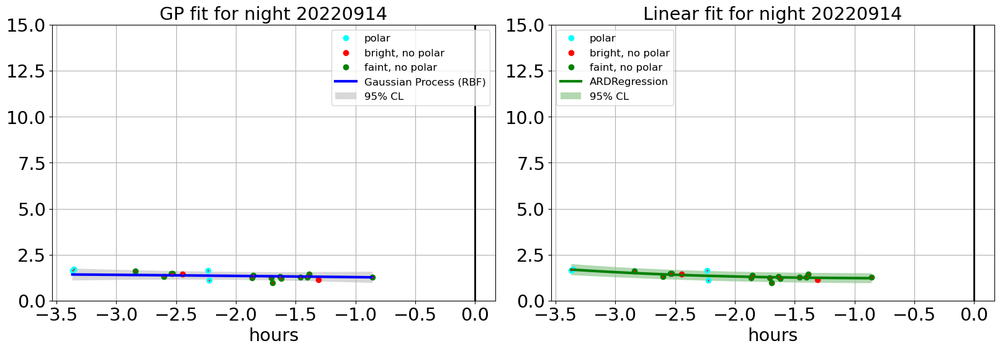

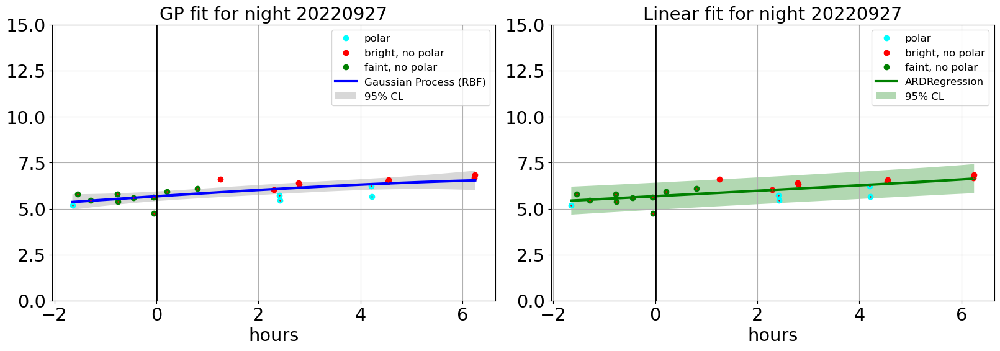

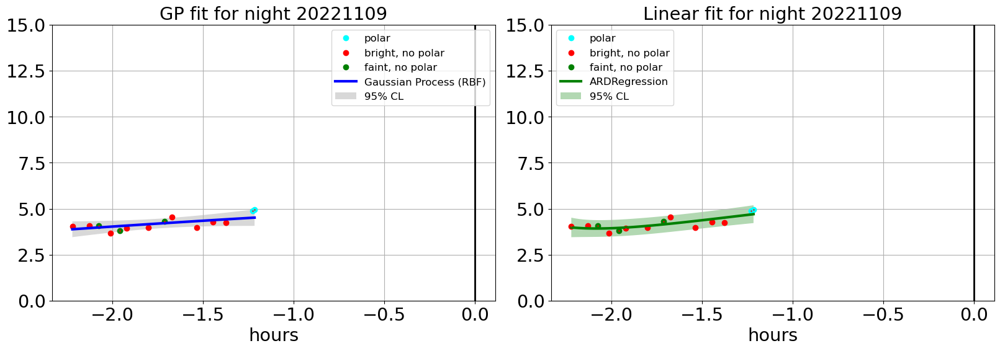

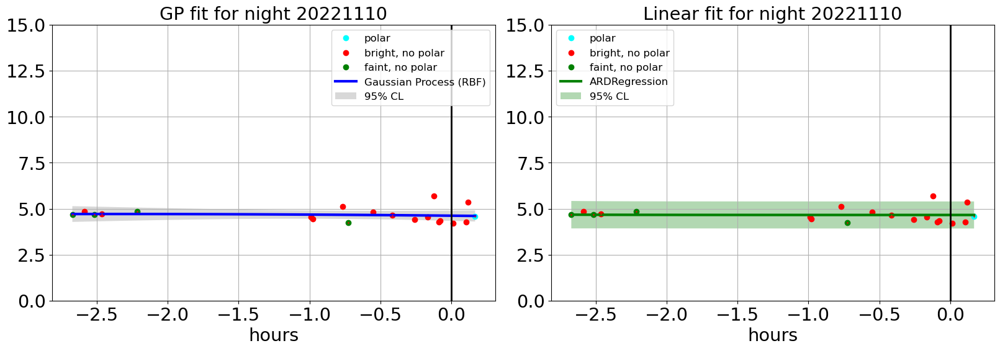

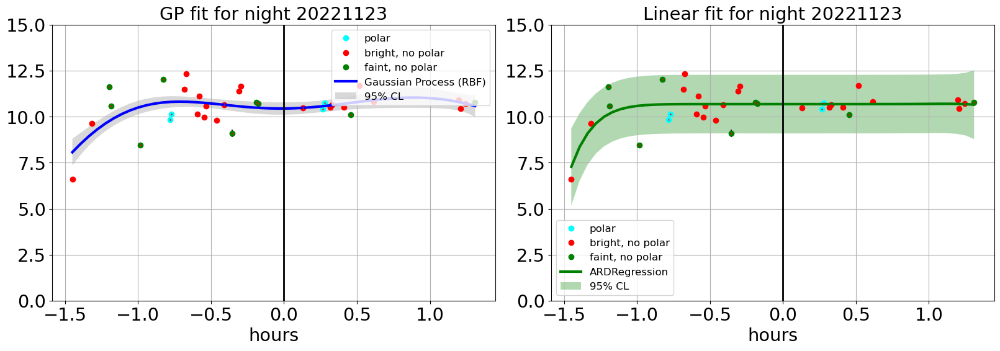

...

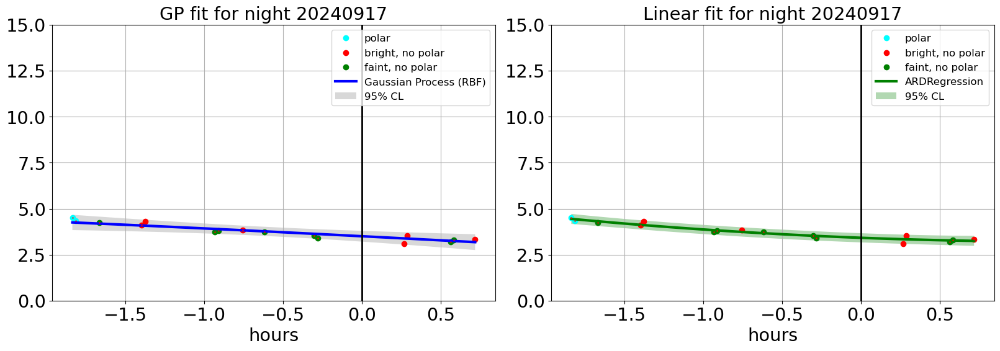

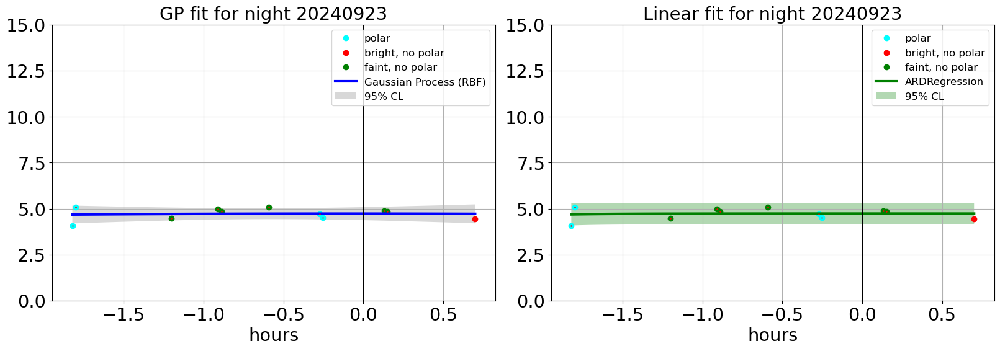

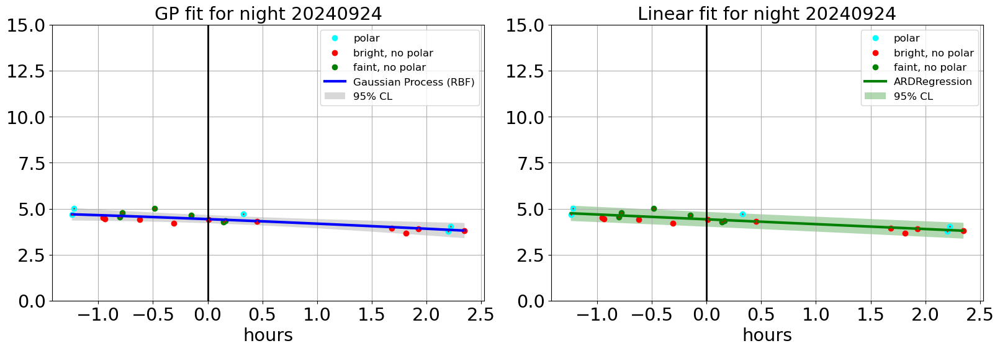

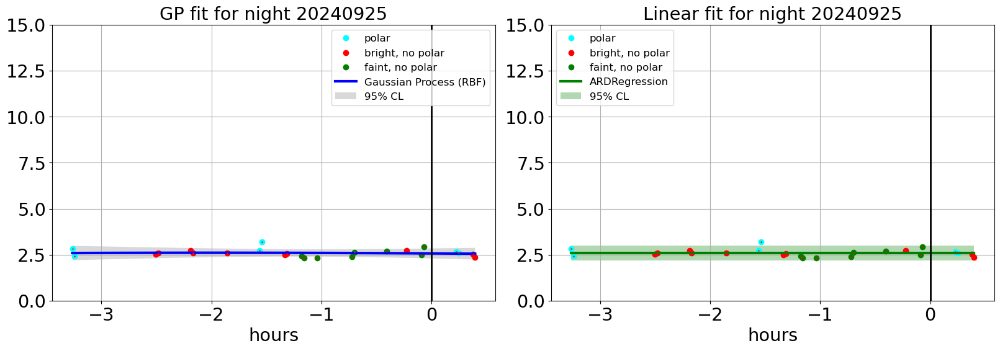

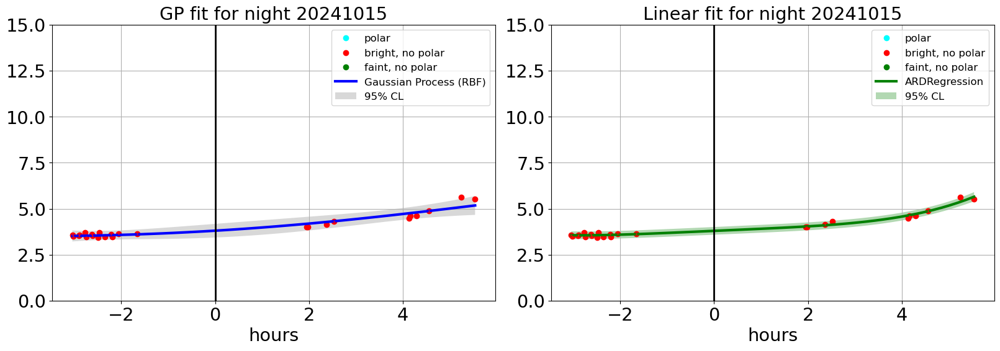

In [93]:
all_dateObs_sel = {}

# loop on nights
for night in all_selected_nights:
    #select the night
    # Choose the kind of observation
    df_spec_night = df_spec_sel[df_spec_sel["nightObs"] == night]
    df_spec_night_wp = df_spec_wp[df_spec_wp["nightObs"] == night]
    df_spec_night_np = df_spec_np[df_spec_np["nightObs"] == night]
    df_spec_night_np_f = df_spec_np_f[df_spec_np_f["nightObs"] == night]
    df_spec_night_np_b = df_spec_np_b[df_spec_np_b["nightObs"] == night]
    
    #select the variables
    df_night_pwv_curve = df_spec_night[["Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET"]]
    df_night_pwv_curve_wp = df_spec_night_wp[["Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET"]]
    df_night_pwv_curve_np_b = df_spec_night_np_b[["Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET"]]
    df_night_pwv_curve_np_f = df_spec_night_np_f[["Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET"]]
    df_night_pwv_curve_np = df_spec_night_np[["Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET"]]

    tmin = df_night_pwv_curve["Time"].min()
    tmax = df_night_pwv_curve["Time"].max()

    list_of_targets = df_night_pwv_curve["TARGET"].unique()
    str_list_of_targets = "\n".join(list_of_targets)
     
    # convert in hours
    #df_night_pwv_curve["dt"] = (pd.to_datetime(df_night_pwv_curve["Time"]) - tmin).dt.total_seconds()/3600.   
    #df_night_pwv_curve["dt"] = df_night_pwv_curve.apply(lambda row : (pd.to_datetime(row["Time"])-tmin).seconds,axis=1)
    df_night_pwv_curve.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_wp["dt"] = (df_night_pwv_curve_wp["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_wp.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np["dt"] = (df_night_pwv_curve_np["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np_f["dt"] = (df_night_pwv_curve_np_f["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np_f.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np_b["dt"] = (df_night_pwv_curve_np_b["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np_b.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)
    
    # extract statistics on pwv
    stat = df_night_pwv_curve[["PWV [mm]_x"]].describe()
    date_form = DateFormatter("%y-%m-%dT%H:%M")
    #date_form = DateFormatter("%y-%m-%dT%H")
    count = int(stat.loc["count"].values[0])
    mean = stat.loc["mean"].values[0]
    median = stat.loc["50%"].values[0]
    std = stat.loc["std"].values[0]
    textstr = "\n".join((f"count : {count}",
                     f"mean : {mean:.1f} mm",
                     f"median : {median:.1f} mm",
                     f"std : {std:.1f} mm",
                    ))


    N= len(df_night_pwv_curve)

    if N>10:
        # does the fit
        
        #x,y,yerr,n,chi2dof,xfit,yfit,slope,slope_err = MakeLineFit(df_night_pwv_curve)
            
        xfit, mean_prediction, std_prediction, gp = MakeGaussianProcessFit(df_night_pwv_curve)
        xfit2, y_ard, y_ard_std, y_brr, y_brr_std, resy, y_mean = MakeLinearModelFit(df_night_pwv_curve)
        
        #textstr2 = "\n".join((f"d(PWV/dt) : ",
        #             f"slope : {slope:.3f} mm/h",
        #             f"slope err : {slope_err:.3f} mm/h",
        #             f"chi2/ndeg : {chi2dof:.2f}",       
        #            ))

        #textstr3 = "\n".join((f"d(PWV/dt) : ",
        #             f"slope : {slope:.3f} mm/h",
        #             f"slope err : {slope_err:.3f} mm/h",  
        #            ))
    

        #stat.loc["slope","PWV [mm]_x"] = slope 
        #stat.loc["slope_err","PWV [mm]_x"] = slope_err 
        #stat.loc["chi2","PWV [mm]_x"] = chi2dof
        
        # plot
           
        fig = plt.figure(figsize=(16,10),constrained_layout=True)
        gs = GridSpec(2, 2,  width_ratios=[1,1],figure=fig)
    
        ax = fig.add_subplot(gs[0])
        ax2 = fig.add_subplot(gs[1])
        
        leg=ax.get_legend()
        leg2=ax2.get_legend()
      
        
        ################################
        # left figure : Gaussian Process
        ################################
        
        ax.errorbar(x=df_night_pwv_curve.dt_midnight, y=df_night_pwv_curve["PWV [mm]_x"],yerr=df_night_pwv_curve["PWV [mm]_err_x"],fmt="+",color="r",ecolor="k",ms=1)
        df_night_pwv_curve_wp.plot(x="dt_midnight",y="PWV [mm]_x",c="cyan",ax=ax,marker='o',lw=0.0,grid=True,legend=leg2,label="polar",ms=6,alpha=1)
        df_night_pwv_curve_np_b.plot(x="dt_midnight",y="PWV [mm]_x",c="r",ax=ax,marker='o',lw=0.0,grid=True,legend=leg2,label="bright, no polar",ms=6,alpha=1)
        df_night_pwv_curve_np_f.plot(x="dt_midnight",y="PWV [mm]_x",c="g",ax=ax,marker='o',lw=0.0,grid=True,legend=leg2,label="faint, no polar",ms=6,alpha=1)

        # fit result
        ax.plot(xfit, mean_prediction,"b-",lw=3,label="Gaussian Process (RBF)")
        ax.fill_between(xfit,mean_prediction - 1.96 * std_prediction,mean_prediction + 1.96 * std_prediction,alpha=0.3,label=r"95% CL",facecolor='grey')
        
        ax.set_xlabel("hours")
        ax.set_ylim(0.,15.)
        ax.legend(loc="upper right")
        #ax.plot(xfit,yfit,"k-")
        #ax2.text(0.05, 0.95, textstr2, transform=ax2.transAxes, fontsize=14,
        #verticalalignment='top', bbox=props)
        ax.set_title(f"GP fit for night {night}")
        ax.axvline(x=0,color="k",lw=2)


        ############################
        # right figure : linear fits
        ############################
        ax2.errorbar(x=df_night_pwv_curve.dt_midnight, y=df_night_pwv_curve["PWV [mm]_x"],yerr=df_night_pwv_curve["PWV [mm]_err_x"],fmt="+",color="r",ecolor="k",ms=1)
        df_night_pwv_curve_wp.plot(x="dt_midnight",y="PWV [mm]_x",c="cyan",ax=ax2,marker='o',lw=0.0,grid=True,legend=leg2,label="polar",ms=6,alpha=1)
        df_night_pwv_curve_np_b.plot(x="dt_midnight",y="PWV [mm]_x",c="r",ax=ax2,marker='o',lw=0.0,grid=True,legend=leg2,label="bright, no polar",ms=6,alpha=1)
        df_night_pwv_curve_np_f.plot(x="dt_midnight",y="PWV [mm]_x",c="g",ax=ax2,marker='o',lw=0.0,grid=True,legend=leg2,label="faint, no polar",ms=6,alpha=1)


        ax2.plot(xfit2, y_ard,"g-",lw=3,label="ARDRegression")
        ax2.fill_between(xfit2, y_ard - 1.96 * y_ard_std,y_ard + 1.96 * y_ard_std,alpha=0.3,label=r"95% CL",facecolor='green')

        #ax2.plot(xfit2, y_brr,"r-",label="BayesianRidge")
        #ax2.fill_between(xfit2, y_brr - 1.96 * y_brr_std,y_brr + 1.96 * y_brr_std,alpha=0.5,label=r"95% CL",facecolor='red')

        
        ax2.set_title(f"Linear fit for night {night}")
        ax2.set_xlabel("hours")
        ax2.set_ylim(0.,15.)
        ax2.legend()
        ax2.axvline(x=0,color="k",lw=2)
        
        #fig.tight_layout()
        #plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)

        all_figs_to_pdf.append(fig) 

        figname =f"{pathfigs}/gp_ard_pwv_per_night_{night}"+figtype
        plt.savefig(figname)
        plt.show()

        # add statistics
        all_dateObs_sel[night] = stat
        

## Plot night by night on single plot

### Re-Start container for figures here 

In [94]:
# Container of images that all goes in a pdf
all_figs_to_pdf = []
NPOINTSMIN = 10

### Mute Spectractor messages

In [95]:
import logging
spec_logger = logging.getLogger('Spectrum')
spec_logger.setLevel(logging.CRITICAL)

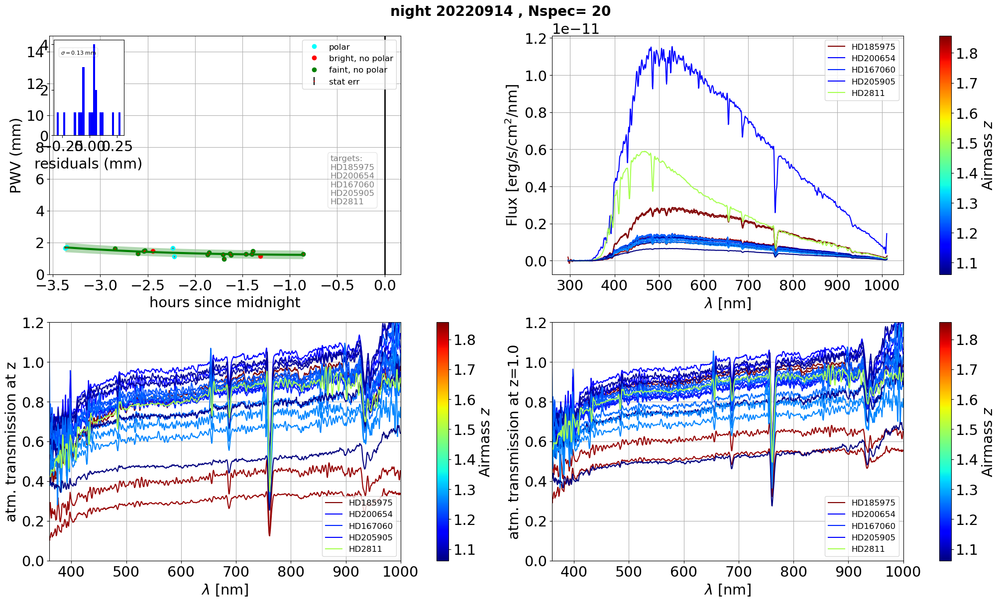

               id                                Time  PWV [mm]_x  \
0   2022091400138 2022-09-14 23:37:54.046004493+00:00    1.635961   
1   2022091400139 2022-09-14 23:38:36.902491264+00:00    1.714795   
2   2022091400187 2022-09-15 00:09:24.318996796+00:00    1.610179   
3   2022091400209 2022-09-15 00:23:49.836993696+00:00    1.292811   
4   2022091400215 2022-09-15 00:27:34.049009842+00:00    1.459810   
5   2022091400216 2022-09-15 00:28:16.954498593+00:00    1.477984   
6   2022091400223 2022-09-15 00:33:09.170499997+00:00    1.451225   
7   2022091400244 2022-09-15 00:45:59.335001632+00:00    1.632584   
8   2022091400245 2022-09-15 00:46:42.165996298+00:00    1.113141   
9   2022091400272 2022-09-15 01:08:03.197000594+00:00    1.232217   
10  2022091400273 2022-09-15 01:08:46.042489996+00:00    1.379632   
11  2022091400286 2022-09-15 01:17:34.226996314+00:00    1.223757   
12  2022091400287 2022-09-15 01:18:17.073002919+00:00    0.972534   
13  2022091400293 2022-09-15 01:21

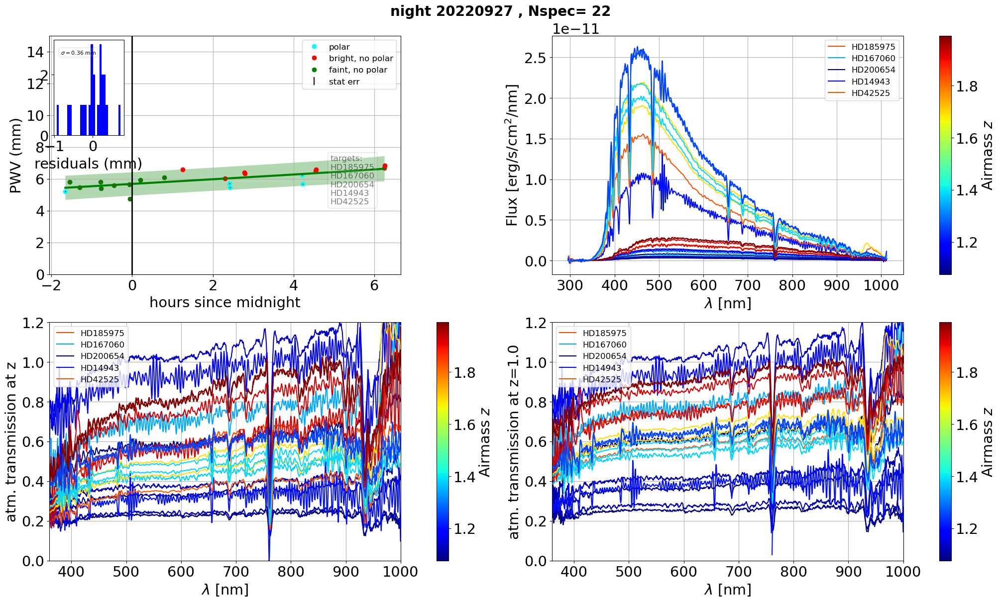

               id                                Time  PWV [mm]_x  \
20  2022092700241 2022-09-28 01:21:06.155002203+00:00    5.198620   
21  2022092700251 2022-09-28 01:27:35.385993881+00:00    5.795320   
22  2022092700274 2022-09-28 01:42:38.092992826+00:00    5.460089   
23  2022092700320 2022-09-28 02:13:40.484993865+00:00    5.791285   
24  2022092700321 2022-09-28 02:14:23.344503950+00:00    5.401163   
25  2022092700333 2022-09-28 02:33:01.810493781+00:00    5.592828   
26  2022092700361 2022-09-28 02:56:31.254001145+00:00    5.637741   
27  2022092700362 2022-09-28 02:57:14.279500530+00:00    4.737985   
28  2022092700384 2022-09-28 03:12:14.321009809+00:00    5.922735   
29  2022092700438 2022-09-28 03:47:59.397000601+00:00    6.097591   
30  2022092700476 2022-09-28 04:15:29.259991833+00:00    6.591984   
31  2022092700535 2022-09-28 05:17:42.818994862+00:00    6.035433   
32  2022092700546 2022-09-28 05:24:46.622992156+00:00    5.718871   
33  2022092700547 2022-09-28 05:25

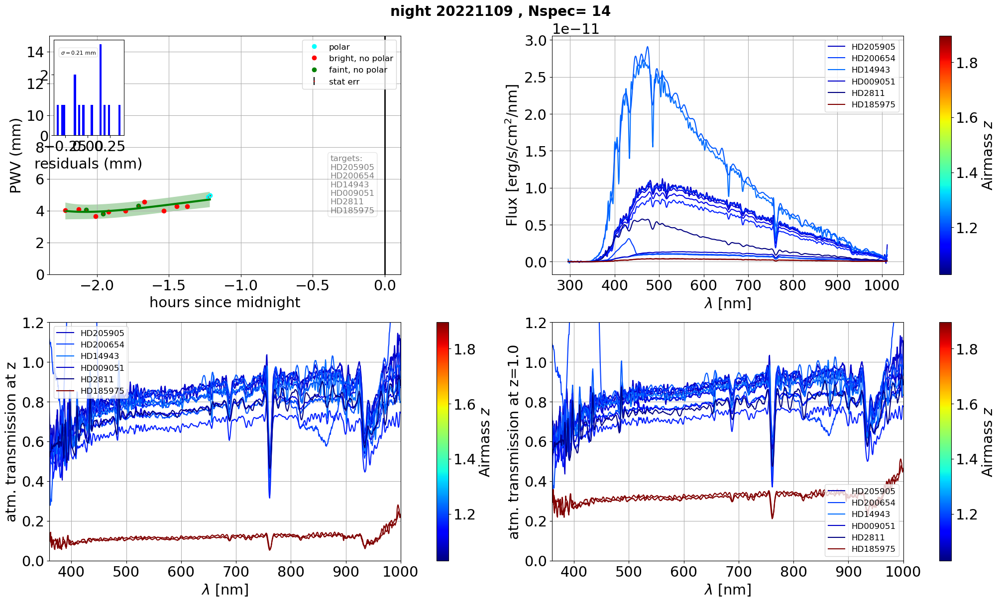

               id                                Time  PWV [mm]_x  \
47  2022110900324 2022-11-10 00:46:50.663991764+00:00    4.027002   
48  2022110900333 2022-11-10 00:52:22.104994117+00:00    4.073678   
49  2022110900338 2022-11-10 00:55:35.421992166+00:00    4.066946   
50  2022110900344 2022-11-10 00:59:21.704491427+00:00    3.652257   
51  2022110900349 2022-11-10 01:02:28.605505985+00:00    3.818302   
52  2022110900353 2022-11-10 01:04:50.981009620+00:00    3.934245   
53  2022110900364 2022-11-10 01:11:59.564507619+00:00    3.978281   
54  2022110900369 2022-11-10 01:17:16.151504984+00:00    4.298186   
55  2022110900373 2022-11-10 01:19:41.716490916+00:00    4.555678   
56  2022110900384 2022-11-10 01:27:54.979995247+00:00    3.987542   
57  2022110900393 2022-11-10 01:33:20.508997149+00:00    4.282282   
58  2022110900399 2022-11-10 01:37:33.852502717+00:00    4.257316   
59  2022110900409 2022-11-10 01:46:22.822501320+00:00    4.876319   
60  2022110900410 2022-11-10 01:47

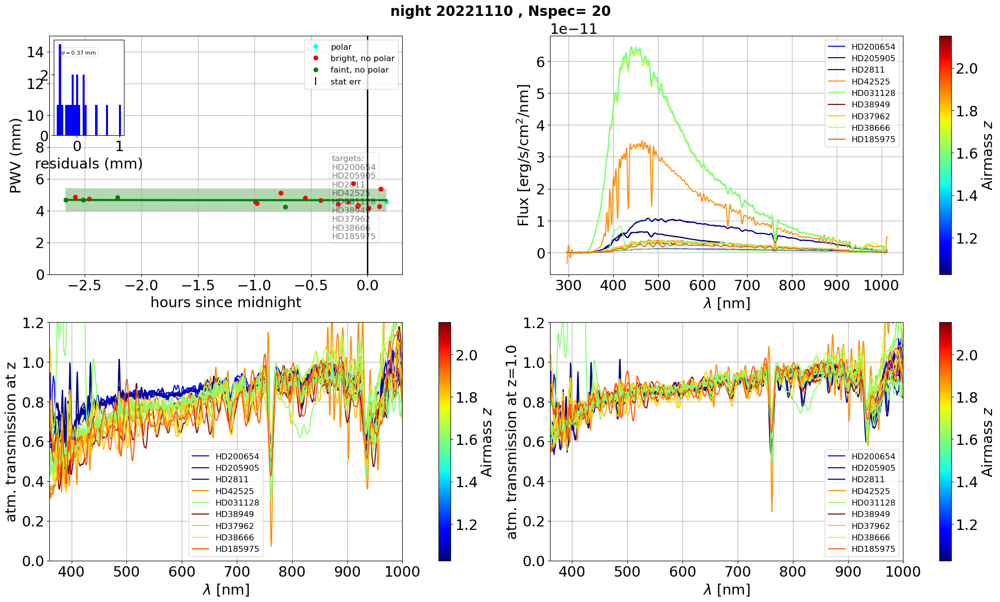

               id                                Time  PWV [mm]_x  \
61  2022111000247 2022-11-11 00:19:43.720506485+00:00    4.673573   
62  2022111000252 2022-11-11 00:24:56.107003866+00:00    4.863603   
63  2022111000258 2022-11-11 00:29:04.383494788+00:00    4.672606   
64  2022111000263 2022-11-11 00:32:16.105000090+00:00    4.727104   
65  2022111000274 2022-11-11 00:47:12.985499628+00:00    4.838765   
66  2022111000285 2022-11-11 02:00:36.914007889+00:00    4.538155   
67  2022111000286 2022-11-11 02:01:19.972506057+00:00    4.444226   
68  2022111000302 2022-11-11 02:13:54.739992305+00:00    5.107332   
69  2022111000306 2022-11-11 02:16:18.851499605+00:00    4.245970   
70  2022111000326 2022-11-11 02:26:58.351999811+00:00    4.808385   
71  2022111000341 2022-11-11 02:35:03.495998001+00:00    4.634174   
72  2022111000357 2022-11-11 02:44:28.342494181+00:00    4.408165   
73  2022111000367 2022-11-11 02:49:55.830991877+00:00    4.556846   
74  2022111000372 2022-11-11 02:52

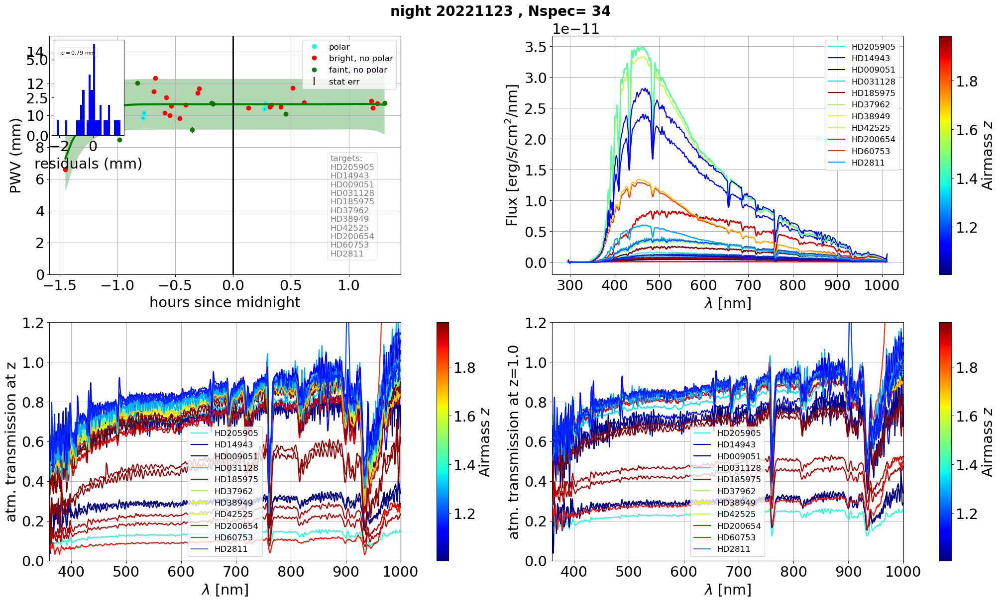

                id                                Time  PWV [mm]_x  \
81   2022112300250 2022-11-24 01:32:59.153499447+00:00    6.596585   
82   2022112300264 2022-11-24 01:41:01.976995882+00:00    9.622895   
83   2022112300274 2022-11-24 01:48:07.811992079+00:00   11.632305   
84   2022112300275 2022-11-24 01:48:50.713006492+00:00   10.581891   
85   2022112300290 2022-11-24 02:01:00.454501973+00:00    8.451168   
86   2022112300301 2022-11-24 02:10:28.803010094+00:00   12.028746   
87   2022112300305 2022-11-24 02:13:04.200002352+00:00    9.842569   
88   2022112300306 2022-11-24 02:13:47.176000041+00:00   10.139182   
89   2022112300315 2022-11-24 02:18:58.053504872+00:00   11.506082   
90   2022112300316 2022-11-24 02:19:41.064506606+00:00   12.343399   
91   2022112300326 2022-11-24 02:24:31.903492539+00:00   10.153190   
92   2022112300327 2022-11-24 02:25:14.859494643+00:00   11.107423   
93   2022112300331 2022-11-24 02:27:11.433490979+00:00    9.984929   
94   2022112300332 2

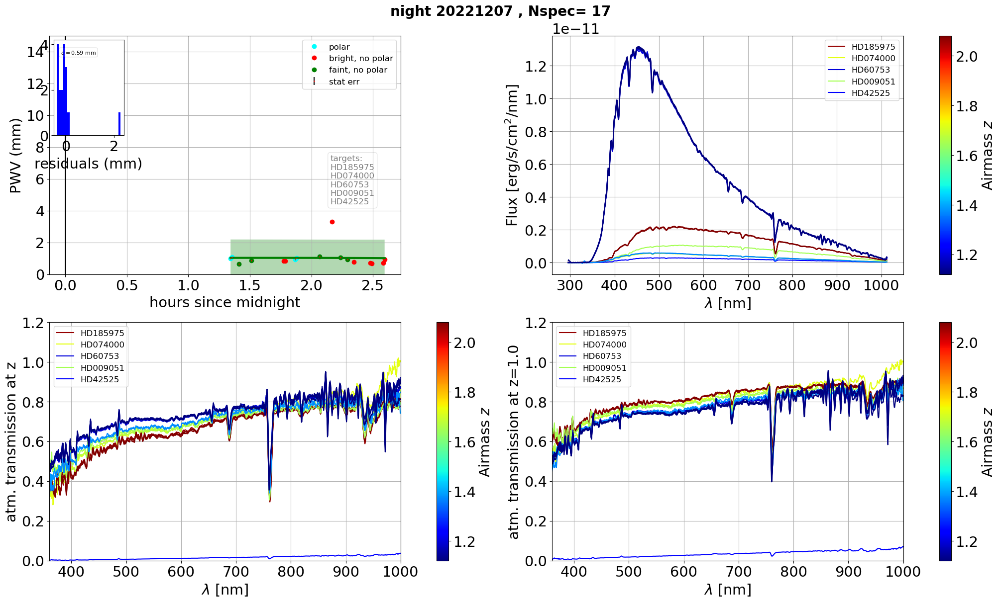

                id                                Time  PWV [mm]_x  \
115  2022120700356 2022-12-08 04:20:35.069502133+00:00    0.979058   
116  2022120700357 2022-12-08 04:21:17.963007803+00:00    1.084981   
117  2022120700362 2022-12-08 04:24:40.095005583+00:00    0.656425   
118  2022120700372 2022-12-08 04:30:42.347990867+00:00    0.860841   
119  2022120700381 2022-12-08 04:46:30.928001068+00:00    0.840654   
120  2022120700382 2022-12-08 04:47:13.757500996+00:00    0.827337   
121  2022120700391 2022-12-08 04:52:12.935507947+00:00    0.941577   
122  2022120700392 2022-12-08 04:52:55.851991152+00:00    1.024306   
123  2022120700407 2022-12-08 05:04:07.404507419+00:00    1.115297   
124  2022120700417 2022-12-08 05:10:07.706000106+00:00    3.304992   
125  2022120700421 2022-12-08 05:14:19.822493793+00:00    1.064844   
126  2022120700427 2022-12-08 05:17:33.561500348+00:00    0.925048   
127  2022120700432 2022-12-08 05:20:41.372005603+00:00    0.756149   
128  2022120700447 2

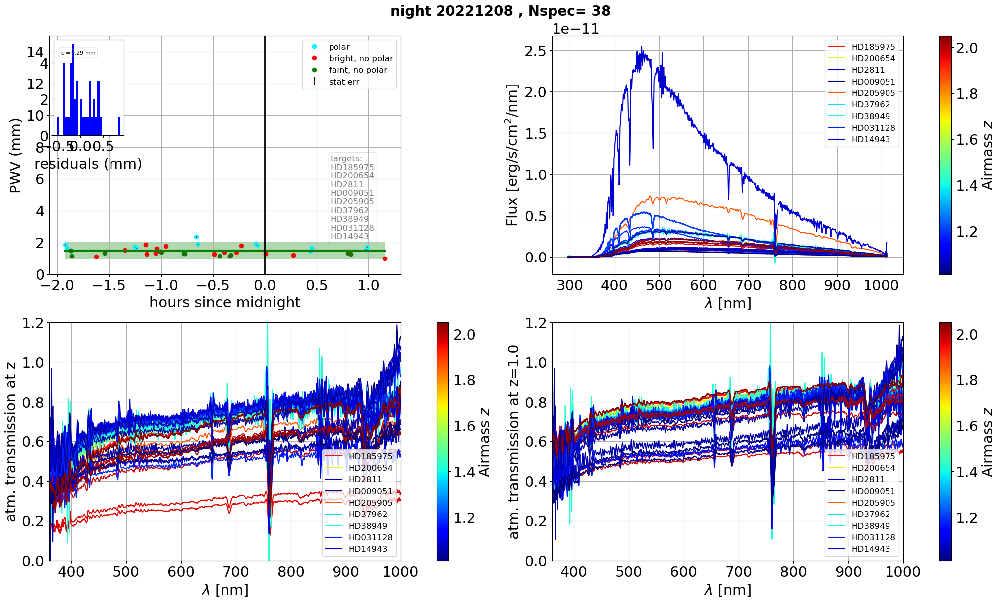

                id                                Time  PWV [mm]_x  \
132  2022120800043 2022-12-09 01:04:41.749993207+00:00    1.865649   
133  2022120800044 2022-12-09 01:05:24.669008185+00:00    1.680237   
134  2022120800048 2022-12-09 01:07:40.325996336+00:00    1.494400   
135  2022120800049 2022-12-09 01:08:23.281998723+00:00    1.135915   
136  2022120800068 2022-12-09 01:22:25.751490124+00:00    1.115675   
137  2022120800073 2022-12-09 01:27:17.879502141+00:00    1.338428   
138  2022120800084 2022-12-09 01:39:06.848509384+00:00    1.532290   
139  2022120800091 2022-12-09 01:45:01.891996710+00:00    1.725544   
140  2022120800092 2022-12-09 01:45:44.809494485+00:00    1.638472   
141  2022120800102 2022-12-09 01:51:12.368492377+00:00    1.865825   
142  2022120800103 2022-12-09 01:51:55.288007638+00:00    1.265600   
143  2022120800107 2022-12-09 01:56:50.879004519+00:00    1.342507   
144  2022120800108 2022-12-09 01:57:33.798505208+00:00    1.616644   
145  2022120800112 2

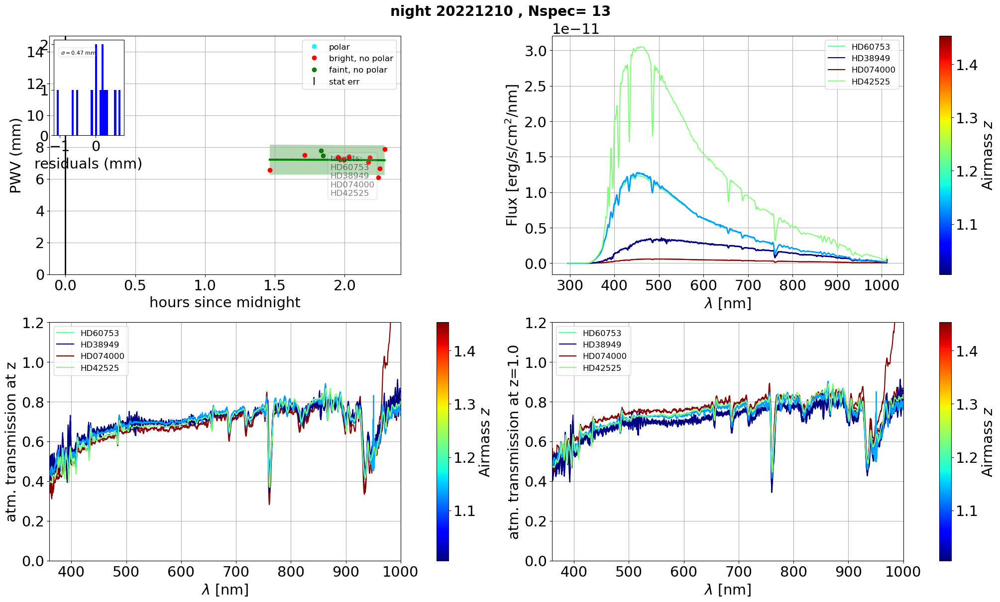

                id                                Time  PWV [mm]_x  \
179  2022121000232 2022-12-11 04:27:50.055005806+00:00    6.566568   
180  2022121000240 2022-12-11 04:42:50.585492014+00:00    7.485330   
181  2022121000243 2022-12-11 04:49:54.736000532+00:00    7.759761   
182  2022121000244 2022-12-11 04:50:37.650995394+00:00    7.464809   
183  2022121000250 2022-12-11 04:57:12.462502809+00:00    7.373940   
184  2022121000251 2022-12-11 04:57:55.389506696+00:00    7.208154   
185  2022121000253 2022-12-11 04:59:36.084507802+00:00    7.203570   
186  2022121000254 2022-12-11 05:01:49.869492179+00:00    7.401604   
187  2022121000261 2022-12-11 05:10:06.459004295+00:00    7.044866   
188  2022121000262 2022-12-11 05:10:49.309002440+00:00    7.323901   
189  2022121000265 2022-12-11 05:14:22.057006160+00:00    6.095841   
190  2022121000266 2022-12-11 05:15:04.976507415+00:00    6.649648   
191  2022121000268 2022-12-11 05:17:10.918502507+00:00    7.857457   

     PWV [mm]_err_x

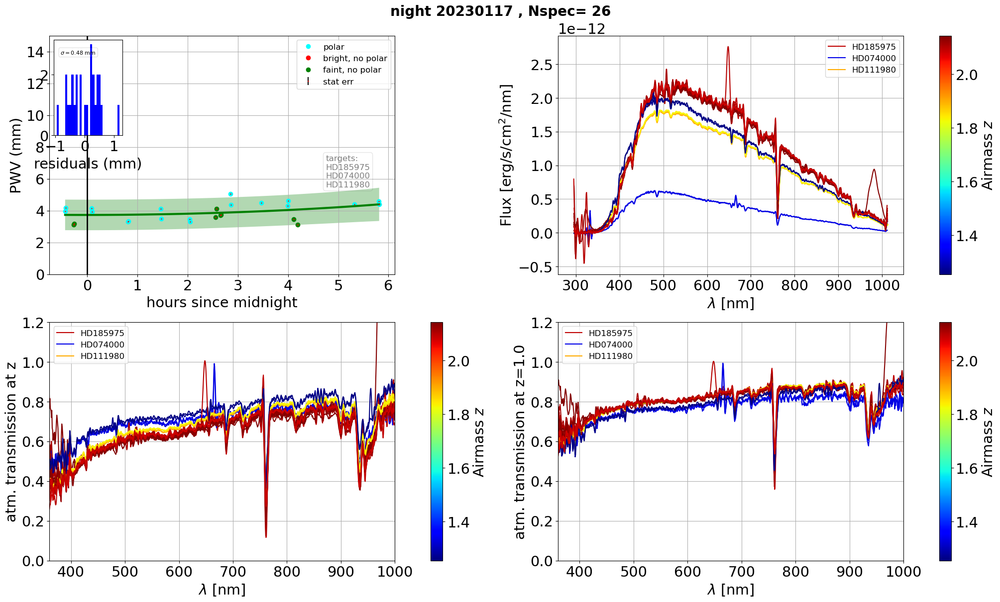

                id                                Time  PWV [mm]_x  \
202  2023011700238 2023-01-18 02:33:44.320492641+00:00    3.964458   
203  2023011700239 2023-01-18 02:34:27.138506292+00:00    4.187313   
204  2023011700243 2023-01-18 02:43:58.366995924+00:00    3.101272   
205  2023011700244 2023-01-18 02:44:41.368008749+00:00    3.176664   
206  2023011700248 2023-01-18 03:05:13.302506988+00:00    4.139623   
207  2023011700249 2023-01-18 03:05:56.221990758+00:00    3.920591   
208  2023011700297 2023-01-18 03:48:30.275498016+00:00    3.313487   
209  2023011700298 2023-01-18 03:49:13.267493074+00:00    3.334151   
210  2023011700348 2023-01-18 04:27:59.378503148+00:00    4.127692   
211  2023011700349 2023-01-18 04:28:42.290506469+00:00    3.498159   
212  2023011700389 2023-01-18 05:02:33.121509356+00:00    3.461384   
213  2023011700390 2023-01-18 05:03:16.039495757+00:00    3.293661   
214  2023011700420 2023-01-18 05:33:35.532999304+00:00    3.597283   
215  2023011700421 2

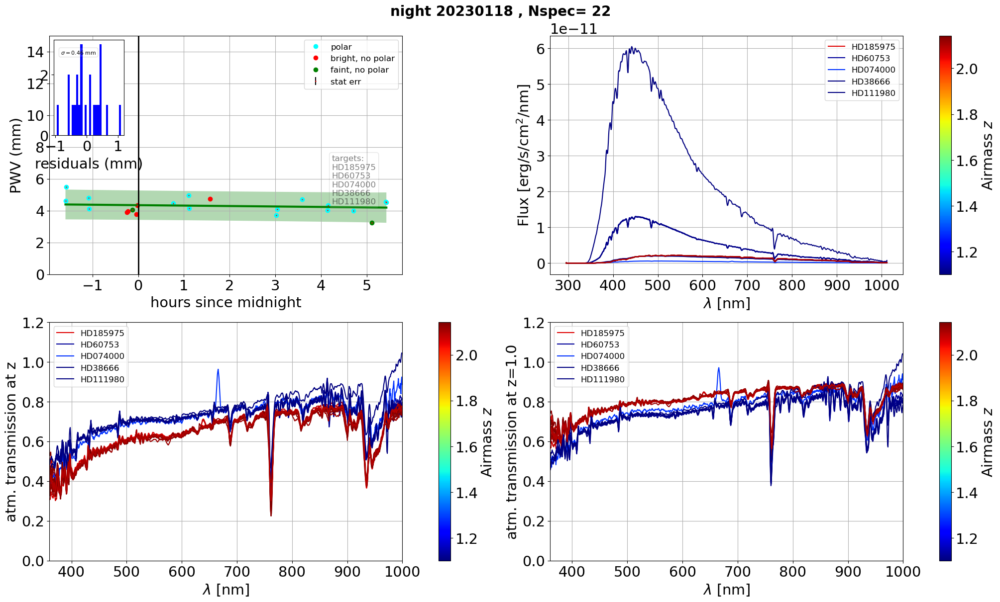

                id                                Time  PWV [mm]_x  \
228  2023011800248 2023-01-19 01:24:39.497501381+00:00    4.616520   
229  2023011800249 2023-01-19 01:25:22.309003658+00:00    5.480081   
230  2023011800287 2023-01-19 01:55:10.535505895+00:00    4.815070   
231  2023011800288 2023-01-19 01:55:53.539995972+00:00    4.104113   
232  2023011800337 2023-01-19 02:45:32.810994662+00:00    3.896231   
233  2023011800338 2023-01-19 02:46:15.633005964+00:00    3.947935   
234  2023011800347 2023-01-19 02:52:27.263993766+00:00    4.050865   
235  2023011800355 2023-01-19 02:57:57.100500175+00:00    3.785059   
236  2023011800356 2023-01-19 02:58:39.956998603+00:00    4.326676   
237  2023011800407 2023-01-19 03:45:43.994508623+00:00    4.454775   
238  2023011800431 2023-01-19 04:06:25.288502703+00:00    4.948453   
239  2023011800432 2023-01-19 04:07:08.060492192+00:00    4.151510   
240  2023011800472 2023-01-19 04:34:03.485494555+00:00    4.736966   
241  2023011800539 2

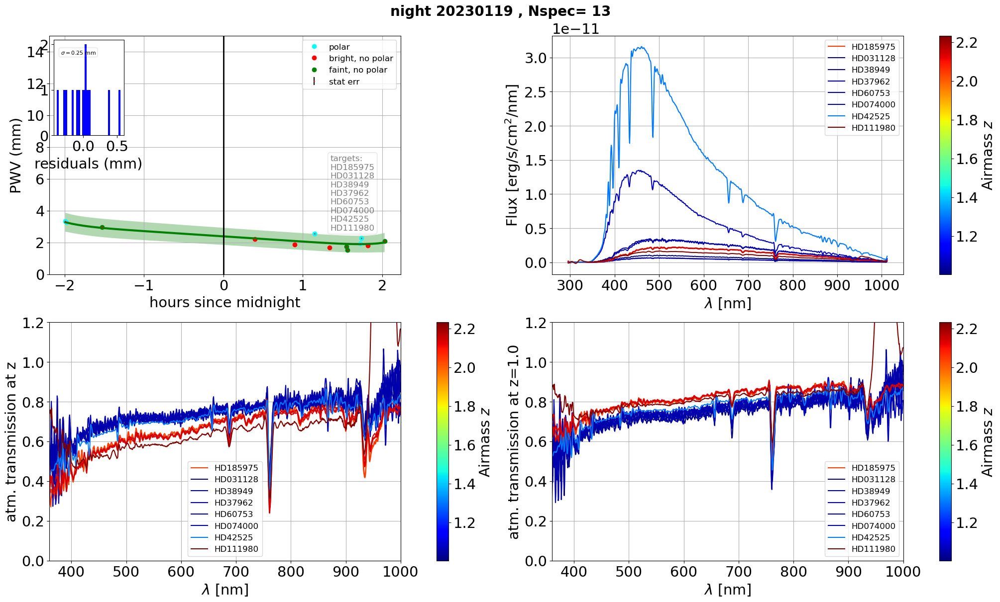

                id                                Time  PWV [mm]_x  \
250  2023011900162 2023-01-20 01:00:35.665507410+00:00    3.327830   
251  2023011900163 2023-01-20 01:01:18.656999553+00:00    3.261686   
252  2023011900198 2023-01-20 01:28:26.066006408+00:00    2.945712   
253  2023011900279 2023-01-20 03:23:48.118001971+00:00    2.208028   
254  2023011900306 2023-01-20 03:53:53.518494032+00:00    1.851018   
255  2023011900326 2023-01-20 04:08:47.657997597+00:00    2.561390   
256  2023011900344 2023-01-20 04:20:13.666999821+00:00    1.679864   
257  2023011900362 2023-01-20 04:33:03.783505305+00:00    1.752855   
258  2023011900363 2023-01-20 04:33:46.606005233+00:00    1.517612   
259  2023011900374 2023-01-20 04:43:20.000490399+00:00    1.942226   
260  2023011900375 2023-01-20 04:44:02.814992676+00:00    2.276008   
261  2023011900383 2023-01-20 04:49:00.981501774+00:00    1.804808   
262  2023011900402 2023-01-20 05:01:44.773490406+00:00    2.091168   

     PWV [mm]_err_x

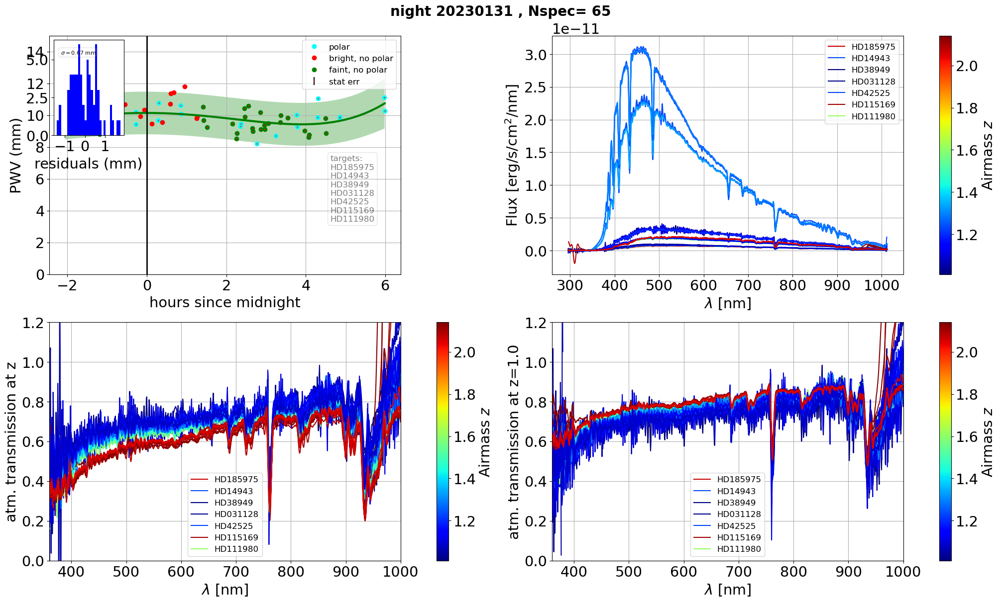

                id                                Time  PWV [mm]_x  \
263  2023013100219 2023-02-01 00:57:05.303493419+00:00   10.310510   
264  2023013100220 2023-02-01 00:57:48.131496261+00:00   10.134739   
265  2023013100228 2023-02-01 01:03:00.305990422+00:00   10.276076   
266  2023013100229 2023-02-01 01:03:43.119990067+00:00    9.936018   
267  2023013100247 2023-02-01 01:20:30.417500973+00:00   11.313441   
268  2023013100259 2023-02-01 01:30:35.976495066+00:00    9.617096   
269  2023013100260 2023-02-01 01:31:18.975490407+00:00    9.668530   
270  2023013100268 2023-02-01 01:36:31.200498204+00:00    9.604876   
271  2023013100269 2023-02-01 01:37:14.013497849+00:00   10.131177   
272  2023013100280 2023-02-01 01:48:23.634501685+00:00    8.804123   
273  2023013100310 2023-02-01 02:09:35.880496008+00:00    9.460531   
274  2023013100319 2023-02-01 02:15:25.356491475+00:00    9.760303   
275  2023013100337 2023-02-01 02:27:08.571990482+00:00   10.691151   
276  2023013100358 2

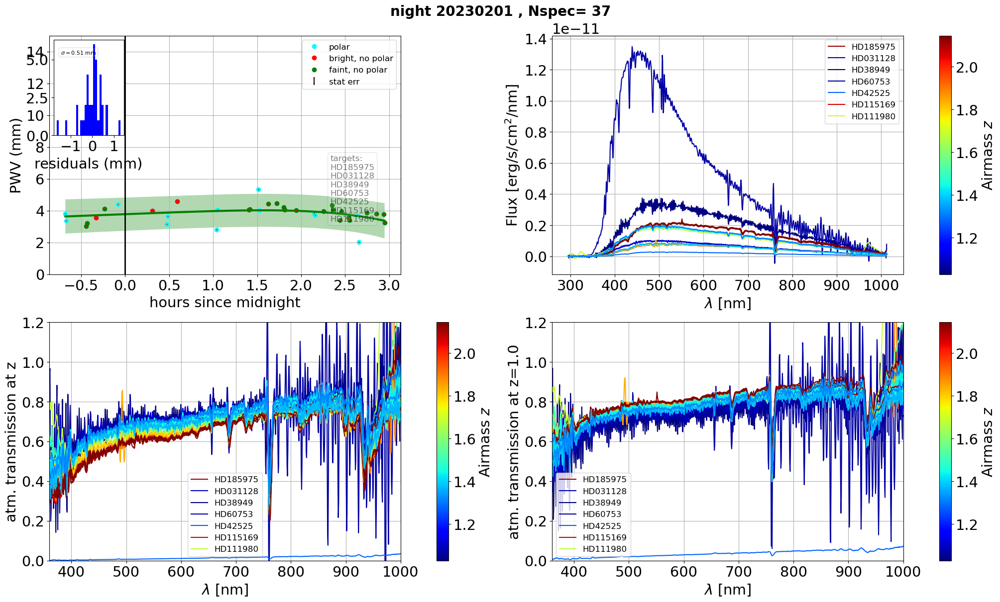

                id                                Time  PWV [mm]_x  \
328  2023020100387 2023-02-02 02:19:15.750504246+00:00    3.811822   
329  2023020100388 2023-02-02 02:19:58.572998346+00:00    3.368457   
330  2023020100405 2023-02-02 02:33:31.276997341+00:00    3.015450   
331  2023020100406 2023-02-02 02:34:14.189506491+00:00    3.204697   
332  2023020100415 2023-02-02 02:40:03.077503585+00:00    3.537250   
333  2023020100424 2023-02-02 02:45:47.208004302+00:00    4.114142   
334  2023020100435 2023-02-02 02:55:13.732496339+00:00    4.405803   
335  2023020100471 2023-02-02 03:18:33.981002991+00:00    3.988456   
336  2023020100480 2023-02-02 03:28:24.988995513+00:00    3.149683   
337  2023020100481 2023-02-02 03:29:07.804497789+00:00    3.631449   
338  2023020100491 2023-02-02 03:35:22.414991178+00:00    4.578237   
339  2023020100529 2023-02-02 04:02:10.443999604+00:00    2.817263   
340  2023020100530 2023-02-02 04:02:53.392492682+00:00    4.055329   
341  2023020100560 2

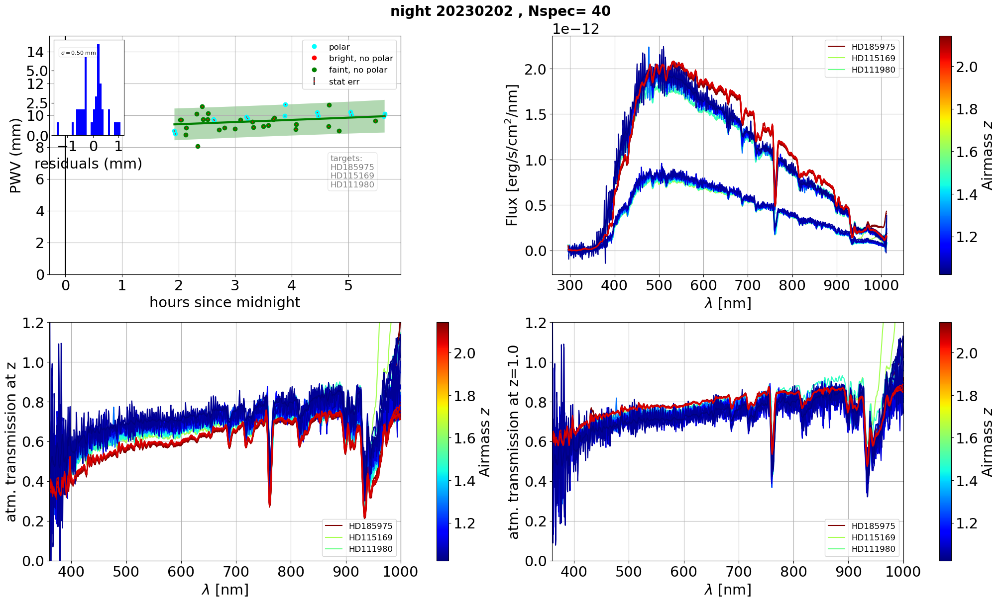

                id                                Time  PWV [mm]_x  \
365  2023020200642 2023-02-03 04:55:40.613993823+00:00    9.032592   
366  2023020200643 2023-02-03 04:56:23.537000624+00:00    8.850360   
367  2023020200651 2023-02-03 05:01:55.935501482+00:00    9.712721   
368  2023020200652 2023-02-03 05:02:38.908498889+00:00    9.707579   
369  2023020200660 2023-02-03 05:07:38.191495228+00:00    8.785418   
370  2023020200661 2023-02-03 05:08:21.139494700+00:00    9.200121   
371  2023020200674 2023-02-03 05:19:23.459993705+00:00   10.094103   
372  2023020200675 2023-02-03 05:20:06.373003137+00:00    8.063289   
373  2023020200683 2023-02-03 05:25:05.890506176+00:00   10.569612   
374  2023020200684 2023-02-03 05:25:48.859009128+00:00    9.734475   
375  2023020200692 2023-02-03 05:30:34.072509118+00:00    9.744205   
376  2023020200693 2023-02-03 05:31:16.987992605+00:00   10.124560   
377  2023020200701 2023-02-03 05:36:55.432507747+00:00    9.741608   
378  2023020200702 2

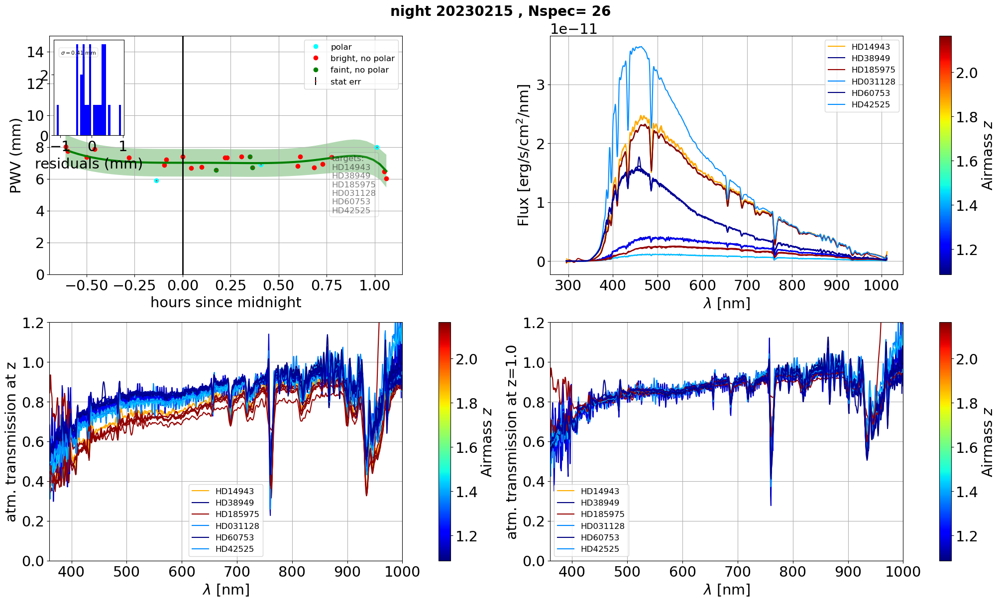

                id                                Time  PWV [mm]_x  \
415  2023021500299 2023-02-16 02:23:24.557505284+00:00    8.008715   
416  2023021500300 2023-02-16 02:24:07.506495731+00:00    7.750906   
417  2023021500310 2023-02-16 02:29:59.057991233+00:00    7.370612   
418  2023021500315 2023-02-16 02:32:32.611009990+00:00    7.853700   
419  2023021500335 2023-02-16 02:43:12.745509700+00:00    7.333356   
420  2023021500350 2023-02-16 02:51:49.918499506+00:00    5.905181   
421  2023021500354 2023-02-16 02:54:14.997002963+00:00    6.858916   
422  2023021500355 2023-02-16 02:54:57.911006567+00:00    7.216476   
423  2023021500364 2023-02-16 03:00:02.911998637+00:00    7.401484   
424  2023021500369 2023-02-16 03:02:36.588004717+00:00    6.689956   
425  2023021500375 2023-02-16 03:05:55.099502951+00:00    6.743082   
426  2023021500384 2023-02-16 03:10:27.558007860+00:00    6.569175   
427  2023021500389 2023-02-16 03:13:12.798495354+00:00    7.333812   
428  2023021500390 2

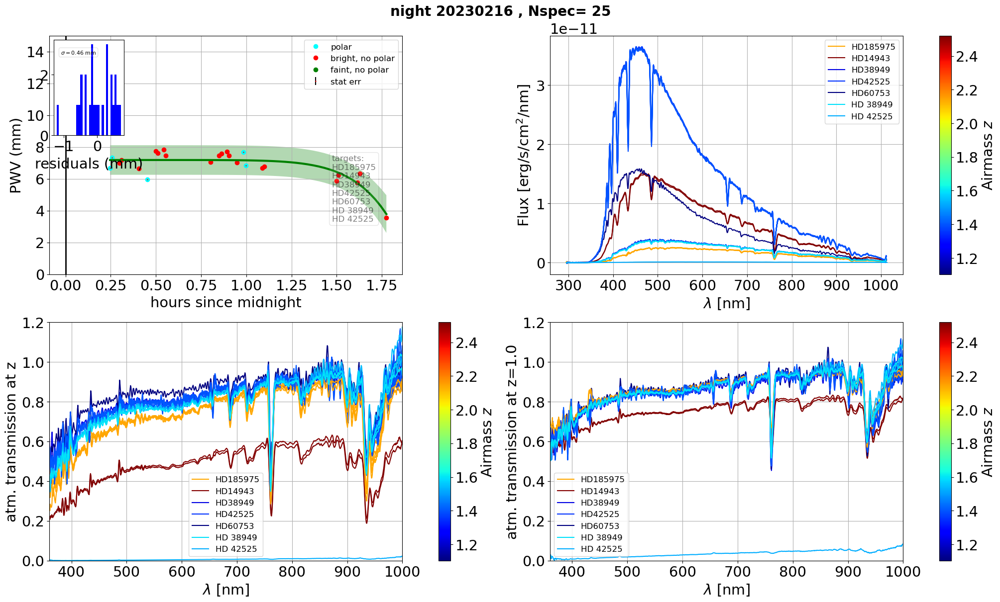

                id                                Time  PWV [mm]_x  \
441  2023021600201 2023-02-17 03:14:47.604494226+00:00    6.683073   
442  2023021600202 2023-02-17 03:15:30.551493415+00:00    7.349327   
443  2023021600206 2023-02-17 03:17:56.370498269+00:00    6.996847   
444  2023021600207 2023-02-17 03:18:39.278504222+00:00    7.180131   
445  2023021600217 2023-02-17 03:24:26.529501610+00:00    6.644350   
446  2023021600221 2023-02-17 03:27:08.800007113+00:00    5.967844   
447  2023021600226 2023-02-17 03:29:59.199504754+00:00    7.729872   
448  2023021600227 2023-02-17 03:30:42.104496418+00:00    7.607028   
449  2023021600231 2023-02-17 03:32:33.294990480+00:00    7.829099   
450  2023021600232 2023-02-17 03:33:16.235503675+00:00    7.473725   
451  2023021600261 2023-02-17 03:48:11.982000269+00:00    7.067224   
452  2023021600266 2023-02-17 03:51:00.146991088+00:00    7.473197   
453  2023021600267 2023-02-17 03:51:43.048999954+00:00    7.581626   
454  2023021600271 2

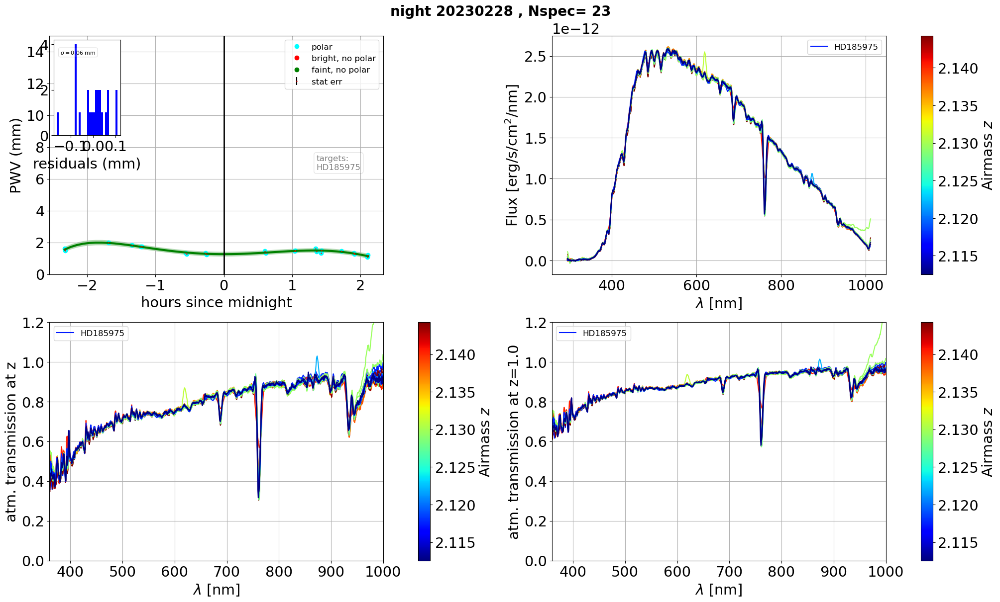

                id                                Time  PWV [mm]_x  \
466  2023022800039 2023-03-01 00:40:14.104491209+00:00    1.615720   
467  2023022800040 2023-03-01 00:40:57.110992661+00:00    1.496431   
468  2023022800095 2023-03-01 01:18:43.464502763+00:00    1.978406   
469  2023022800125 2023-03-01 01:39:20.178993247+00:00    1.828415   
470  2023022800135 2023-03-01 01:47:14.420504827+00:00    1.754682   
471  2023022800136 2023-03-01 01:47:57.332493860+00:00    1.731499   
472  2023022800156 2023-03-01 02:26:38.850991030+00:00    1.344324   
473  2023022800157 2023-03-01 02:27:21.747993786+00:00    1.285062   
474  2023022800179 2023-03-01 02:44:08.170498205+00:00    1.329112   
475  2023022800180 2023-03-01 02:44:51.086993066+00:00    1.228824   
476  2023022800218 2023-03-01 03:35:59.906996922+00:00    1.458352   
477  2023022800219 2023-03-01 03:36:42.817997046+00:00    1.339432   
478  2023022800250 2023-03-01 04:02:05.430998028+00:00    1.469895   
479  2023022800251 2

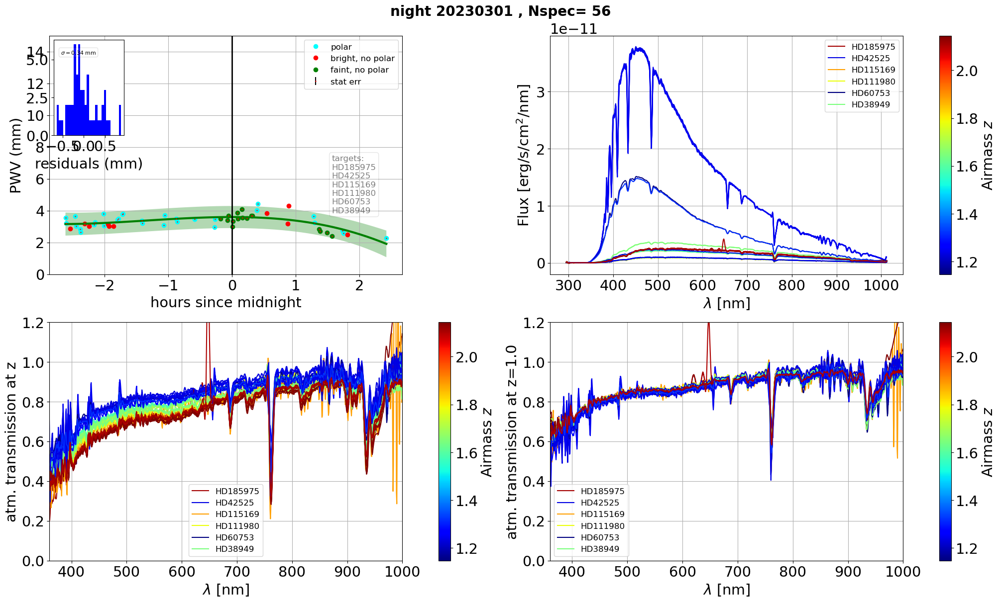

                id                                Time  PWV [mm]_x  \
489  2023030100186 2023-03-02 00:22:59.764997027+00:00    3.554490   
490  2023030100187 2023-03-02 00:23:42.674503263+00:00    3.222175   
491  2023030100194 2023-03-02 00:27:33.250508250+00:00    2.862094   
492  2023030100202 2023-03-02 00:32:12.762491457+00:00    3.642114   
493  2023030100203 2023-03-02 00:32:55.673997692+00:00    3.023132   
494  2023030100210 2023-03-02 00:36:38.605496780+00:00    2.827898   
495  2023030100211 2023-03-02 00:37:21.698001342+00:00    2.637658   
496  2023030100218 2023-03-02 00:41:14.005991291+00:00    3.174710   
497  2023030100226 2023-03-02 00:45:23.778493748+00:00    3.024016   
498  2023030100234 2023-03-02 00:50:04.739494689+00:00    3.109325   
499  2023030100235 2023-03-02 00:50:47.643506187+00:00    3.280673   
500  2023030100245 2023-03-02 00:58:42.365991500+00:00    3.806840   
501  2023030100246 2023-03-02 00:59:25.371001411+00:00    3.048736   
502  2023030100253 2

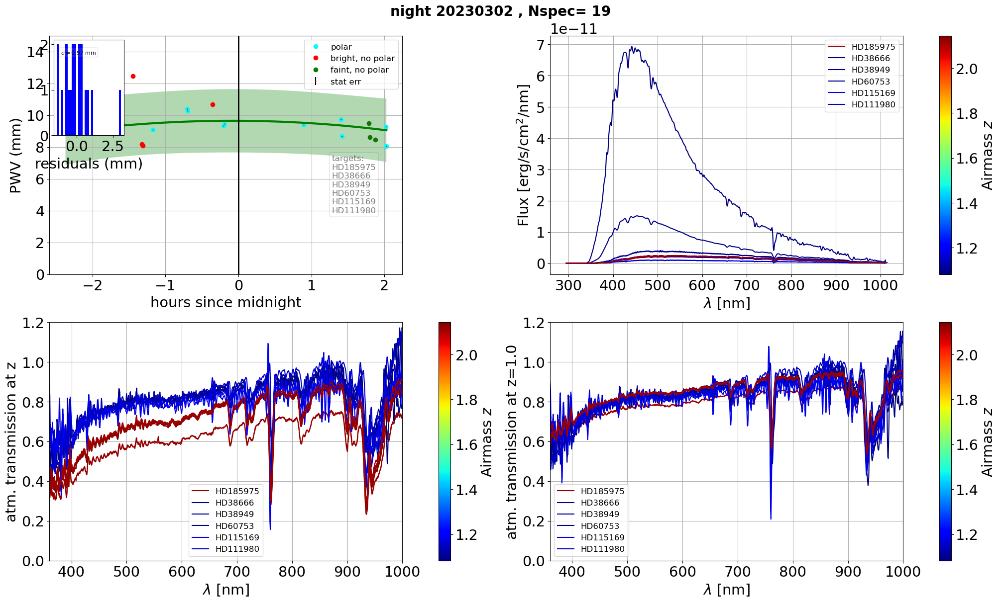

                id                                Time  PWV [mm]_x  \
545  2023030200035 2023-03-03 00:37:43.813992546+00:00    8.895903   
546  2023030200036 2023-03-03 00:38:26.836491366+00:00    9.121118   
547  2023030200104 2023-03-03 01:33:19.294505383+00:00   12.451188   
548  2023030200112 2023-03-03 01:40:34.542505513+00:00    8.183581   
549  2023030200113 2023-03-03 01:41:17.550498222+00:00    8.080147   
550  2023030200123 2023-03-03 01:49:29.376993279+00:00    9.093070   
551  2023030200155 2023-03-03 02:17:40.147007545+00:00   10.413568   
552  2023030200156 2023-03-03 02:18:23.190007779+00:00   10.280691   
553  2023030200178 2023-03-03 02:38:34.775997427+00:00   10.683336   
554  2023030200194 2023-03-03 02:47:37.793990965+00:00    9.328072   
555  2023030200195 2023-03-03 02:48:20.809992982+00:00    9.451864   
556  2023030200267 2023-03-03 03:53:41.655997544+00:00    9.397756   
557  2023030200304 2023-03-03 04:24:31.949003855+00:00    9.747554   
558  2023030200305 2

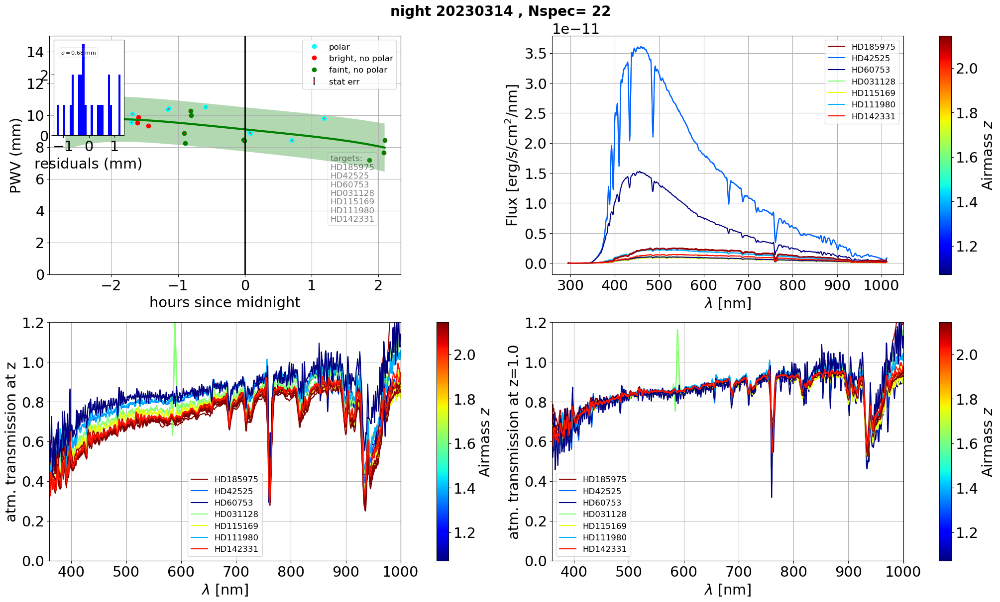

                id                                Time  PWV [mm]_x  \
564  2023031400419 2023-03-15 00:18:49.331005026+00:00    9.182675   
565  2023031400494 2023-03-15 01:18:08.705992426+00:00    9.552952   
566  2023031400495 2023-03-15 01:18:51.881992204+00:00   10.078416   
567  2023031400502 2023-03-15 01:23:38.350994398+00:00    9.518447   
568  2023031400503 2023-03-15 01:24:21.524005550+00:00    9.855825   
569  2023031400518 2023-03-15 01:33:28.587504508+00:00    9.332279   
570  2023031400542 2023-03-15 01:50:49.723008542+00:00   10.369837   
571  2023031400543 2023-03-15 01:51:32.663493443+00:00   10.434153   
572  2023031400566 2023-03-15 02:05:33.673008844+00:00    8.879974   
573  2023031400567 2023-03-15 02:06:16.675504750+00:00    8.227333   
574  2023031400574 2023-03-15 02:11:16.251498395+00:00   10.260706   
575  2023031400575 2023-03-15 02:11:59.254508589+00:00    9.978829   
576  2023031400585 2023-03-15 02:24:57.872995534+00:00   10.535771   
577  2023031400625 2

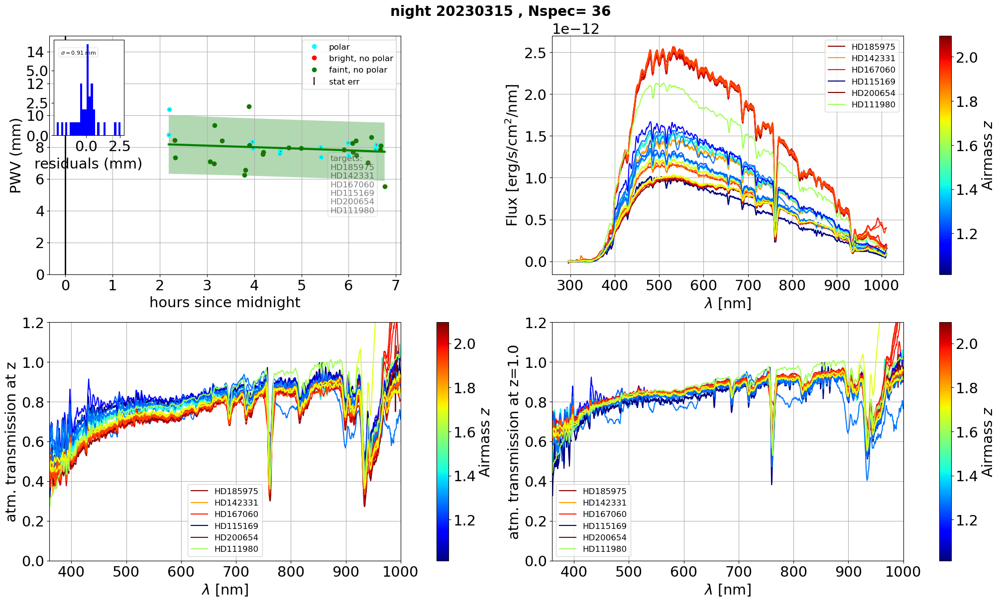

                id                                Time  PWV [mm]_x  \
586  2023031500617 2023-03-16 05:11:21.499995014+00:00    8.761562   
587  2023031500618 2023-03-16 05:12:04.498004925+00:00   10.370963   
588  2023031500625 2023-03-16 05:19:03.555003211+00:00    8.433820   
589  2023031500626 2023-03-16 05:19:46.505502400+00:00    7.349588   
590  2023031500678 2023-03-16 06:03:36.152005231+00:00    7.098255   
591  2023031500686 2023-03-16 06:08:48.300501457+00:00    6.953504   
592  2023031500687 2023-03-16 06:09:31.303994449+00:00    9.383036   
593  2023031500703 2023-03-16 06:18:47.320001425+00:00    8.399180   
594  2023031500741 2023-03-16 06:47:49.006503427+00:00    6.253487   
595  2023031500742 2023-03-16 06:48:31.921492460+00:00    6.566139   
596  2023031500749 2023-03-16 06:52:59.484992422+00:00   10.562677   
597  2023031500750 2023-03-16 06:53:42.489999702+00:00    8.102949   
598  2023031500757 2023-03-16 06:57:40.981994736+00:00    8.340787   
599  2023031500758 2

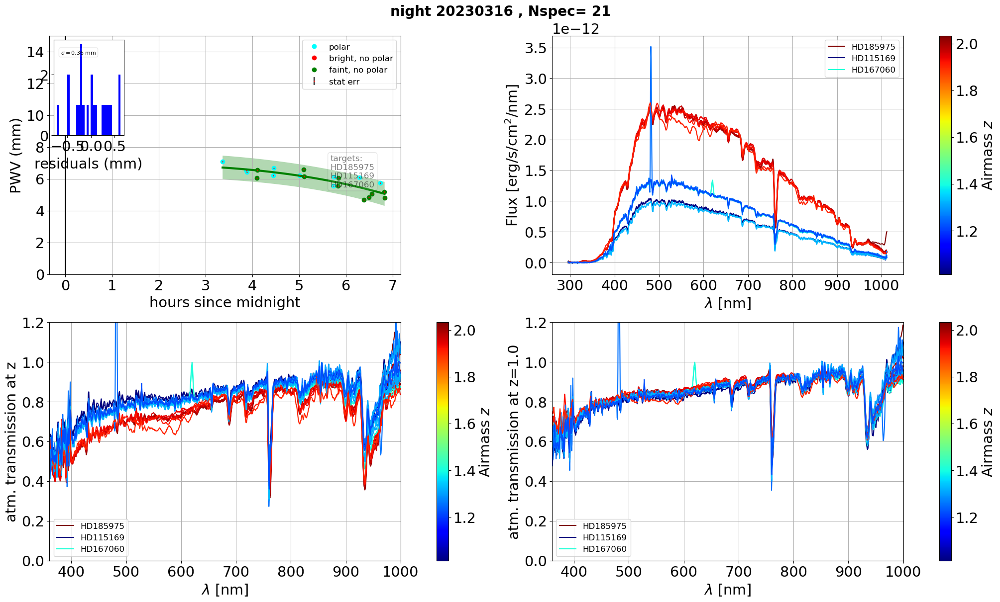

                id                                Time  PWV [mm]_x  \
622  2023031600466 2023-03-17 06:21:39.074005228+00:00    7.074578   
623  2023031600505 2023-03-17 06:52:06.172502735+00:00    6.516496   
624  2023031600506 2023-03-17 06:52:49.175495727+00:00    6.427708   
625  2023031600520 2023-03-17 07:05:24.270498178+00:00    6.048583   
626  2023031600521 2023-03-17 07:06:07.356505372+00:00    6.569139   
627  2023031600544 2023-03-17 07:26:52.619493301+00:00    6.211598   
628  2023031600545 2023-03-17 07:27:35.585004713+00:00    6.671084   
629  2023031600590 2023-03-17 08:00:36.347990813+00:00    6.217672   
630  2023031600597 2023-03-17 08:05:41.034001650+00:00    6.587220   
631  2023031600598 2023-03-17 08:06:24.054498121+00:00    6.150375   
632  2023031600645 2023-03-17 08:43:51.125005011+00:00    5.543361   
633  2023031600646 2023-03-17 08:44:34.193006376+00:00    6.131425   
634  2023031600653 2023-03-17 08:49:34.229004395+00:00    5.544224   
635  2023031600654 2

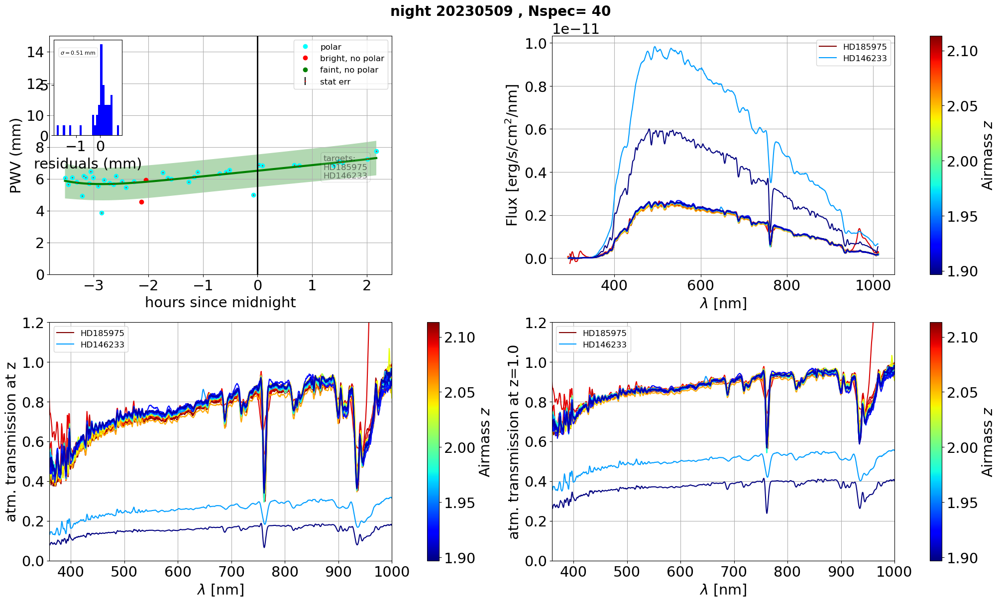

                id                                Time  PWV [mm]_x  \
643  2023050900219 2023-05-10 00:28:21.382504993+00:00    6.052410   
644  2023050900226 2023-05-10 00:31:50.658504015+00:00    5.659066   
645  2023050900235 2023-05-10 00:36:05.730501591+00:00    6.070267   
646  2023050900246 2023-05-10 00:41:19.354491586+00:00    5.795499   
647  2023050900257 2023-05-10 00:47:00.459490565+00:00    4.938703   
648  2023050900261 2023-05-10 00:48:38.690495918+00:00    6.170764   
649  2023050900266 2023-05-10 00:51:12.908506567+00:00    6.099707   
650  2023050900273 2023-05-10 00:54:45.784501654+00:00    5.704005   
651  2023050900277 2023-05-10 00:56:23.693002176+00:00    6.453245   
652  2023050900282 2023-05-10 00:58:58.477495214+00:00    6.069780   
653  2023050900288 2023-05-10 01:04:30.566995570+00:00    5.541046   
654  2023050900292 2023-05-10 01:08:27.638507841+00:00    3.875693   
655  2023050900297 2023-05-10 01:11:12.721497575+00:00    5.914592   
656  2023050900303 2

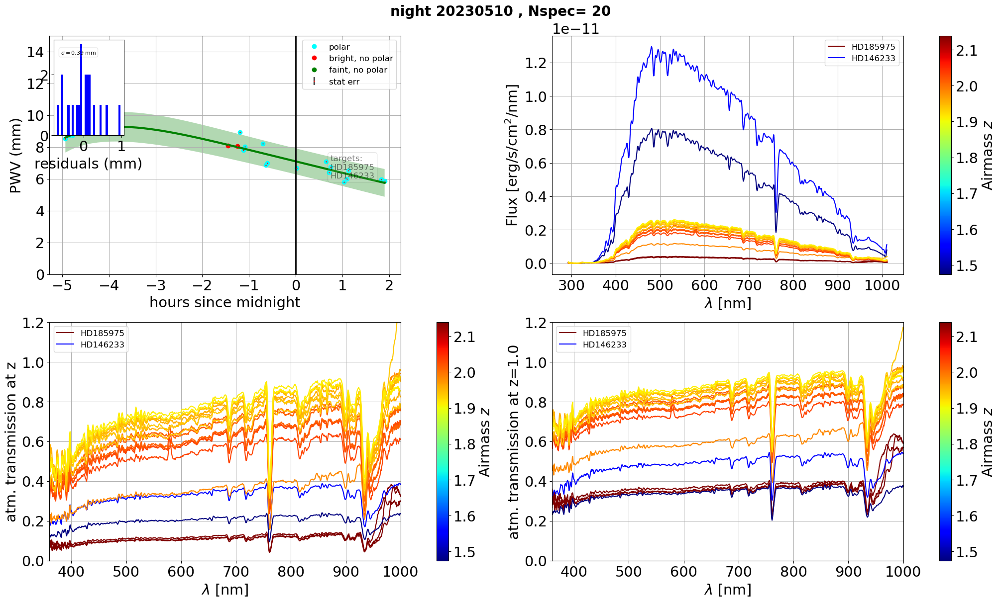

                id                                Time  PWV [mm]_x  \
683  2023051000061 2023-05-10 23:04:00.313496782+00:00    8.530165   
684  2023051000066 2023-05-10 23:09:45.379491959+00:00    8.748312   
685  2023051000069 2023-05-10 23:13:36.058507581+00:00    8.744525   
686  2023051000278 2023-05-11 02:32:49.538503640+00:00    8.076039   
687  2023051000298 2023-05-11 02:45:09.390508299+00:00    8.046999   
688  2023051000302 2023-05-11 02:48:37.545990654+00:00    8.934637   
689  2023051000307 2023-05-11 02:52:34.355495660+00:00    7.812923   
690  2023051000310 2023-05-11 02:54:28.721491286+00:00    8.016506   
691  2023051000344 2023-05-11 03:17:49.809491637+00:00    8.207646   
692  2023051000349 2023-05-11 03:21:43.592006562+00:00    6.855052   
693  2023051000352 2023-05-11 03:23:36.668501767+00:00    6.985918   
694  2023051000396 2023-05-11 04:01:24.785997113+00:00    6.689641   
695  2023051000448 2023-05-11 04:39:11.295004977+00:00    7.082488   
696  2023051000453 2

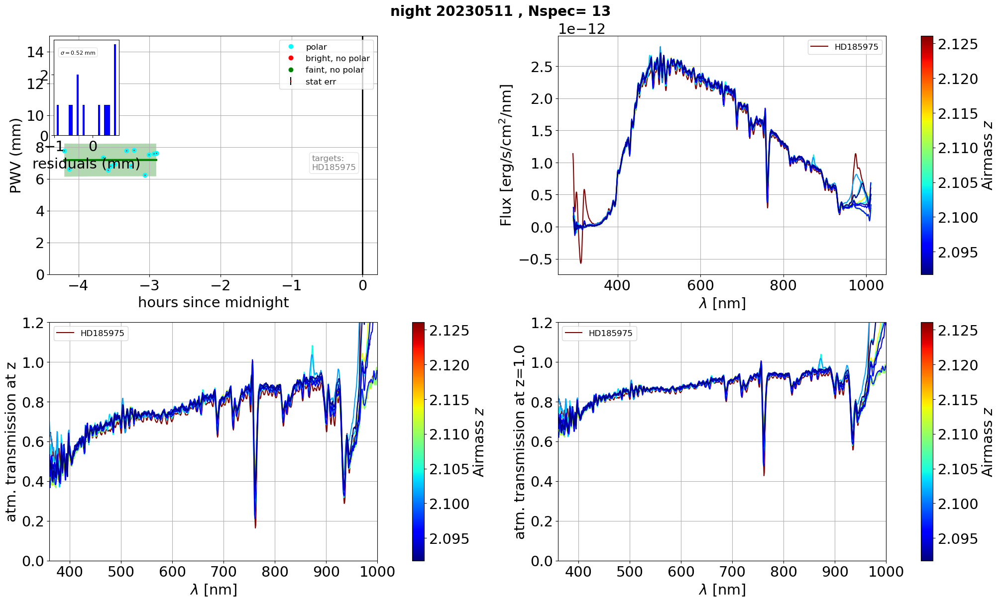

                id                                Time  PWV [mm]_x  \
703  2023051100155 2023-05-11 23:48:05.694491537+00:00    7.781948   
704  2023051100160 2023-05-11 23:52:01.599991556+00:00    6.617262   
705  2023051100203 2023-05-12 00:20:48.671994986+00:00    7.349094   
706  2023051100208 2023-05-12 00:25:00.275996890+00:00    6.565431   
707  2023051100211 2023-05-12 00:27:16.900995204+00:00    6.798511   
708  2023051100215 2023-05-12 00:30:20.002006062+00:00    6.916493   
709  2023051100228 2023-05-12 00:40:22.965507207+00:00    7.782208   
710  2023051100233 2023-05-12 00:44:31.382492410+00:00    6.793548   
711  2023051100236 2023-05-12 00:46:44.261508838+00:00    7.794874   
712  2023051100248 2023-05-12 00:56:15.004507535+00:00    6.246723   
713  2023051100252 2023-05-12 00:59:15.394492061+00:00    7.522246   
714  2023051100257 2023-05-12 01:03:30.314509927+00:00    7.588169   
715  2023051100260 2023-05-12 01:05:44.961991483+00:00    7.623719   

     PWV [mm]_err_x

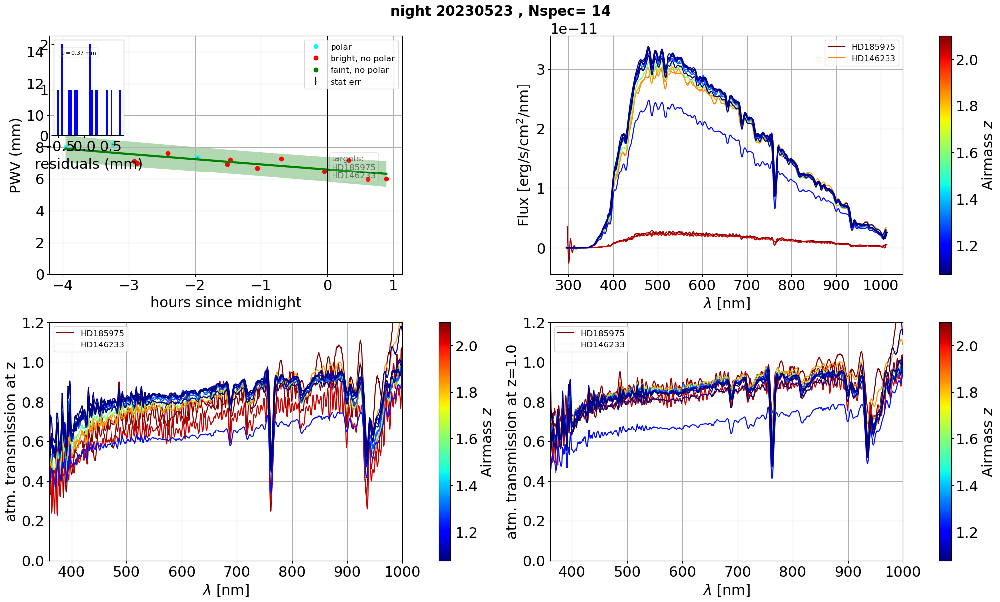

                id                                Time  PWV [mm]_x  \
716  2023052300178 2023-05-24 00:02:32.143997751+00:00    7.985282   
717  2023052300243 2023-05-24 00:45:49.784998157+00:00    8.184587   
718  2023052300271 2023-05-24 01:05:01.006006379+00:00    7.113481   
719  2023052300275 2023-05-24 01:07:37.302003341+00:00    7.001868   
720  2023052300312 2023-05-24 01:35:15.489491996+00:00    7.619113   
721  2023052300350 2023-05-24 02:01:52.059491475+00:00    7.353495   
722  2023052300393 2023-05-24 02:29:42.807498783+00:00    6.938491   
723  2023052300397 2023-05-24 02:32:08.387993741+00:00    7.200932   
724  2023052300439 2023-05-24 02:56:52.940492020+00:00    6.694288   
725  2023052300476 2023-05-24 03:18:31.504503476+00:00    7.261437   
726  2023052300525 2023-05-24 03:57:09.890006040+00:00    6.448280   
727  2023052300563 2023-05-24 04:19:47.239009654+00:00    7.189609   
728  2023052300592 2023-05-24 04:37:05.992507040+00:00    5.949161   
729  2023052300606 2

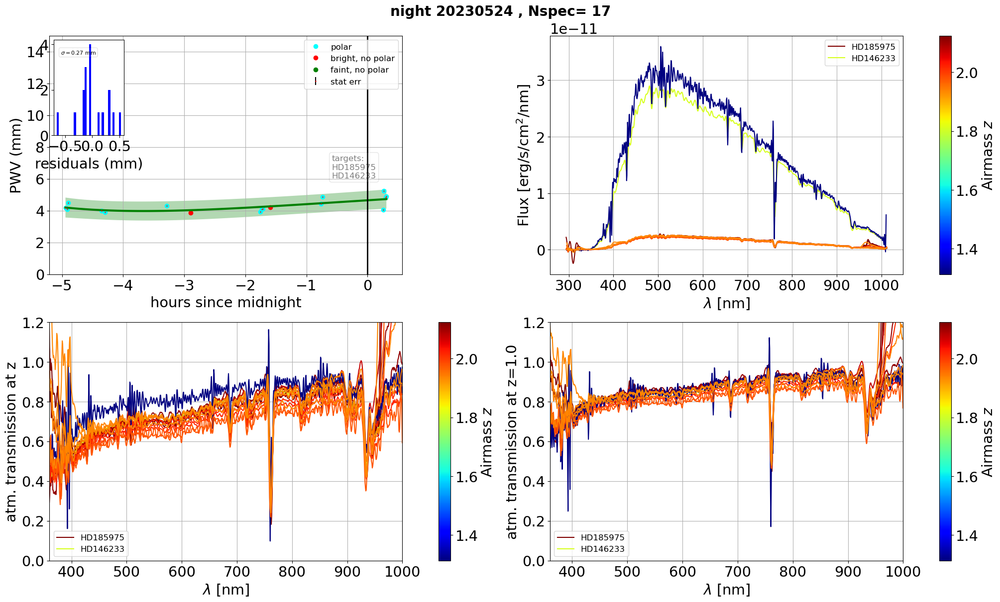

                id                                Time  PWV [mm]_x  \
730  2023052400109 2023-05-24 23:03:25.745008085+00:00    4.168475   
731  2023052400112 2023-05-24 23:05:10.118505735+00:00    4.079758   
732  2023052400113 2023-05-24 23:05:53.128501641+00:00    4.475320   
733  2023052400164 2023-05-24 23:38:53.215006658+00:00    3.976577   
734  2023052400169 2023-05-24 23:42:04.929005849+00:00    3.900626   
735  2023052400267 2023-05-25 00:42:42.104497991+00:00    4.295080   
736  2023052400299 2023-05-25 01:06:32.067495070+00:00    3.858461   
737  2023052400408 2023-05-25 02:14:32.922505643+00:00    3.915880   
738  2023052400411 2023-05-25 02:16:16.928499680+00:00    4.079171   
739  2023052400412 2023-05-25 02:16:59.934509874+00:00    4.116001   
740  2023052400421 2023-05-25 02:24:26.066503941+00:00    4.220310   
741  2023052400498 2023-05-25 03:14:12.032002978+00:00    4.436738   
742  2023052400501 2023-05-25 03:15:55.409500143+00:00    4.858637   
743  2023052400591 2

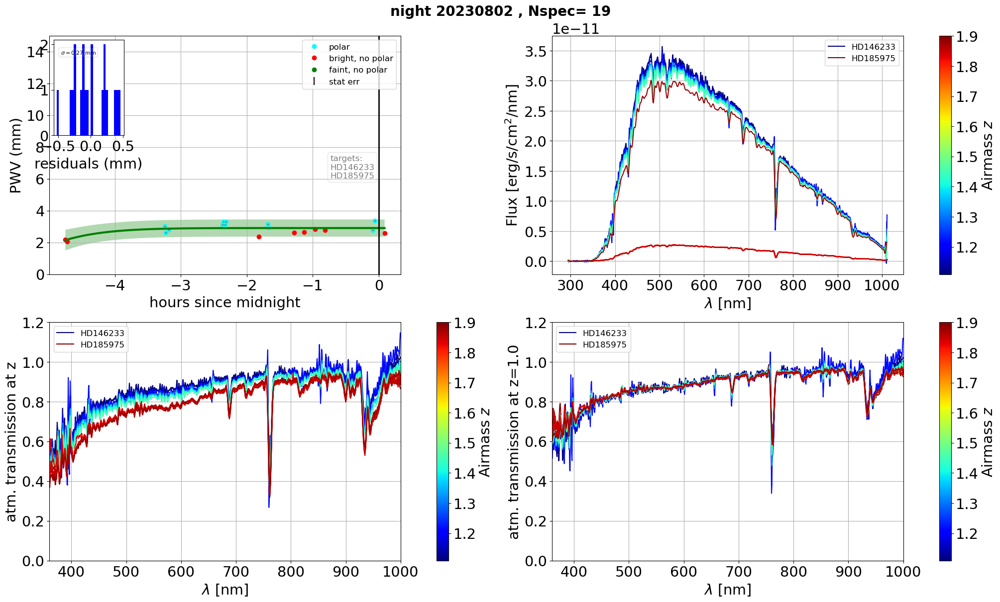

                id                                Time  PWV [mm]_x  \
748  2023080200280 2023-08-02 23:15:02.255509377+00:00    2.177745   
749  2023080200283 2023-08-02 23:16:48.498007604+00:00    2.053580   
750  2023080200322 2023-08-03 00:45:37.903003734+00:00    3.032474   
751  2023080200323 2023-08-03 00:46:20.994494574+00:00    2.620801   
752  2023080200327 2023-08-03 00:48:55.877006141+00:00    2.807175   
753  2023080200370 2023-08-03 01:38:06.739492360+00:00    3.100086   
754  2023080200371 2023-08-03 01:38:49.742990897+00:00    3.293490   
755  2023080200373 2023-08-03 01:40:24.792505211+00:00    3.121025   
756  2023080200374 2023-08-03 01:41:07.702508532+00:00    3.313094   
757  2023080200415 2023-08-03 02:10:53.698995770+00:00    2.378381   
758  2023080200426 2023-08-03 02:19:10.164494054+00:00    3.160867   
759  2023080200427 2023-08-03 02:19:53.079009032+00:00    2.915487   
760  2023080200458 2023-08-03 02:43:03.201991653+00:00    2.610981   
761  2023080200472 2

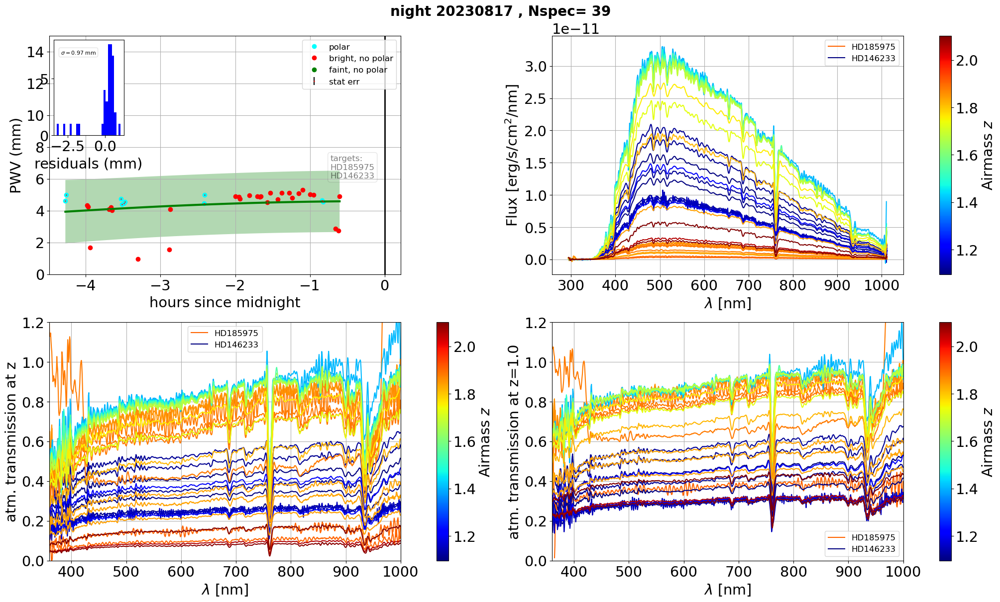

                id                                Time  PWV [mm]_x  \
767  2023081700147 2023-08-17 23:43:34.353508556+00:00    4.620669   
768  2023081700148 2023-08-17 23:44:17.427504376+00:00    4.989371   
769  2023081700166 2023-08-18 00:01:03.484502834+00:00    4.329859   
770  2023081700167 2023-08-18 00:01:46.402002958+00:00    4.255059   
771  2023081700170 2023-08-18 00:03:33.032494272+00:00    1.662382   
772  2023081700195 2023-08-18 00:18:30.257498922+00:00    4.087654   
773  2023081700198 2023-08-18 00:20:17.703002920+00:00    4.205801   
774  2023081700199 2023-08-18 00:21:00.613508873+00:00    4.013053   
775  2023081700209 2023-08-18 00:28:10.163000115+00:00    4.732906   
776  2023081700210 2023-08-18 00:28:53.071503153+00:00    4.390070   
777  2023081700213 2023-08-18 00:30:44.668990584+00:00    4.460668   
778  2023081700214 2023-08-18 00:31:27.623998799+00:00    4.547946   
779  2023081700227 2023-08-18 00:41:54.501497358+00:00    0.945261   
780  2023081700269 2

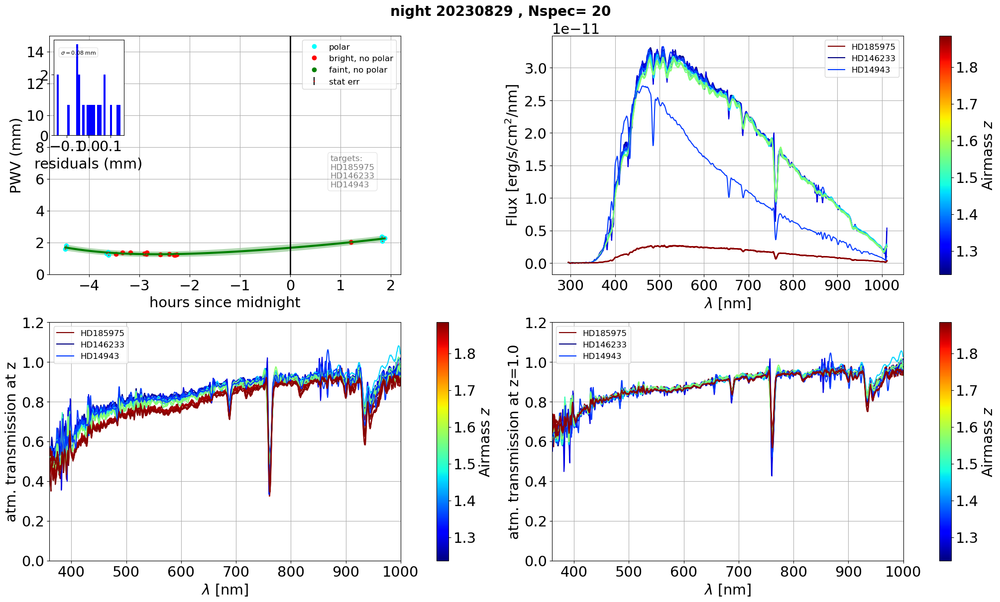

                id                                Time  PWV [mm]_x  \
806  2023082900178 2023-08-29 23:31:31.129992065+00:00    1.588429   
807  2023082900179 2023-08-29 23:32:14.142990886+00:00    1.807378   
808  2023082900208 2023-08-30 00:20:29.035509409+00:00    1.314179   
809  2023082900211 2023-08-30 00:22:21.689493476+00:00    1.405590   
810  2023082900212 2023-08-30 00:23:04.714495776+00:00    1.215107   
811  2023082900222 2023-08-30 00:31:44.723493973+00:00    1.280610   
812  2023082900235 2023-08-30 00:39:37.038491057+00:00    1.376121   
813  2023082900250 2023-08-30 00:48:59.949009777+00:00    1.353891   
814  2023082900277 2023-08-30 01:05:33.406001891+00:00    1.313174   
815  2023082900281 2023-08-30 01:08:11.720000105+00:00    1.281601   
816  2023082900282 2023-08-30 01:08:54.717995446+00:00    1.362553   
817  2023082900301 2023-08-30 01:24:50.987499803+00:00    1.236244   
818  2023082900318 2023-08-30 01:35:31.780497799+00:00    1.255832   
819  2023082900328 2

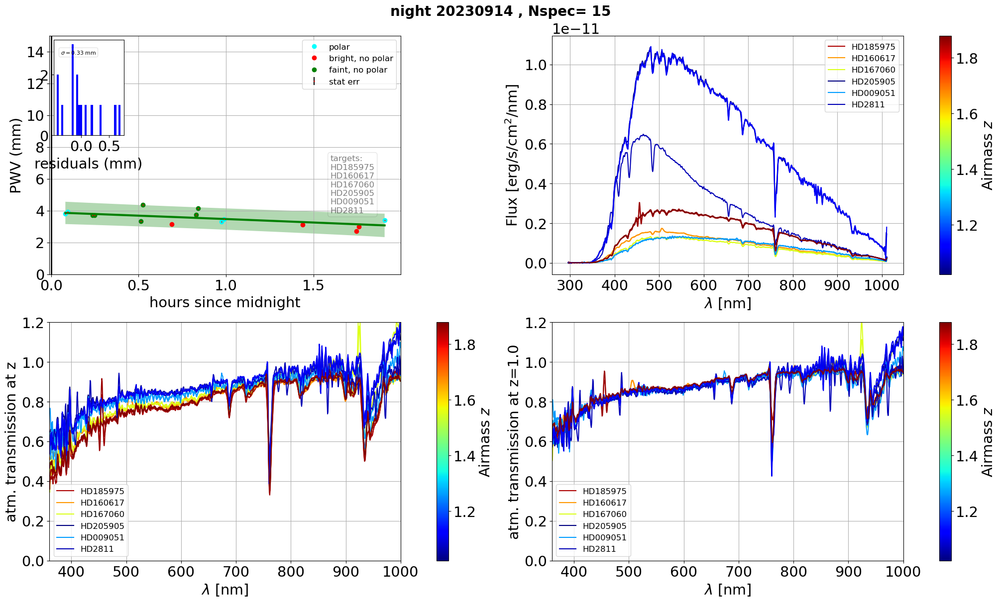

                id                                Time  PWV [mm]_x  \
839  2023091400118 2023-09-15 03:04:54.132502754+00:00    3.799890   
840  2023091400119 2023-09-15 03:05:37.105000160+00:00    3.932371   
841  2023091400130 2023-09-15 03:14:10.220993006+00:00    3.701742   
842  2023091400131 2023-09-15 03:14:53.220508463+00:00    3.704857   
843  2023091400143 2023-09-15 03:30:43.782498103+00:00    3.339632   
844  2023091400144 2023-09-15 03:31:26.804505949+00:00    4.379622   
845  2023091400156 2023-09-15 03:41:23.031990762+00:00    3.161762   
846  2023091400167 2023-09-15 03:49:44.106994621+00:00    3.725809   
847  2023091400168 2023-09-15 03:50:27.052507816+00:00    4.160087   
848  2023091400180 2023-09-15 03:58:33.777506363+00:00    3.316174   
849  2023091400181 2023-09-15 03:59:16.928996551+00:00    3.460660   
850  2023091400213 2023-09-15 04:26:14.404507408+00:00    3.106740   
851  2023091400237 2023-09-15 04:44:49.634504503+00:00    2.716106   
852  2023091400238 2

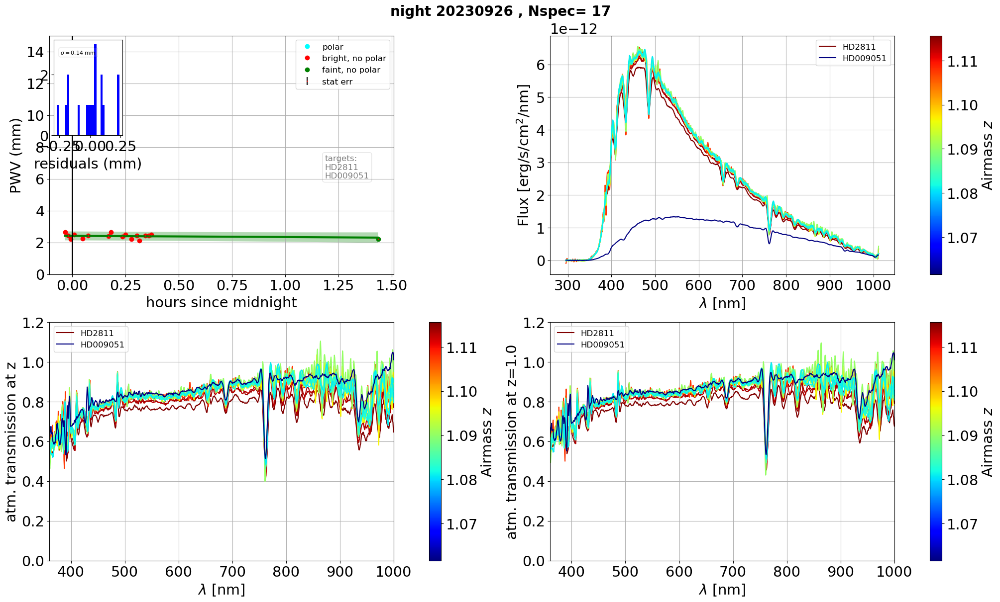

                id                                Time  PWV [mm]_x  \
854  2023092600451 2023-09-27 02:57:56.732499760+00:00    2.652184   
855  2023092600452 2023-09-27 02:58:52.360496465+00:00    2.427250   
856  2023092600453 2023-09-27 02:59:35.273505897+00:00    2.221589   
857  2023092600454 2023-09-27 03:00:30.197990962+00:00    2.504033   
858  2023092600457 2023-09-27 03:02:51.056997068+00:00    2.236443   
859  2023092600459 2023-09-27 03:04:28.939499656+00:00    2.436569   
860  2023092600466 2023-09-27 03:10:13.768008250+00:00    2.385337   
861  2023092600467 2023-09-27 03:10:56.702506874+00:00    2.637633   
862  2023092600471 2023-09-27 03:14:08.818496520+00:00    2.368355   
863  2023092600472 2023-09-27 03:15:01.834502908+00:00    2.491600   
864  2023092600474 2023-09-27 03:16:37.855002004+00:00    2.208197   
865  2023092600476 2023-09-27 03:18:14.118508083+00:00    2.436295   
866  2023092600477 2023-09-27 03:18:57.038003227+00:00    2.117987   
867  2023092600479 2

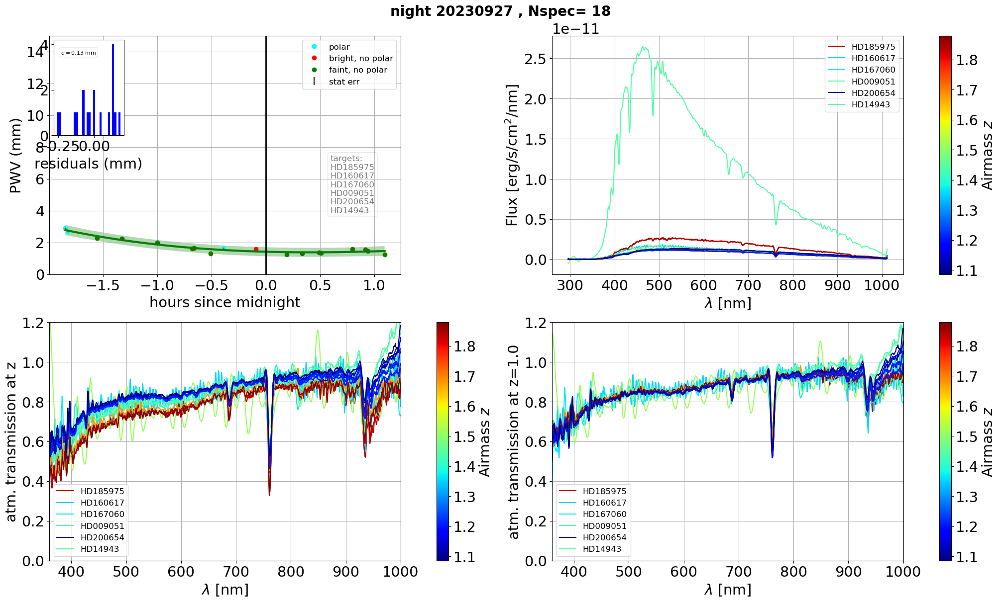

                id                                Time  PWV [mm]_x  \
871  2023092700282 2023-09-28 01:09:07.731001435+00:00    2.904801   
872  2023092700283 2023-09-28 01:10:20.660995968+00:00    2.671598   
873  2023092700298 2023-09-28 01:26:38.285000941+00:00    2.272170   
874  2023092700309 2023-09-28 01:40:32.120491504+00:00    2.252899   
875  2023092700327 2023-09-28 02:00:00.594506949+00:00    1.995603   
876  2023092700342 2023-09-28 02:19:07.621509643+00:00    1.621986   
877  2023092700343 2023-09-28 02:20:20.802500067+00:00    1.652143   
878  2023092700351 2023-09-28 02:29:25.391999792+00:00    1.313867   
879  2023092700358 2023-09-28 02:36:42.633499761+00:00    1.658978   
880  2023092700382 2023-09-28 02:54:32.441992605+00:00    1.574362   
881  2023092700398 2023-09-28 03:11:43.045005466+00:00    1.248094   
882  2023092700406 2023-09-28 03:20:13.256996119+00:00    1.307495   
883  2023092700414 2023-09-28 03:29:28.396993693+00:00    1.373708   
884  2023092700415 2

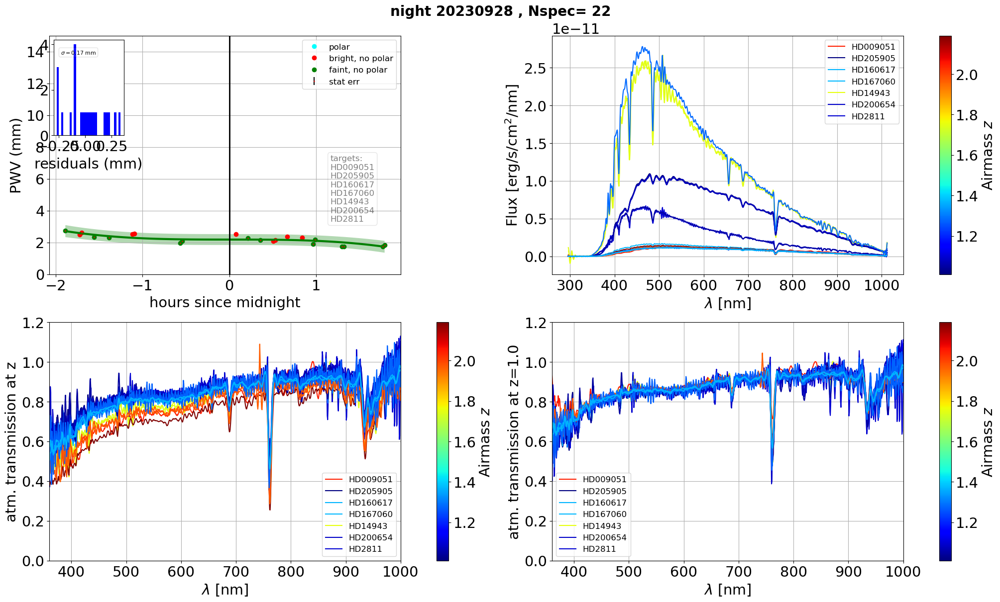

                id                                Time  PWV [mm]_x  \
889  2023092800161 2023-09-29 01:06:36.947508641+00:00    2.742555   
890  2023092800168 2023-09-29 01:16:31.772005710+00:00    2.483869   
891  2023092800169 2023-09-29 01:17:57.289503108+00:00    2.613636   
892  2023092800176 2023-09-29 01:26:24.209004025+00:00    2.340478   
893  2023092800185 2023-09-29 01:36:47.779995930+00:00    2.300931   
894  2023092800200 2023-09-29 01:52:56.940501023+00:00    2.521782   
895  2023092800201 2023-09-29 01:54:21.928494415+00:00    2.562582   
896  2023092800226 2023-09-29 02:25:59.419507708+00:00    1.942814   
897  2023092800227 2023-09-29 02:27:24.887008955+00:00    2.088263   
898  2023092800259 2023-09-29 03:04:43.913995893+00:00    2.514867   
899  2023092800266 2023-09-29 03:12:41.472503603+00:00    2.279041   
900  2023092800274 2023-09-29 03:21:35.001493296+00:00    2.144881   
901  2023092800282 2023-09-29 03:30:29.843990088+00:00    2.082160   
902  2023092800283 2

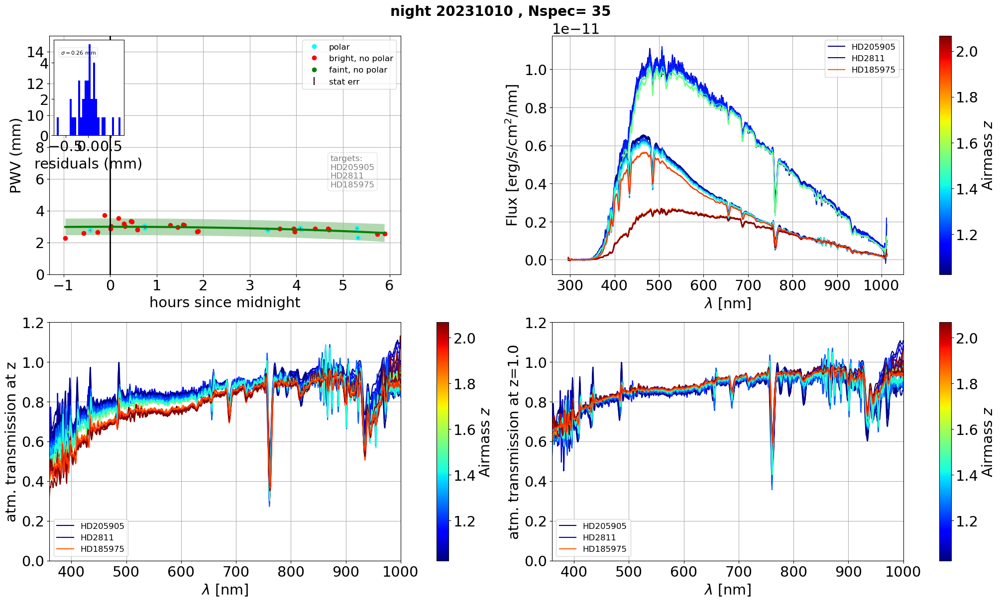

                id                                Time  PWV [mm]_x  \
911  2023101000327 2023-10-11 02:02:25.365492420+00:00    2.275258   
912  2023101000344 2023-10-11 02:25:46.229492465+00:00    2.574895   
913  2023101000351 2023-10-11 02:34:11.494504202+00:00    2.771202   
914  2023101000358 2023-10-11 02:43:44.557007569+00:00    2.631159   
915  2023101000365 2023-10-11 02:52:52.301505378+00:00    3.700189   
916  2023101000370 2023-10-11 03:00:16.641007524+00:00    2.857346   
917  2023101000371 2023-10-11 03:01:29.777504711+00:00    3.014098   
918  2023101000378 2023-10-11 03:10:34.031008349+00:00    3.512806   
919  2023101000383 2023-10-11 03:17:51.598001208+00:00    3.170669   
920  2023101000384 2023-10-11 03:19:04.685005159+00:00    3.026009   
921  2023101000390 2023-10-11 03:26:46.175495997+00:00    3.342133   
922  2023101000391 2023-10-11 03:27:57.141006110+00:00    3.317993   
923  2023101000396 2023-10-11 03:35:12.214490428+00:00    2.797581   
924  2023101000403 2

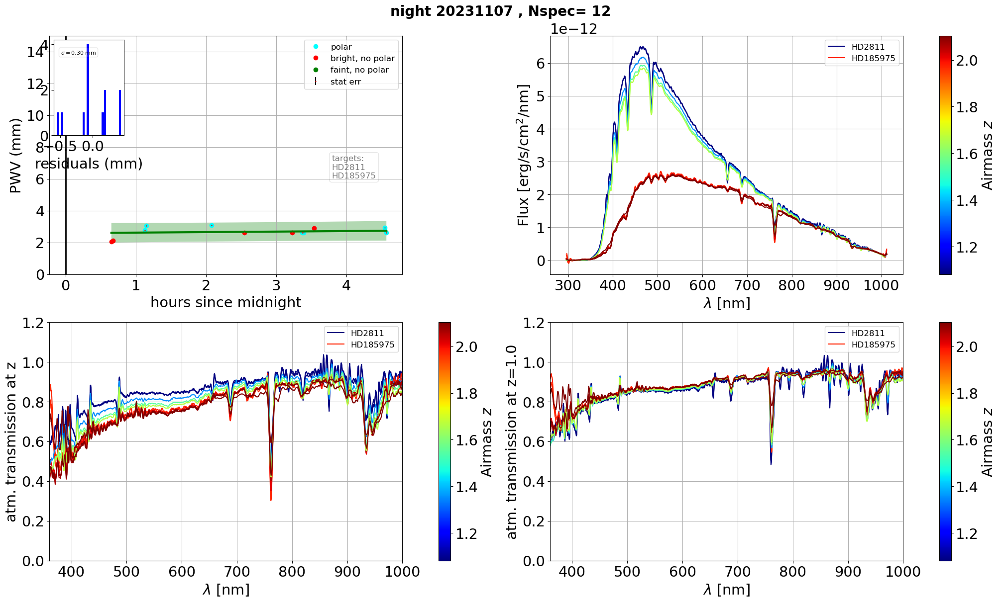

                id                                Time  PWV [mm]_x  \
946  2023110700364 2023-11-08 03:39:13.397002204+00:00    2.051778   
947  2023110700365 2023-11-08 03:40:26.381493171+00:00    2.128481   
948  2023110700384 2023-11-08 04:07:54.241501484+00:00    2.779382   
949  2023110700385 2023-11-08 04:09:07.170990188+00:00    3.064685   
950  2023110700434 2023-11-08 05:04:50.863995924+00:00    3.083062   
951  2023110700453 2023-11-08 05:32:46.478507047+00:00    2.600070   
952  2023110700486 2023-11-08 06:13:38.666508843+00:00    2.614684   
953  2023110700493 2023-11-08 06:22:08.465991272+00:00    2.617957   
954  2023110700494 2023-11-08 06:23:21.629509707+00:00    2.625530   
955  2023110700501 2023-11-08 06:32:16.826998171+00:00    2.900693   
956  2023110700556 2023-11-08 07:32:58.151502606+00:00    2.942388   
957  2023110700557 2023-11-08 07:34:11.343502055+00:00    2.607876   

     PWV [mm]_err_x  PWV [mm]_y  PWV [mm]_err_y  dt_midnight   AIRMASS  \
946        0.01

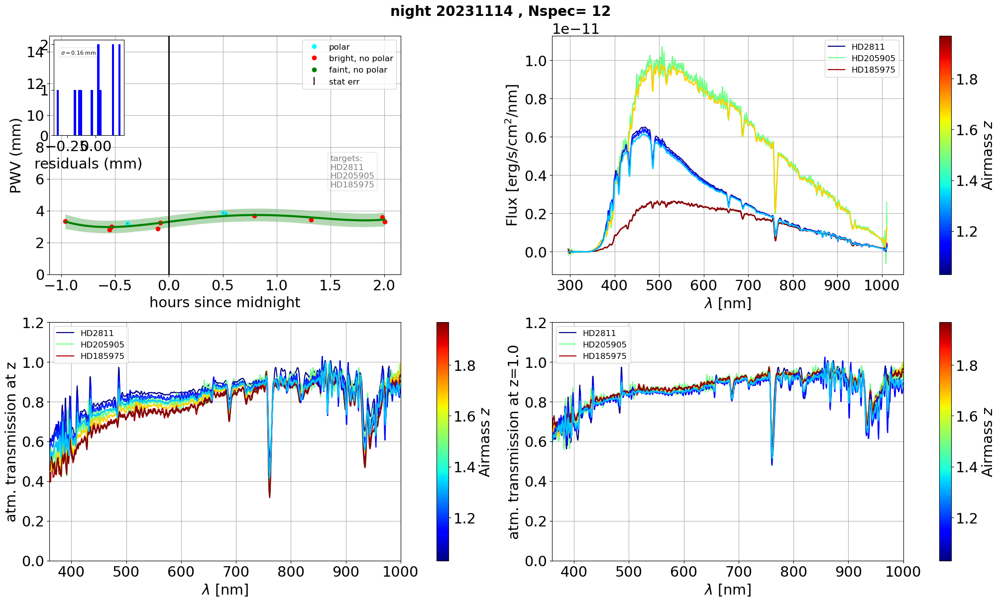

                id                                Time  PWV [mm]_x  \
969  2023111400325 2023-11-15 02:02:21.849999748+00:00    3.346981   
970  2023111400345 2023-11-15 02:26:56.830996334+00:00    2.788744   
971  2023111400346 2023-11-15 02:28:09.797995195+00:00    2.998706   
972  2023111400353 2023-11-15 02:36:51.471991880+00:00    3.222281   
973  2023111400366 2023-11-15 02:53:50.932500058+00:00    2.872617   
974  2023111400367 2023-11-15 02:55:03.880495440+00:00    3.247531   
975  2023111400392 2023-11-15 03:30:13.885506600+00:00    3.869807   
976  2023111400393 2023-11-15 03:31:27.117993175+00:00    3.813010   
977  2023111400406 2023-11-15 03:47:41.706999325+00:00    3.688145   
978  2023111400430 2023-11-15 04:19:04.008491142+00:00    3.427668   
979  2023111400445 2023-11-15 04:58:52.782494921+00:00    3.584280   
980  2023111400446 2023-11-15 05:00:05.794004504+00:00    3.317511   

     PWV [mm]_err_x  PWV [mm]_y  PWV [mm]_err_y  dt_midnight   AIRMASS  \
969        0.02

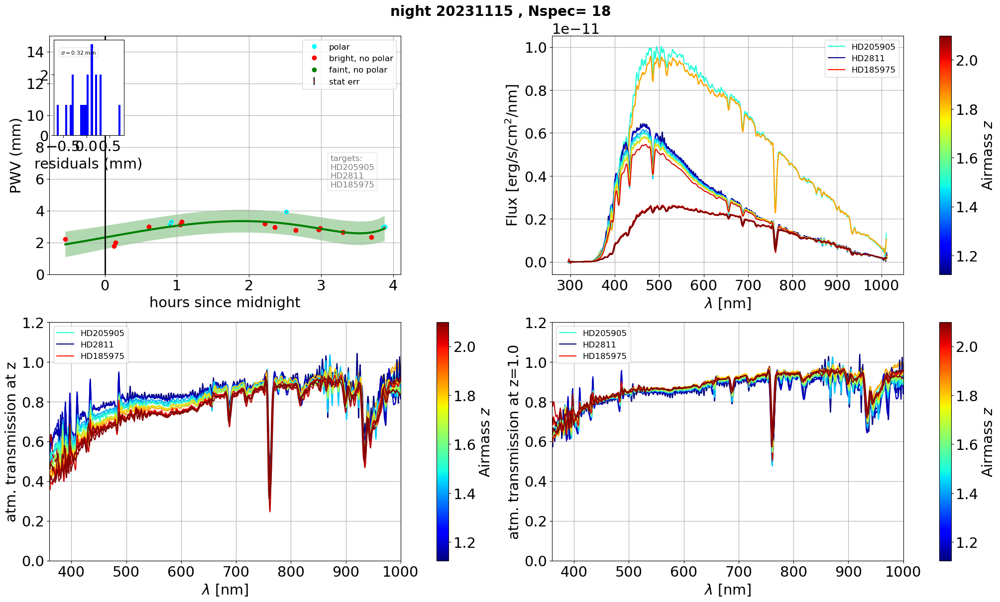

                id                                Time  PWV [mm]_x  \
981  2023111500285 2023-11-16 02:27:06.737499943+00:00    2.196280   
982  2023111500310 2023-11-16 03:07:40.934007973+00:00    1.773046   
983  2023111500311 2023-11-16 03:08:53.956506182+00:00    1.980545   
984  2023111500332 2023-11-16 03:36:33.238510088+00:00    3.002423   
985  2023111500345 2023-11-16 03:53:51.617495119+00:00    3.116949   
986  2023111500346 2023-11-16 03:55:04.648490696+00:00    3.301623   
987  2023111500352 2023-11-16 04:02:48.568990728+00:00    3.108688   
988  2023111500353 2023-11-16 04:04:01.593492134+00:00    3.307976   
989  2023111500399 2023-11-16 05:13:12.815500158+00:00    3.185599   
990  2023111500406 2023-11-16 05:21:28.490995349+00:00    2.968346   
991  2023111500413 2023-11-16 05:31:05.738009790+00:00    3.921593   
992  2023111500419 2023-11-16 05:38:53.741490993+00:00    2.756105   
993  2023111500433 2023-11-16 05:57:54.985992780+00:00    2.802538   
994  2023111500434 2

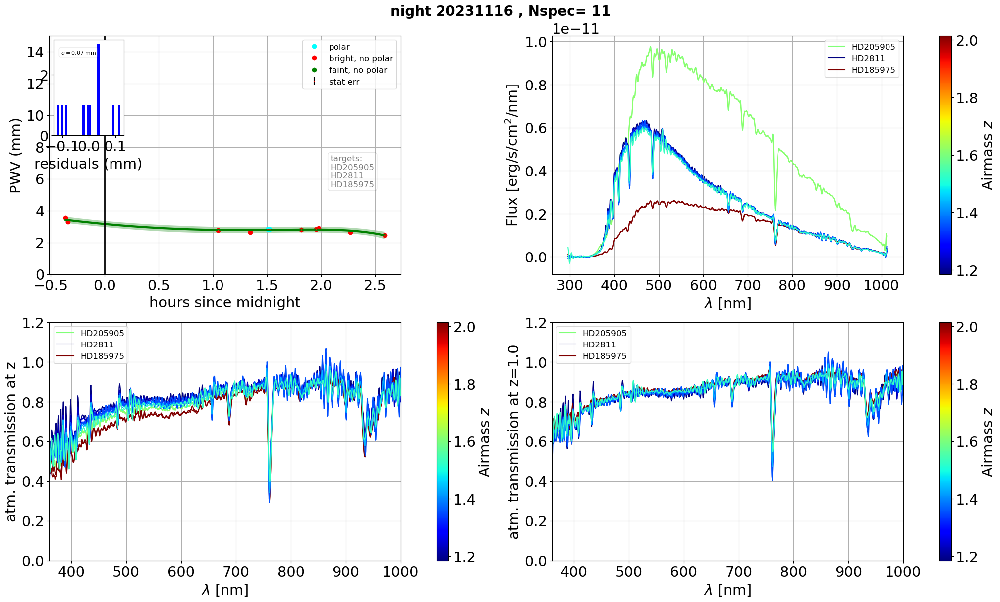

                 id                                Time  PWV [mm]_x  \
999   2023111600436 2023-11-17 02:38:12.794492208+00:00    3.546668   
1000  2023111600437 2023-11-17 02:39:25.756007989+00:00    3.310742   
1001  2023111600493 2023-11-17 04:02:41.239996422+00:00    2.765818   
1002  2023111600506 2023-11-17 04:20:43.522508007+00:00    2.654058   
1003  2023111600513 2023-11-17 04:30:18.761495250+00:00    2.818164   
1004  2023111600514 2023-11-17 04:31:31.960006922+00:00    2.819943   
1005  2023111600527 2023-11-17 04:48:58.734003294+00:00    2.800746   
1006  2023111600534 2023-11-17 04:57:13.467000827+00:00    2.844536   
1007  2023111600535 2023-11-17 04:58:26.513499884+00:00    2.901694   
1008  2023111600548 2023-11-17 05:16:12.887003733+00:00    2.658715   
1009  2023111600562 2023-11-17 05:35:08.034997999+00:00    2.459030   

      PWV [mm]_err_x  PWV [mm]_y  PWV [mm]_err_y  dt_midnight   AIRMASS  \
999         0.010180    2.947383        0.036669    -0.363333  1.605651 

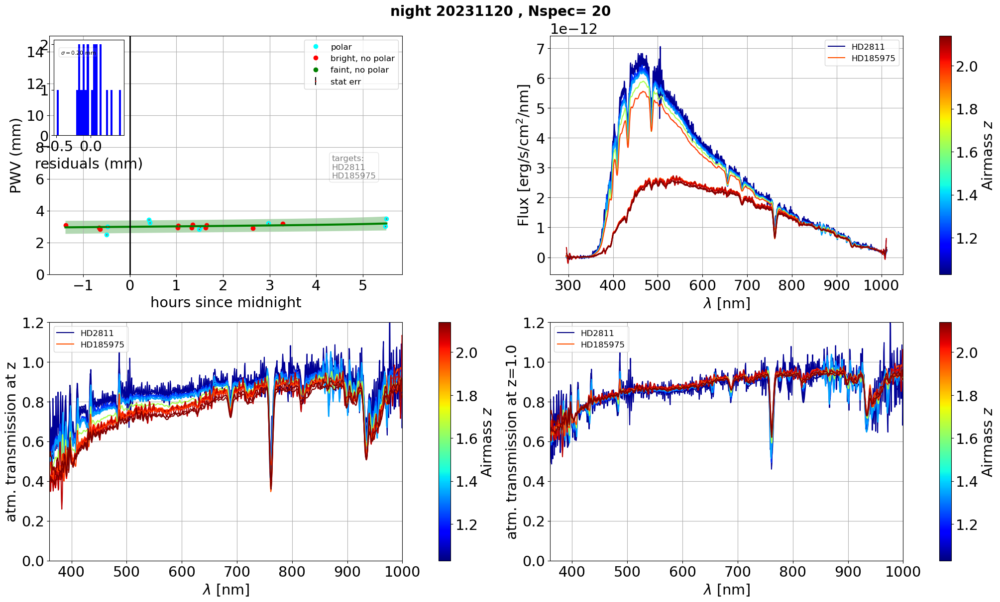

                 id                                Time  PWV [mm]_x  \
1010  2023112000082 2023-11-21 01:37:13.904502514+00:00    3.087690   
1011  2023112000106 2023-11-21 02:20:34.249991651+00:00    2.934370   
1012  2023112000107 2023-11-21 02:21:47.265009693+00:00    2.841859   
1013  2023112000113 2023-11-21 02:29:54.579500502+00:00    2.479312   
1014  2023112000114 2023-11-21 02:31:07.594504539+00:00    2.975177   
1015  2023112000163 2023-11-21 03:24:45.101990715+00:00    3.428634   
1016  2023112000164 2023-11-21 03:25:58.157990338+00:00    3.225505   
1017  2023112000189 2023-11-21 04:01:25.212506067+00:00    2.934296   
1018  2023112000190 2023-11-21 04:02:38.135500599+00:00    3.046698   
1019  2023112000202 2023-11-21 04:19:45.784997631+00:00    2.917179   
1020  2023112000203 2023-11-21 04:20:58.797504016+00:00    3.112015   
1021  2023112000209 2023-11-21 04:29:19.479006047+00:00    2.835038   
1022  2023112000210 2023-11-21 04:30:32.455502559+00:00    2.971601   
1023  

In [ ]:
all_pwv = []
all_sigmapwv = []

# loop on nights
for night in all_selected_nights:
    #select the night
    # Choose the kind of observation
    df_spec_night = df_spec_sel[df_spec_sel["nightObs"] == night]
    df_spec_night_wp = df_spec_wp[df_spec_wp["nightObs"] == night]
    df_spec_night_np = df_spec_np[df_spec_np["nightObs"] == night]
    df_spec_night_np_f = df_spec_np_f[df_spec_np_f["nightObs"] == night]
    df_spec_night_np_b = df_spec_np_b[df_spec_np_b["nightObs"] == night]
    
    #select the variables
    df_night_pwv_curve = df_spec_night[["id","Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET","PSF_REG"]]
    df_night_pwv_curve_wp = df_spec_night_wp[["id","Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET","PSF_REG"]]
    df_night_pwv_curve_np_b = df_spec_night_np_b[["id","Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET","PSF_REG"]]
    df_night_pwv_curve_np_f = df_spec_night_np_f[["id","Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET","PSF_REG"]]
    df_night_pwv_curve_np = df_spec_night_np[["id","Time","PWV [mm]_x","PWV [mm]_err_x","PWV [mm]_y","PWV [mm]_err_y","dt_midnight","AIRMASS","TARGET","PSF_REG"]]

    tmin = df_night_pwv_curve["Time"].min()
    tmax = df_night_pwv_curve["Time"].max()

    list_of_targets = df_night_pwv_curve["TARGET"].unique()
    str_list_of_targets = "\n".join(list_of_targets)
    str_list_of_targets = "\n".join(["targets:",str_list_of_targets])
     

    # convert in hours
    #df_night_pwv_curve["dt"] = (df_night_pwv_curve["Time"] - tmin).dt.total_seconds()/3600.
    #df_night_pwv_curve_wp["dt"] = (df_night_pwv_curve_wp["Time"] - tmin).dt.total_seconds()/3600.
    #df_night_pwv_curve_np["dt"] = (df_night_pwv_curve_np["Time"] - tmin).dt.total_seconds()/3600.
    #df_night_pwv_curve_np_f["dt"] = (df_night_pwv_curve_np_f["Time"] - tmin).dt.total_seconds()/3600.
    #df_night_pwv_curve_np_b["dt"] = (df_night_pwv_curve_np_b["Time"] - tmin).dt.total_seconds()/3600.


    #df_night_pwv_curve["dt"] = (pd.to_datetime(df_night_pwv_curve["Time"]) - tmin).dt.total_seconds()/3600.   
    #df_night_pwv_curve["dt"] = df_night_pwv_curve.apply(lambda row : (pd.to_datetime(row["Time"])-tmin).seconds,axis=1)
    df_night_pwv_curve.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_wp["dt"] = (df_night_pwv_curve_wp["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_wp.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np["dt"] = (df_night_pwv_curve_np["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np_f["dt"] = (df_night_pwv_curve_np_f["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np_f.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)

    #df_night_pwv_curve_np_b["dt"] = (df_night_pwv_curve_np_b["Time"] - tmin).dt.total_seconds()/3600.
    df_night_pwv_curve_np_b.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)
    
    # extract statistics on pwv
    stat = df_night_pwv_curve[["PWV [mm]_x"]].describe()
    date_form = DateFormatter("%y-%m-%dT%H:%M")
    #date_form = DateFormatter("%y-%m-%dT%H")
    count = int(stat.loc["count"].values[0])
    mean = stat.loc["mean"].values[0]
    median = stat.loc["50%"].values[0]
    std = stat.loc["std"].values[0]
    textstr = "\n".join((f"count : {count}",
                     f"mean : {mean:.1f} mm",
                     f"median : {median:.1f} mm",
                     f"std : {std:.1f} mm",
                    ))


    N= len(df_night_pwv_curve)

    if N> NPOINTSMIN:
        # does the fit
        
        #x,y,yerr,n,chi2dof,xfit,yfit,slope,slope_err = MakeLineFit(df_night_pwv_curve)
        xfit, y_ard, y_ard_std, y_brr, y_brr_std, resy, y_mean = MakeLinearModelFit(df_night_pwv_curve)
            
        sigma = np.std(resy)
        all_pwv.append(y_mean)
        all_sigmapwv.append(sigma )

        
        #textstr2 = "\n".join((f"d(PWV/dt) : ",
        #             f"slope : {slope:.3f} mm/h",
        #             f"slope err : {slope_err:.3f} mm/h",
        #             f"chi2/ndeg : {chi2dof:.2f}",       
        #            ))

        #textstr3 = "\n".join((f"d(PWV/dt) : ",
        #             f"slope : {slope:.3f} mm/h",
        #             f"slope err : {slope_err:.3f} mm/h",  
        #            ))
    

        #stat.loc["slope","PWV [mm]_x"] = slope 
        #stat.loc["slope_err","PWV [mm]_x"] = slope_err 
        #stat.loc["chi2","PWV [mm]_x"] = chi2dof

        ##########
        # plot
        ############
        
        fig, axs  = plt.subplots(2,2,figsize=(20,12),layout="constrained")
        ax,ax2,ax3,ax4 = axs.flatten()
        
        leg=ax.get_legend()
        
        ax.errorbar(x=df_night_pwv_curve.dt_midnight, y=df_night_pwv_curve["PWV [mm]_x"],yerr=df_night_pwv_curve["PWV [mm]_err_x"],fmt="+",color="r",ecolor="k",label="stat err",ms=1)
        df_night_pwv_curve_wp.plot(x="dt_midnight",y="PWV [mm]_x",c="cyan",ax=ax,marker='o',lw=0.0,grid=True,legend=leg,label="polar",ms=6,alpha=1)
        df_night_pwv_curve_np_b.plot(x="dt_midnight",y="PWV [mm]_x",c="r",ax=ax,marker='o',lw=0.0,grid=True,legend=leg,label="bright, no polar",ms=6,alpha=1)
        df_night_pwv_curve_np_f.plot(x="dt_midnight",y="PWV [mm]_x",c="g",ax=ax,marker='o',lw=0.0,grid=True,legend=leg,label="faint, no polar",ms=6,alpha=1)
        ax.set_xlabel("hours since midnight")
        ax.set_ylim(0.,15.)
        ax.set_ylabel("PWV (mm)")
        ax.legend(loc="upper right")

        ax.plot(xfit, y_ard,"g-",lw=3,label="ARDRegression")
        ax.fill_between(xfit, y_ard - 1.96 * y_ard_std,y_ard + 1.96 * y_ard_std,alpha=0.3,label=r"95% CL",facecolor='green')

        #ax.plot(xfit2, y_brr,"r-",label="BayesianRidge")
        #ax.fill_between(xfit2, y_brr - 1.96 * y_brr_std,y_brr + 1.96 * y_brr_std,alpha=0.5,label=r"95% CL",facecolor='red')
      
       
        ax.text(0.8, 0.5, str_list_of_targets, transform=ax.transAxes, fontsize=12,verticalalignment='top', bbox=props,alpha=0.5)
        #ax.set_title(f"night {night}")
        ax.axvline(x=0,color="k",lw=2)


        inset_ax = inset_axes(ax,width="20%", # width = 30% of parent_bbox
                                          height="40%", # height : 1 inch
                                          loc="upper left")
        
        textstr_sigma = f"$\sigma = $" +f"{sigma:.2f} mm"
        inset_ax.hist(resy,bins=30,facecolor="b")
        inset_ax.set_xlabel("residuals (mm)")
        inset_ax.text(0.1, 0.9, textstr_sigma , transform=inset_ax.transAxes, fontsize=8,verticalalignment='top', bbox=props,alpha=1)


        #all_figs_to_pdf.append(fig) 
       

        # Fetch the target SED, the spectra and plot
        # visits
        list_visitid = list(df_night_pwv_curve["id"])
        # target
        list_of_all_targets = np.unique(list(df_spec_night["TARGET"]))
        all_calspecs = {}
        for target_name in list_of_all_targets:
            c =  gcal.Calspec(target_name) 
            all_calspecs[target_name] = c.get_spectrum_numpy() 

        # smooth SED calspec
        all_calspecs_sm = {}
        span = 5
        for idx,target_name in enumerate(list_of_all_targets):
            c_dict = all_calspecs[target_name]
            wls = c_dict["WAVELENGTH"].value
            sed = c_dict["FLUX"].value
            sedm = smooth_data_np_convolve(sed,span)
            c_dict_sm = {"WAVELENGTH":wls,"FLUX":sedm}
            all_calspecs_sm[target_name] = c_dict_sm

        # get spectra
        all_foundvisitid, all_headers, all_params_spectrum , all_params_spectrogram, all_spectra = GetListOfSpectra(butler,list_visitid,my_collection)

        # do the plot
        #fig_spectra = plot_spectra(all_spectra, [spec.airmass for spec in all_spectra],collection=" ",dateobs=night,figsize=(12,6))
        plot_spectra_ax(all_spectra, ax2, [spec.airmass for spec in all_spectra],dateobs=night)
        #all_figs_to_pdf.append(fig_spectra) 
        #plt.show()

        #fig_transmission = plot_atmtransmission(all_spectra, [spec.airmass for spec in all_spectra],all_calspecs_sm,Telescope,Disp,collection=" ",dateobs=night,figsize=(12,6))
        plot_atmtransmission_ax(all_spectra,ax3 ,[spec.airmass for spec in all_spectra],all_calspecs_sm,Telescope,Disp,dateobs=night)
        
 
        #fig_transmission_zcorr = plot_atmtransmission_zcorr(all_spectra, [ spec.airmass for spec in all_spectra ],all_calspecs_sm,Telescope,Disp,collection=" " ,dateobs=night,figsize=(12,6) )
        plot_atmtransmission_zcorr_ax(all_spectra,ax4 ,[ spec.airmass for spec in all_spectra ],all_calspecs_sm,Telescope,Disp,dateobs=night )
        #all_figs_to_pdf.append(fig_transmission_zcorr) 
  
        suptitle =  f"night {night} , Nspec= {N}"
        plt.suptitle(suptitle,fontsize=20,fontweight="bold")
         
        figname =f"{pathfigs}/spectra_transmissions_{night}"+figtype
        plt.savefig(figname)
        
        all_figs_to_pdf.append(fig) 
        plt.show()
        print(df_night_pwv_curve) 

## Fetch Spectra and transmission curve

### Select one night

In [ ]:
#night = all_selected_nights[-5]
night = 20240925

### make lists of night

In [ ]:
df_spec_night = df_spec_sel[df_spec_sel["nightObs"] == night]

In [ ]:
tmin = df_spec_night["Time"].min()
tmax = df_spec_night["Time"].max()

list_of_targets = df_spec_night["TARGET"].unique()
str_list_of_targets = "\n".join(list_of_targets)
     
# convert in hours wrt midnight
df_spec_night.assign(dt = lambda row : (row["Time"]-tmin).dt.seconds/3600.,inplace=True)


### Make list of visitid

In [ ]:
list_visitid = list(df_spec_night["id"])

In [ ]:
list_of_all_targets = np.unique(list(df_spec_night["TARGET"]))

### Get Spectra

In [ ]:
all_foundvisitid, all_headers, all_params_spectrum , all_params_spectrogram, all_spectra = GetListOfSpectra(butler,list_visitid,my_collection)

In [ ]:
all_params_spectrum[-5]

In [ ]:
all_params_spectrogram[-5] 

In [ ]:
all_spectra[-5].data

### Get SED

In [ ]:
all_calspecs = {}
for target_name in list_of_all_targets:
    c =  gcal.Calspec(target_name) 
    all_calspecs[target_name] = c.get_spectrum_numpy() 

In [ ]:
all_calspecs_sm = {}
fig = plt.figure(figsize=(10,6))
ax = fig.add_subplot()
span = 5
fmax = np.zeros(len(list_of_all_targets))
for idx,target_name in enumerate(list_of_all_targets):
    c_dict = all_calspecs[target_name]
    wls = c_dict["WAVELENGTH"].value
    sed = c_dict["FLUX"].value
    ax.plot(wls,sed,'b-',label=target_name)

    fmax[idx] = sed[np.where(np.logical_and(wls>WLMIN*10,wls<WLMAX*10))[0]].max()
    
    sedm = smooth_data_np_convolve(sed,span)
    c_dict_sm = {"WAVELENGTH":wls,"FLUX":sedm}
    all_calspecs_sm[target_name] = c_dict_sm
    ax.plot(wls,sedm,'r-',label="smooth " +target_name)
ax.legend()
ax.set_xlim(3000.,10000.)   
ax.set_ylim(0.,fmax.max()*1.1)
ax.set_title(f"SEDs for night {night}")

In [ ]:
count = 0
all_lists_of_targets = []
DATEOBS = night
N = len(all_spectra)
count += N
print(idx,DATEOBS,len(all_spectra),count) 
list_of_targets = np.unique([spec.target.label for spec in all_spectra])
    
if N>1:
    fig = plot_spectra(all_spectra, [spec.airmass for spec in all_spectra],collection=my_collection,dateobs=DATEOBS,figsize=(12,8))
else:
    idx= all_spectra[0].dataId
    print(f" \n /////// SKIPP {idx} \n")

In [ ]:
from libanaspectra import *
fig,ax = plt.subplots(1,1,figsize=(10,6))
plot_spectra_ax(all_spectra, ax, [spec.airmass for spec in all_spectra],dateobs=DATEOBS)

In [ ]:
if N > 1:
    plot_atmtransmission(all_spectra, [spec.airmass for spec in all_spectra],all_calspecs_sm,Telescope,Disp,collection=my_collection,dateobs=DATEOBS,figsize=(12,8))
else:
    id = filtered_spectra[0].dataId
    print(f" \n /////// SKIPP {id} \n")


## Plot atmospheric transmissions for airmass = 1

$$
T(z_{pred}) = \frac{ \left( T(z_{meas}) \right)^\left( \frac{z_{pred}}{z_{meas}}\right)}{(T^{grey}_{z_{meas}})^{z_{pred}}}
$$

In [ ]:
if N > 1:
    plot_atmtransmission_zcorr(all_spectra, [ spec.airmass for spec in all_spectra ],all_calspecs_sm,Telescope,Disp,collection=my_collection,dateobs=DATEOBS,figsize=(14,8) )
else:
    id = filtered_spectra[0].dataId
    print(f" \n /////// SKIPP {id} \n")    

## Save all figs in a pdf file

In [ ]:
from matplotlib.backends.backend_pdf import PdfPages
#pdf_filename = f"holo_PWV_night_fitvariation_andSpectra.pdf"
#pdf_fullfilename = os.path.join(pathfigs,pdf_filename)
#with PdfPages(pdf_fullfilename) as pdf:
#    for fig in all_figs_to_pdf:
#        pdf.savefig(fig, bbox_inches='tight') 

In [ ]:
pdf_filename = f"holo_PWV_night_fitvariation_andSpectra_tight.pdf"
pdf_fullfilename = os.path.join(pathfigs,pdf_filename)
with PdfPages(pdf_fullfilename) as pdf:
    for fig in all_figs_to_pdf:
        pdf.savefig(fig, bbox_inches='tight') 

In [ ]:
pdf_filename = f"holo_PWV_night_fitvariation_andSpectra_nottight.pdf"
pdf_fullfilename = os.path.join(pathfigs,pdf_filename)
with PdfPages(pdf_fullfilename) as pdf:
    for fig in all_figs_to_pdf:
        pdf.savefig(fig) 

In [ ]:
erry

In [ ]:
df_night_pwv_curve